# Imports

In [4]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from mpl_toolkits.axes_grid1 import make_axes_locatable

import geopandas as gpd


mpl.rc_file_defaults()

# mpl.rcParams['figure.dpi'] = 300

%config InlineBackend.figure_format = 'retina'

In [5]:
data_path = "../data/"
os.listdir(data_path)

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'age_pop_household',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'dynamic_world_london_10m.tif',
 'dynamic_world_london_10m_4326.tif',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'gini-2019-lsoa.csv',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'Land_Cover_in_Greater_London.geojson',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_wa

In [6]:
file = "imd2015lsoa.csv"
file_path = os.path.join(data_path, file)
df = pd.read_csv(file_path)

In [7]:
df.Measurement.value_counts()

Measurement
Rank       328440
Decile     328440
Score      328440
Name: count, dtype: int64

In [8]:
df["Indices of Deprivation"].value_counts()

Indices of Deprivation
j. Income Deprivation Affecting Older People Index (IDAOPI)    98532
h. Living Environment Deprivation Domain                       98532
d. Education, Skills and Training Domain                       98532
c. Employment Deprivation Domain                               98532
e. Health Deprivation and Disability Domain                    98532
a. Index of Multiple Deprivation (IMD)                         98532
i. Income Deprivation Affecting Children Index (IDACI)         98532
g. Barriers to Housing and Services Domain                     98532
b. Income Deprivation Domain                                   98532
f. Crime Domain                                                98532
Name: count, dtype: int64

In [9]:
df[
    (df.Measurement == "Decile ")
    & (df["Indices of Deprivation"] == "g. Barriers to Housing and Services Domain")
]

,FeatureCode,DateCode,Measurement,Units,Value,Indices of Deprivation
277122,E01001090,2015,Decile,NaN,2.0,g. Barriers to Housing and Services Domain
277123,E01016409,2015,Decile,NaN,7.0,g. Barriers to Housing and Services Domain
277124,E01001364,2015,Decile,NaN,1.0,g. Barriers to Housing and Services Domain
277125,E01001052,2015,Decile,NaN,1.0,g. Barriers to Housing and Services Domain
277126,E01011730,2015,Decile,NaN,3.0,g. Barriers to Housing and Services Domain
...,...,...,...,...,...,...
365642,E01022374,2015,Decile,NaN,9.0,g. Barriers to Housing and Services Domain
365643,E01021753,2015,Decile,NaN,4.0,g. Barriers to Housing and Services Domain
365644,E01021770,2015,Decile,NaN,5.0,g. Barriers to Housing and Services Domain
365645,E01021758,2015,Decile,NaN,4.0,g. Barriers to Housing and Services Domain


In [10]:
df.Measurement.unique()

array(['Rank', 'Decile ', 'Score'], dtype=object)

# Boundaries

In [11]:
# os.listdir('../data/ESRI/')

In [12]:
file_path = "../data/ESRI/LSOA_2011_London_gen_MHW.shp"
# file_path = '../data/ESRI/London_Ward.shp'
# file_path = '../data/ESRI/MSOA_2011_London_gen_MHW.shp'
# file_path = '../data/IMD19/IMD_2019.shp'
gdf = gpd.read_file(file_path, crs="EPSG:27700")
bdry_key = "LSOA11CD"

c:\Users\Javier Alfaro\Dropbox\Master\LSE\CDRC\venv\Lib\site-packages\pyogrio\raw.py:196: RuntimeWarning: driver ESRI Shapefile does not support open option CRS
  return ogr_read(


In [13]:
gdf

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,0,112.9,876,1.7,"POLYGON ((532105.092 182011.23, 532162.491 181..."
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,0,62.9,830,1.7,"POLYGON ((532746.813 181786.891, 532671.688 18..."
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,96,227.7,817,1.5,"POLYGON ((532135.145 182198.119, 532158.25 182..."
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,0,52.0,467,2.1,"POLYGON ((533807.946 180767.77, 533649.063 180..."
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,4,116.2,543,3.1,"POLYGON ((545122.049 184314.931, 545271.917 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1352,1352,0,107.6,581,2.3,"POLYGON ((544642.68 179824.674, 544766.313 179..."
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2038,2038,0,20.4,663,3.1,"POLYGON ((546579.195 181097.813, 546687.036 18..."
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1845,1728,117,125.8,646,2.7,"POLYGON ((544536.486 179447.115, 544602.63 179..."
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1820,1820,0,32.3,591,3.1,"POLYGON ((546415.745 180152.27, 546320.715 180..."


<Axes: >

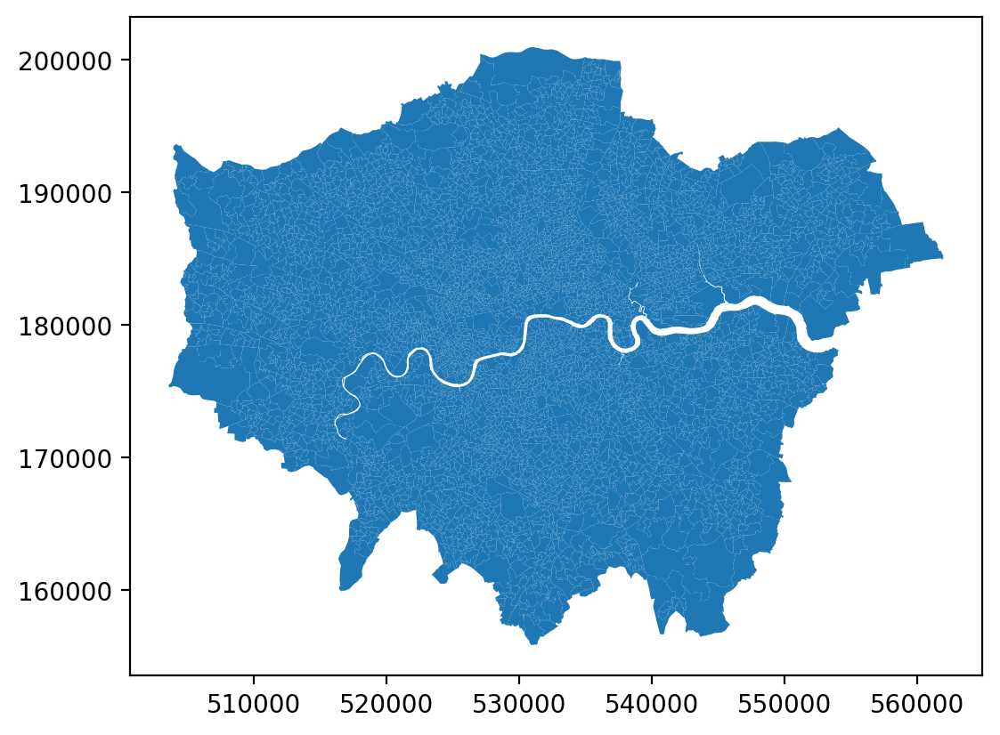

In [14]:
gdf.plot()

c:\Users\Javier Alfaro\Dropbox\Master\LSE\CDRC\venv\Lib\site-packages\pyogrio\raw.py:196: RuntimeWarning: driver ESRI Shapefile does not support open option CRS
  return ogr_read(


<Axes: >

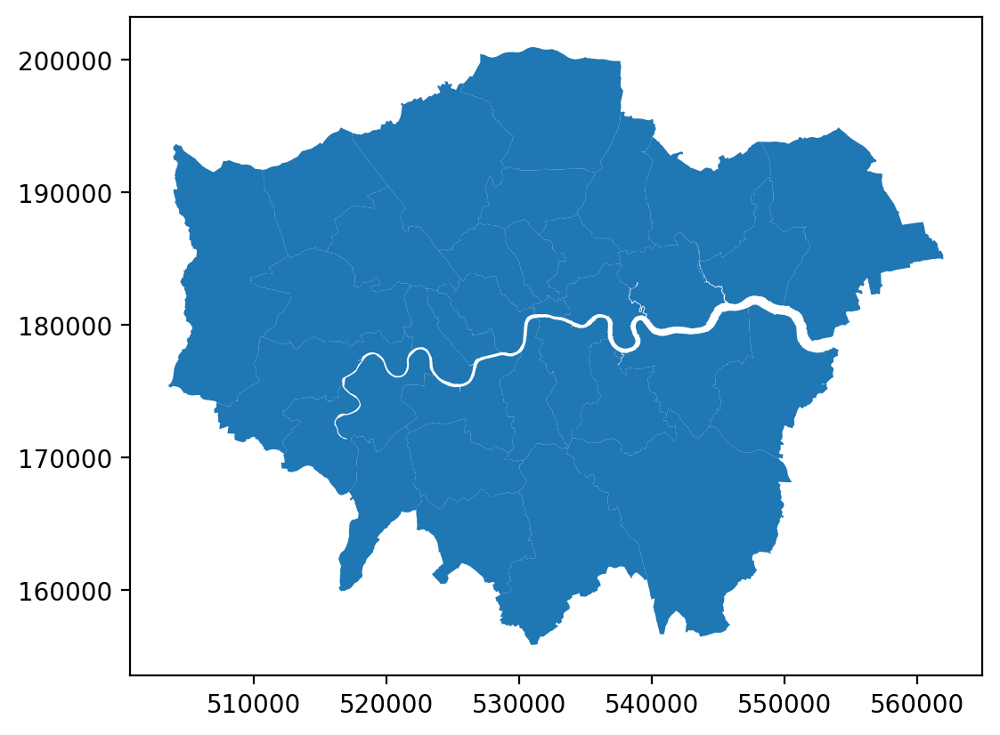

In [15]:
file_path = "../data/ESRI/London_Borough_Excluding_MHW.shp"
boroughs = gpd.read_file(file_path, crs="EPSG:27700")
boroughs.plot()

In [16]:
os.listdir("../data/")

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'age_pop_household',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'dynamic_world_london_10m.tif',
 'dynamic_world_london_10m_4326.tif',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'gini-2019-lsoa.csv',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'Land_Cover_in_Greater_London.geojson',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_wa

In [17]:
# # file_path = "../data/lsoa11_ward15_lookup.csv"
# file_path = "../data/london_lsoa2osward.csv"
# wards = pd.read_csv(file_path)
# wards.columns = map(str.lower, wards.columns)
# wards

In [18]:
# gdf = gdf.merge(wards, how="left", left_on="LSOA11CD", right_on="lsoa11cd")

In [19]:
gdf

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,geometry
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,0,112.9,876,1.7,"POLYGON ((532105.092 182011.23, 532162.491 181..."
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,0,62.9,830,1.7,"POLYGON ((532746.813 181786.891, 532671.688 18..."
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,96,227.7,817,1.5,"POLYGON ((532135.145 182198.119, 532158.25 182..."
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,0,52.0,467,2.1,"POLYGON ((533807.946 180767.77, 533649.063 180..."
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,4,116.2,543,3.1,"POLYGON ((545122.049 184314.931, 545271.917 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1352,1352,0,107.6,581,2.3,"POLYGON ((544642.68 179824.674, 544766.313 179..."
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2038,2038,0,20.4,663,3.1,"POLYGON ((546579.195 181097.813, 546687.036 18..."
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1845,1728,117,125.8,646,2.7,"POLYGON ((544536.486 179447.115, 544602.63 179..."
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1820,1820,0,32.3,591,3.1,"POLYGON ((546415.745 180152.27, 546320.715 180..."


# Age

## 2011

In [20]:
# %pip install xlrd
# %pip install pip install openpyxl

In [21]:
# data_path = "../data/"
# file_name = 'age-2011-lsoa.xls'
# file_path = os.path.join(data_path, file_name)
# age11 = pd.read_excel(file_path, sheet_name='Mid-2011 Persons', skiprows=3)

In [22]:
# age11.to_csv('../data/age-2011-lsoa.csv', index=False)
# age11_test = pd.read_csv('../data/age-2011-lsoa.csv') ### faster

In [23]:
# import xlrd
# xls = xlrd.open_workbook(file_path, on_demand=True)
# print(xls.sheet_names())

In [24]:
data_path = "../data/"
file_name = "age-2011-lsoa.csv"
file_path = os.path.join(data_path, file_name)
age11 = pd.read_csv(file_path)

In [25]:
age11.shape

(35101, 23)

In [26]:
age11.head(3)

,Area Codes,Area Names,Unnamed: 2,All Ages,0-4,5-9,10-14,15-19,20-24,25-29,...,45-49,50-54,55-59,60-64,65-69,70-74,75-79,80-84,85-89,90+
0,E06000047,County Durham UA,NaN,512994,28661,25920,27708,32491,35306,30505,...,39550,35882,32918,35372,28299,22920,18018,12803,7389,3585
1,E01020634,NaN,County Durham 001A,1568,90,78,65,83,65,82,...,119,116,97,106,106,94,52,36,24,22
2,E01020635,NaN,County Durham 001B,1377,73,50,52,81,47,77,...,115,126,98,110,94,60,46,33,18,2


In [27]:
age11["25-34 Total"] = age11["25-29"] + age11["30-34"]
age11["25-34 Percentage"] = (age11["25-34 Total"] / age11["All Ages"]) * 100

<Axes: >

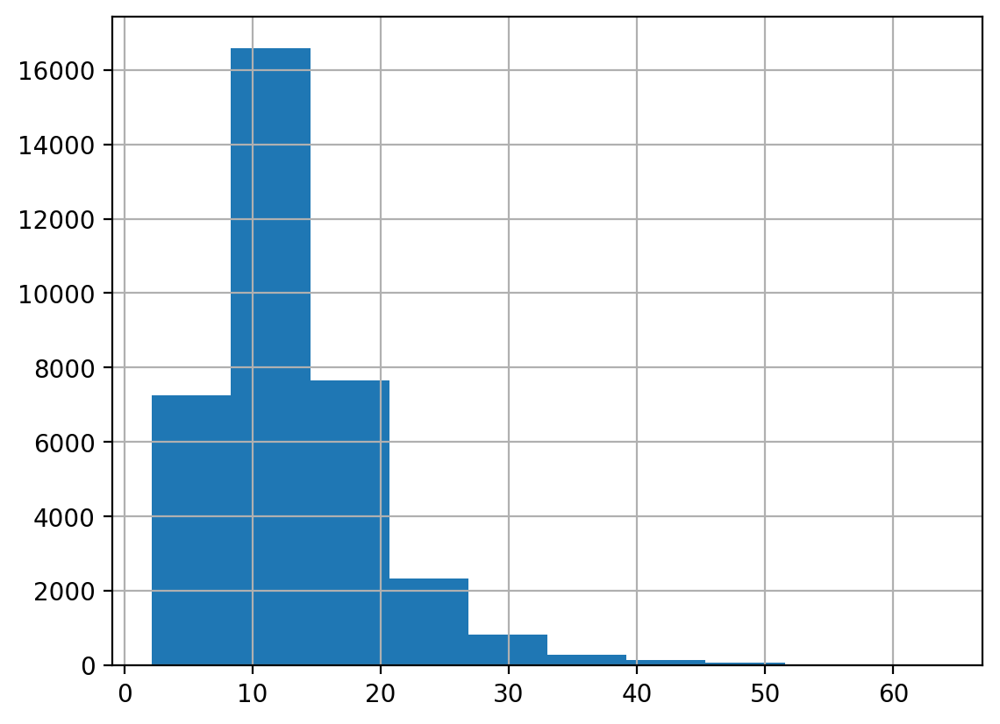

In [28]:
age11["25-34 Percentage"].hist()

<Axes: >

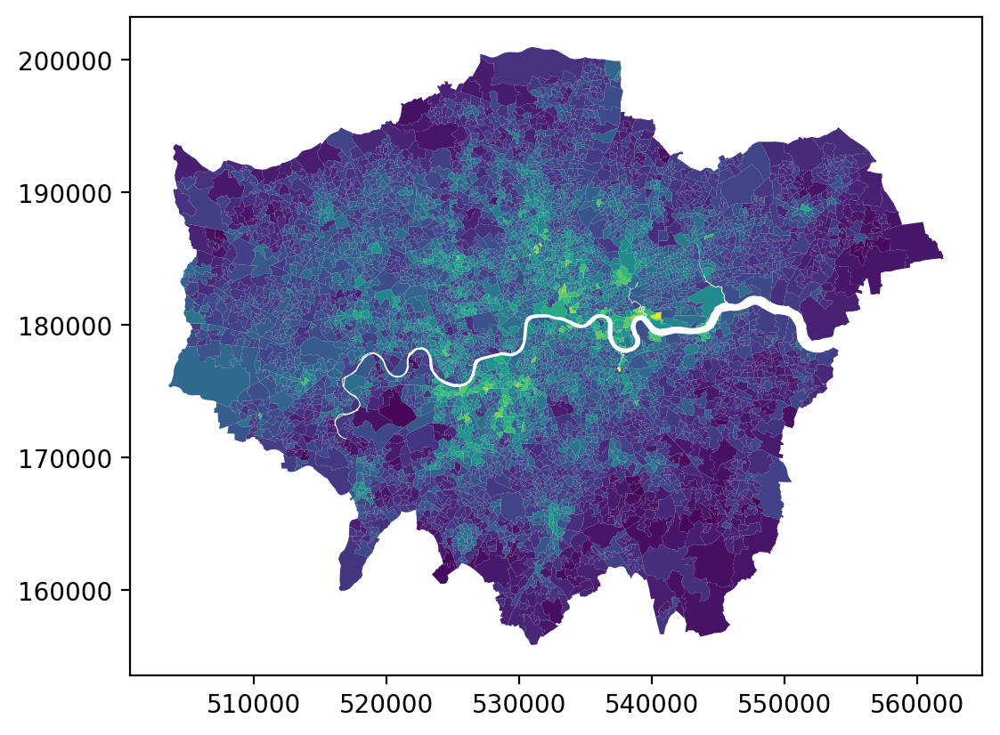

In [29]:
merged = pd.merge(gdf, age11, left_on=bdry_key, right_on="Area Codes")
merged.plot("25-34 Percentage", cmap="viridis")

## 2015

In [30]:
os.listdir("../data/")

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'age_pop_household',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'dynamic_world_london_10m.tif',
 'dynamic_world_london_10m_4326.tif',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'gini-2019-lsoa.csv',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'Land_Cover_in_Greater_London.geojson',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_wa

In [31]:
# data_path = "../data/"
# file_name = 'age-2015-lsoa.xls'
# file_path = os.path.join(data_path, file_name)
# age15 = pd.read_excel(file_path, sheet_name='Mid-2015 Persons', skiprows=4)

In [32]:
# age15.to_csv('../data/age-2015-lsoa.csv', index=False)
age15 = pd.read_csv("../data/age-2015-lsoa.csv")  ### faster

In [33]:
age15

,Area Codes,Area Names,Unnamed: 2,All Ages,0,1,2,3,4,5,...,81,82,83,84,85,86,87,88,89,90+
0,E06000047,County Durham,NaN,519347,5337,5562,5697,5762,6053,5971,...,2908,2679,2434,2317,2018,1798,1486,1287,1166,4069
1,E01020634,NaN,County Durham 001A,1524,19,18,20,17,18,13,...,12,8,11,8,1,7,7,3,4,13
2,E01020635,NaN,County Durham 001B,1315,19,17,19,13,12,12,...,5,8,5,7,5,8,4,1,0,8
3,E01020636,NaN,County Durham 001C,1749,26,22,16,32,27,22,...,12,9,13,11,7,2,6,4,6,8
4,E01020654,NaN,County Durham 001D,1860,17,21,17,18,27,20,...,13,9,16,8,19,13,12,6,7,27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35096,W01001636,NaN,Newport 020A,1988,30,36,29,31,43,31,...,5,8,10,6,9,3,5,1,0,3
35097,W01001657,NaN,Newport 020C,1408,7,11,21,19,15,14,...,3,0,2,2,2,2,4,1,1,4
35098,W01001658,NaN,Newport 020D,1968,20,21,18,26,21,38,...,11,7,3,10,9,3,6,7,3,18
35099,W01001912,NaN,Newport 020E,1379,17,7,17,13,23,21,...,9,7,3,5,4,5,7,5,0,4


In [34]:
age15["25-34 Total"] = age15[list(map(str, list(range(25, 35))))].sum(axis=1)
age15["25-34 Percentage"] = (age15["25-34 Total"] / age15["All Ages"]) * 100

<Axes: >

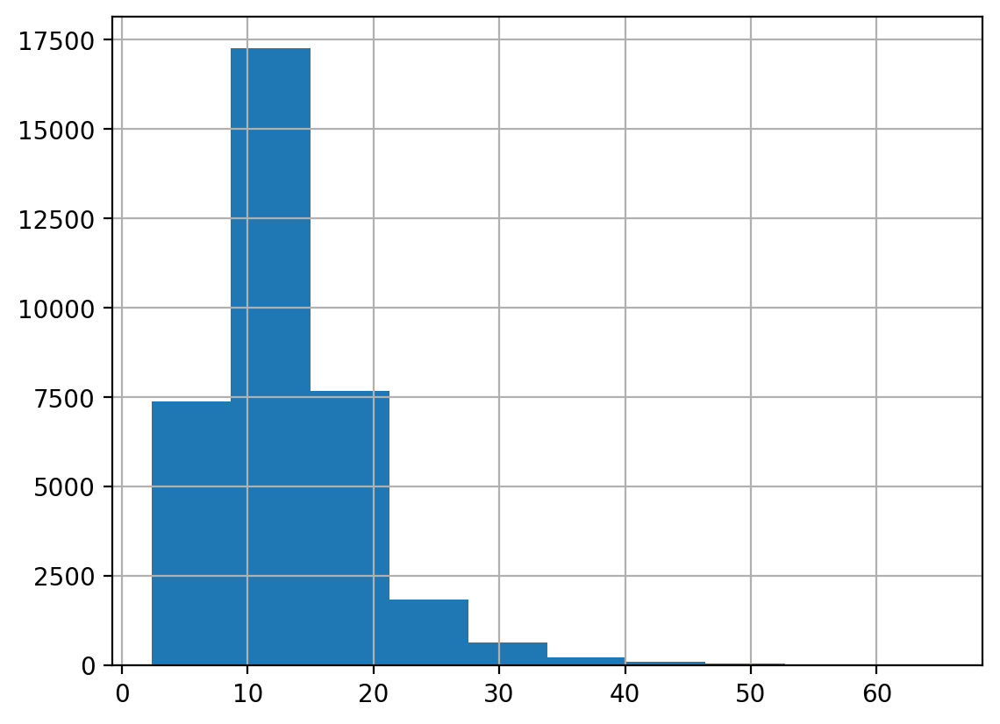

In [35]:
age15["25-34 Percentage"].hist()

In [36]:
all(merged[bdry_key] == merged["Area Codes"])

True

<Axes: >

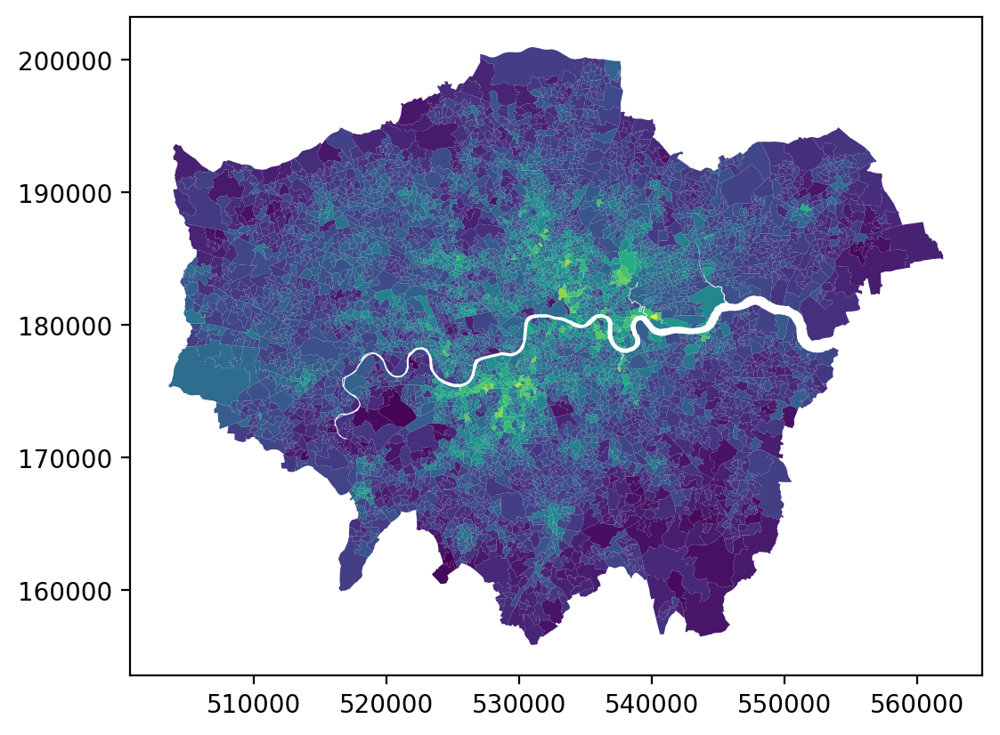

In [37]:
merged = pd.merge(gdf, age15, left_on=bdry_key, right_on="Area Codes")
merged.plot("25-34 Percentage", cmap="viridis")

## 2020

In [38]:
os.listdir("../data/")

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'age_pop_household',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'dynamic_world_london_10m.tif',
 'dynamic_world_london_10m_4326.tif',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'gini-2019-lsoa.csv',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'Land_Cover_in_Greater_London.geojson',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_wa

In [39]:
# data_path = "../data/"
# file_name = 'age-2020-lsoa.xlsx'
# file_path = os.path.join(data_path, file_name)
# age20 = pd.read_excel(file_path, sheet_name='Mid-2020 Persons', skiprows=4)

In [40]:
# age20.to_csv('../data/age-2020-lsoa.csv', index=False)
# age20_test = pd.read_csv('../data/age-2020-lsoa.csv') ### faster

In [43]:
data_path = "../data/"
file_name = "age-2020-lsoa.csv"
file_path = os.path.join(data_path, file_name)
age20 = pd.read_csv(file_path)

In [44]:
age20

,LSOA Code,LSOA Name,LA Code (2018 boundaries),LA name (2018 boundaries),LA Code (2021 boundaries),LA name (2021 boundaries),All Ages,0,1,2,...,81,82,83,84,85,86,87,88,89,90+
0,E01011949,Hartlepool 009A,E06000001,Hartlepool,E06000001,Hartlepool,1944,20,32,22,...,2,9,14,9,8,7,9,2,2,7
1,E01011950,Hartlepool 008A,E06000001,Hartlepool,E06000001,Hartlepool,1298,14,18,15,...,5,3,1,2,2,2,3,2,1,4
2,E01011951,Hartlepool 007A,E06000001,Hartlepool,E06000001,Hartlepool,1208,18,13,12,...,10,7,2,4,4,5,1,1,4,2
3,E01011952,Hartlepool 002A,E06000001,Hartlepool,E06000001,Hartlepool,1724,23,20,32,...,10,13,14,7,17,18,12,10,8,67
4,E01011953,Hartlepool 002B,E06000001,Hartlepool,E06000001,Hartlepool,2026,27,20,32,...,4,6,6,10,1,2,4,1,4,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34748,W01001320,Merthyr Tydfil 007C,W06000024,Merthyr Tydfil,W06000024,Merthyr Tydfil,1430,17,15,11,...,3,3,3,8,11,9,2,6,9,10
34749,W01001321,Merthyr Tydfil 007D,W06000024,Merthyr Tydfil,W06000024,Merthyr Tydfil,1576,21,19,16,...,2,9,3,7,7,3,10,2,3,12
34750,W01001322,Merthyr Tydfil 007E,W06000024,Merthyr Tydfil,W06000024,Merthyr Tydfil,1626,24,23,22,...,10,9,8,4,8,2,6,1,3,15
34751,W01001324,Merthyr Tydfil 003E,W06000024,Merthyr Tydfil,W06000024,Merthyr Tydfil,2106,19,20,32,...,20,16,16,15,15,12,7,6,8,34


In [419]:
age20["25-34 Total"] = age20[list(map(str, list(range(25, 35))))].sum(axis=1)
age20["25-34 Percentage"] = (age20["25-34 Total"] / age20["All Ages"]) * 100

<Axes: >

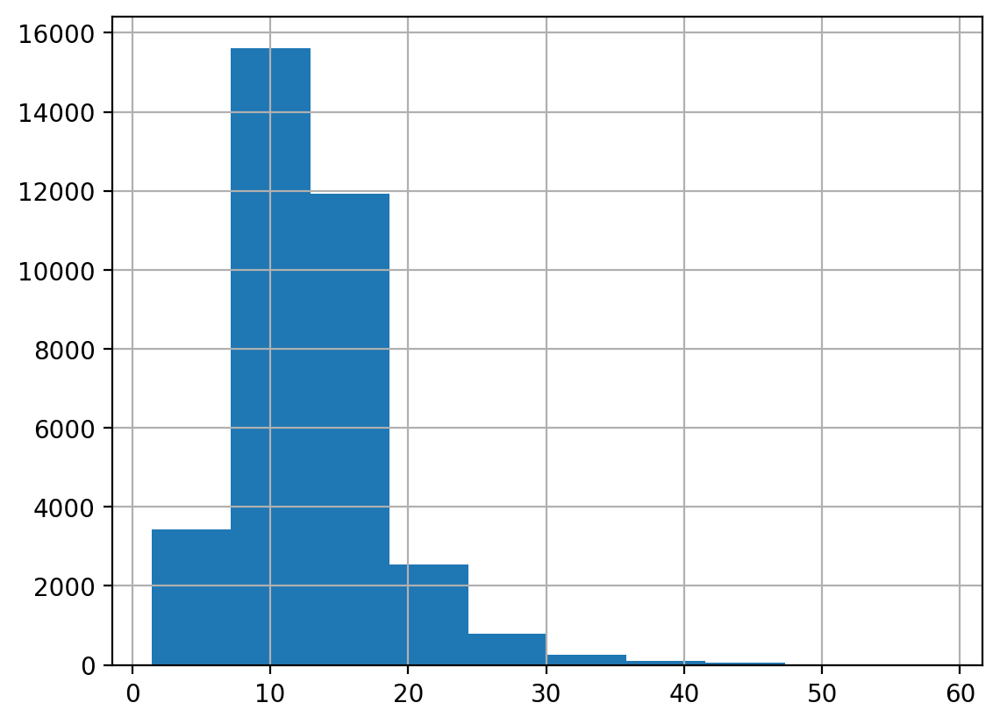

In [420]:
age20["25-34 Percentage"].hist()

<Axes: >

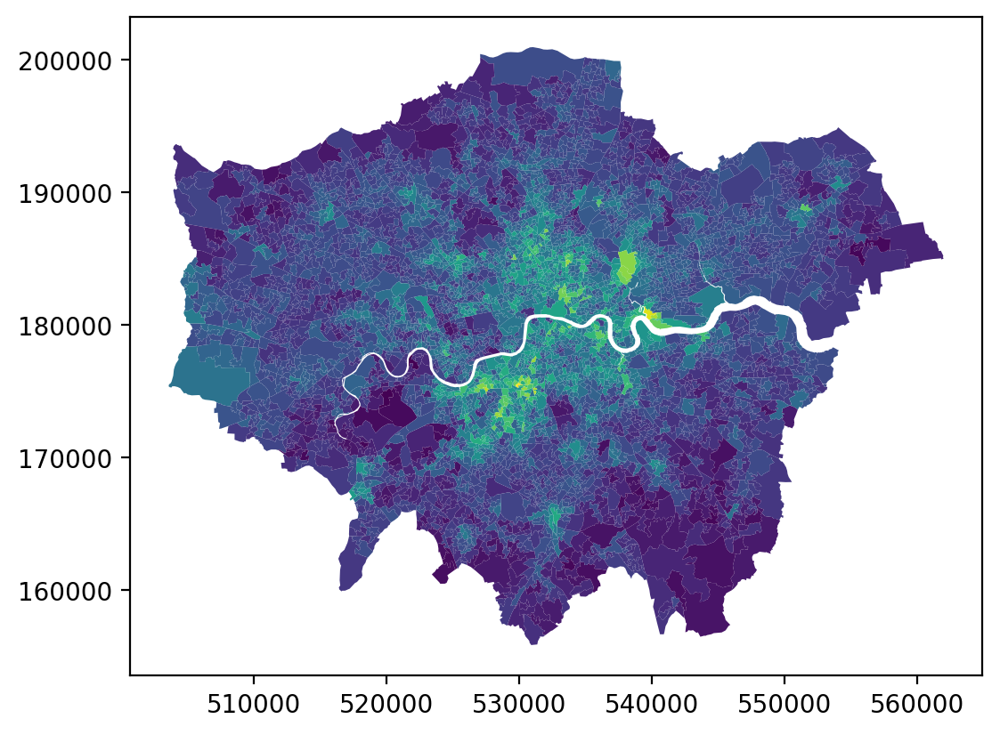

In [421]:
merged = pd.merge(gdf, age20, left_on=bdry_key, right_on="LSOA Code", how="left")
merged.plot("25-34 Percentage", cmap="viridis")

In [422]:
merged

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,83,84,85,86,87,88,89,90+,25-34 Total,25-34 Percentage
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,...,10,6,8,1,6,2,3,45,238,13.607776
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,...,16,3,10,1,5,1,8,29,293,17.461263
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,...,11,4,12,6,8,5,8,23,303,15.947368
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,...,0,8,8,1,8,1,0,9,410,18.798716
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,...,7,1,3,3,3,3,1,10,369,17.430326
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,Greenwich 007F,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1352,1352,...,0,4,9,10,9,8,0,12,398,23.343109
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2038,2038,...,5,1,2,2,0,3,0,6,302,12.961373
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1845,1728,...,1,0,0,0,0,0,0,1,308,17.016575
4833,E01033745,Greenwich 002I,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1820,1820,...,1,0,3,0,3,0,2,2,242,12.179165


## Joining

In [423]:
age_perc11 = age11[["Area Codes", "25-34 Percentage"]]
age_perc11 = age_perc11.rename(
    columns={"Area Codes": "lsoa_codes", "25-34 Percentage": "t1_age"}
)
age_perc11

,lsoa_codes,t1_age
0,E06000047,11.464072
1,E01020634,11.224490
2,E01020635,12.055192
3,E01020636,13.400236
4,E01020654,13.188073
...,...,...
35096,W01001636,10.805085
35097,W01001657,8.929789
35098,W01001658,9.346787
35099,W01001912,13.853396


In [424]:
age_perc15 = age15[["Area Codes", "25-34 Percentage"]]
age_perc15 = age_perc15.rename(
    columns={"Area Codes": "lsoa_codes", "25-34 Percentage": "t2_age"}
)
age_perc15

,lsoa_codes,t2_age
0,E06000047,11.645778
1,E01020634,10.498688
2,E01020635,10.798479
3,E01020636,14.579760
4,E01020654,12.043011
...,...,...
35096,W01001636,10.814889
35097,W01001657,9.659091
35098,W01001658,7.723577
35099,W01001912,10.877447


In [425]:
age_perc20 = age20[["LSOA Code", "25-34 Percentage"]]
age_perc20 = age_perc20.rename(
    columns={"LSOA Code": "lsoa_codes", "25-34 Percentage": "t3_age"}
)  ### change later to t3
age_perc20

,lsoa_codes,t3_age
0,E01011949,13.374486
1,E01011950,16.024653
2,E01011951,14.652318
3,E01011952,12.122970
4,E01011953,13.573544
...,...,...
34748,W01001320,11.468531
34749,W01001321,16.497462
34750,W01001322,17.220172
34751,W01001324,12.298196


In [426]:
all(age_perc20.merge(age_perc11) == pd.merge(age_perc20, age_perc11))

True

In [427]:
# age = age_perc20.merge(age_perc15).merge(age_perc11)
# age = age_perc20.merge(age_perc11, how="left", on="lsoa_codes")
# age = age_perc20.merge(age_perc15, on="lsoa_codes", how="left")
# age = age_perc15.merge(age_perc11, on="lsoa_codes", how="left")
age = age_perc20.merge(age_perc15, how="left").merge(age_perc11, how="left")

# age = age.rename(columns={"t3_age": "t2_age"})  # temporarily

age

,lsoa_codes,t3_age,t2_age,t1_age
0,E01011949,13.374486,13.738178,11.985597
1,E01011950,16.024653,16.562717,15.168154
2,E01011951,14.652318,16.653636,16.429587
3,E01011952,12.122970,11.633238,10.353082
4,E01011953,13.573544,14.370960,13.600422
...,...,...,...,...
34748,W01001320,11.468531,10.040984,12.508101
34749,W01001321,16.497462,16.209150,14.866582
34750,W01001322,17.220172,16.719644,14.303718
34751,W01001324,12.298196,11.538462,10.716049


<Axes: >

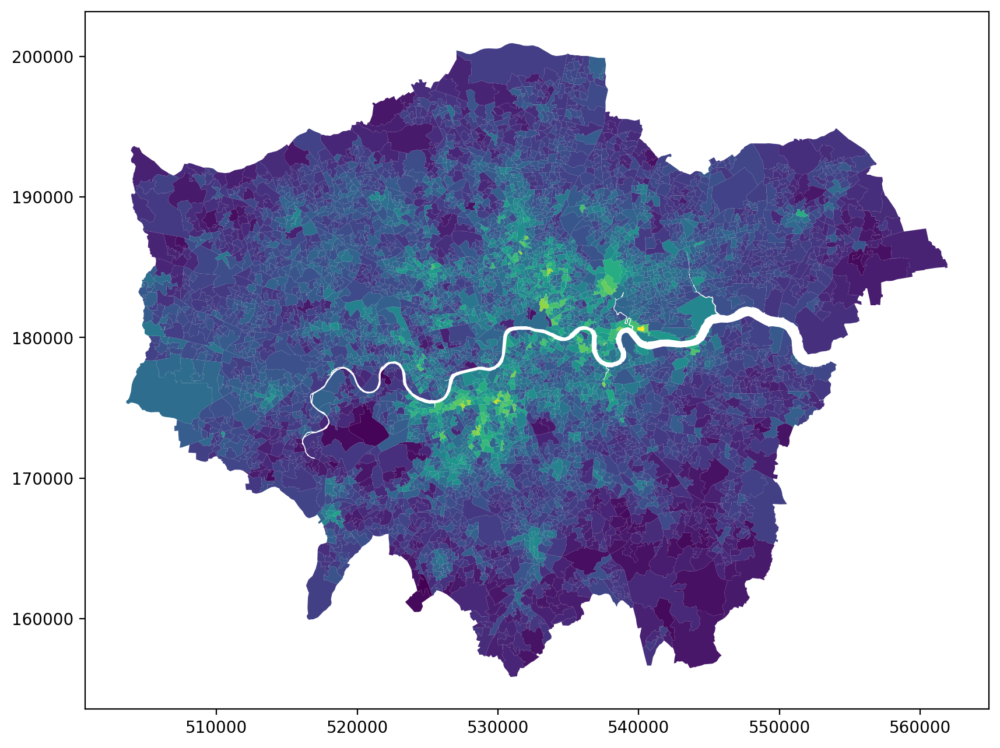

In [428]:
merged = pd.merge(gdf, age, left_on=bdry_key, right_on="lsoa_codes")
merged.plot("t2_age", cmap="viridis", figsize=(10, 10))

# Education

## 2011

In [429]:
os.listdir("../data/")

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_ward20_lookup.csv',
 'lsoa21_ward23_lookup.csv',
 'planning_local_plan_data_25.gpkg',
 'planning_local_plan_data_30.gpkg',
 'planning_local_plan_data_31.gpkg',

In [430]:
data_path = "../data/"
file_name = "education-2011-lsoa.csv"
file_path = os.path.join(data_path, file_name)
educ11 = pd.read_csv(file_path)

In [431]:
new_cols = (
    educ11[educ11.columns[0]]
    .str.split(":", expand=True)
    .rename(columns={0: "lsoa_code", 1: "lsoa_name"})
)
educ11[new_cols.columns.tolist()] = new_cols

In [432]:
educ11["lsoa_code"] = educ11["lsoa_code"].str.rstrip()
educ11["lsoa_name"] = educ11["lsoa_name"].str.lstrip()

In [433]:
educ11.columns

Index(['2011 super output area - lower layer',
       'All categories: Highest level of qualification', 'No qualifications',
       'Level 1 qualifications', 'Level 2 qualifications', 'Apprenticeship',
       'Level 3 qualifications', 'Level 4 qualifications and above',
       'Other qualifications', 'lsoa_code', 'lsoa_name'],
      dtype='object')

In [434]:
educ11.columns[-4], educ11.columns[1]

('Level 4 qualifications and above',
 'All categories: Highest level of qualification')

In [435]:
educ11["l4_perc"] = (
    educ11["Level 4 qualifications and above"]
    / educ11["All categories: Highest level of qualification"]
)

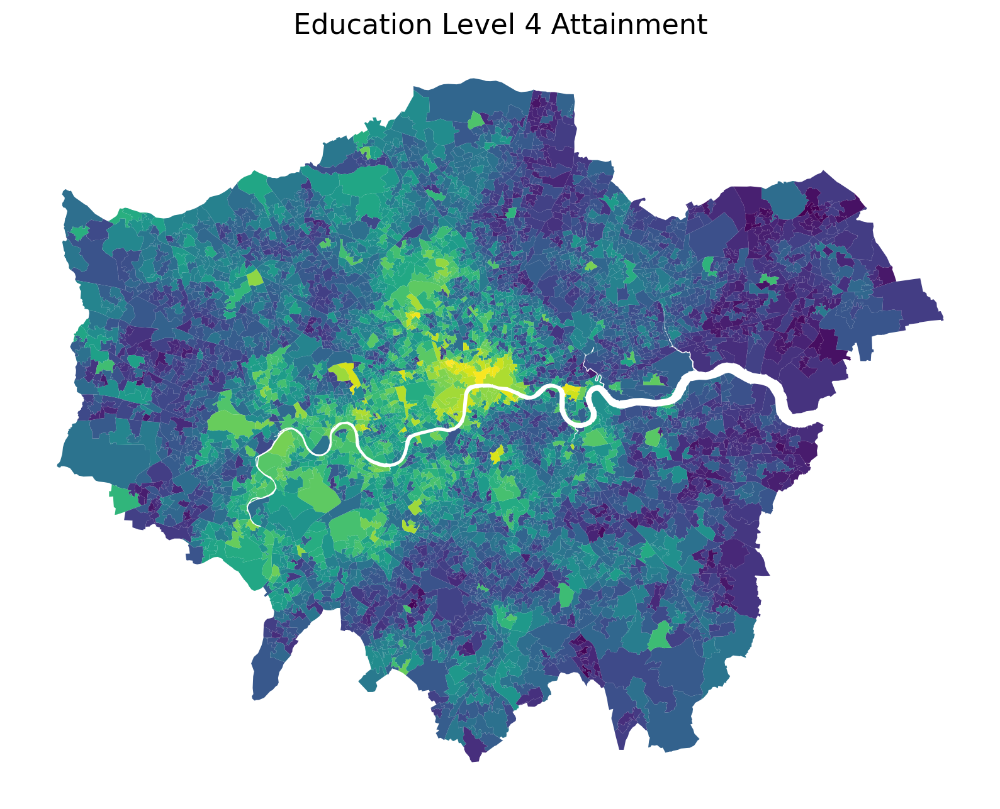

In [436]:
### always when merging data --> specify columns!!!
merged = pd.merge(gdf, educ11, left_on=bdry_key, right_on="lsoa_code")

column_to_plot = "Level 4 qualifications and above"
column_to_plot = "l4_perc"

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged.plot(column_to_plot, cmap="viridis", ax=ax)

ax.set_title(
    "Education Level 4 Attainment", fontdict={"fontsize": "16", "fontweight": "3"}
)
ax.axis("off")

plt.show()

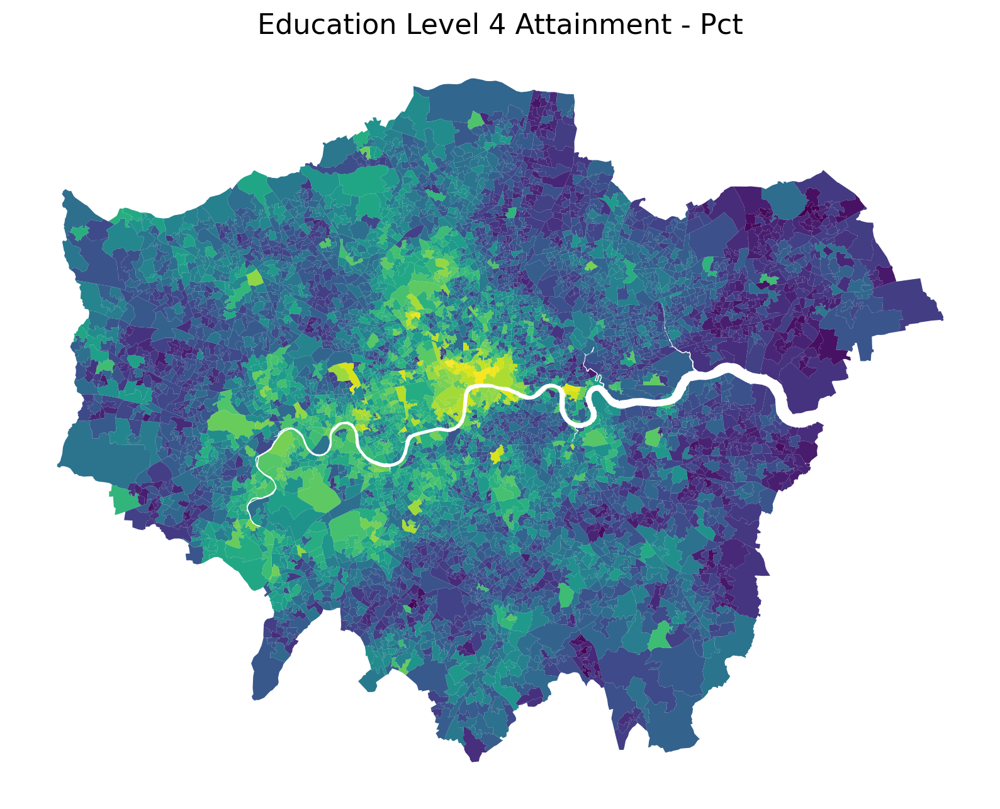

In [437]:
merged = pd.merge(gdf, educ11, left_on=bdry_key, right_on="lsoa_code")
column_to_plot = "l4_perc"

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged.plot(column_to_plot, cmap="viridis", ax=ax)

ax.set_title(
    "Education Level 4 Attainment - Pct", fontdict={"fontsize": "16", "fontweight": "3"}
)
ax.axis("off")

plt.show()

In [438]:
len(gdf[bdry_key].unique())

4835

In [439]:
len(gdf[bdry_key][0]), len(educ11["lsoa_code"][0])

(9, 9)

## 2015

In [440]:
# os.listdir(data_path)

In [441]:
data_path = "../data/"
file_name = "imd2015lsoa.csv"
file_path = os.path.join(data_path, file_name)
imd15 = pd.read_csv(file_path)

In [442]:
imd15

,FeatureCode,DateCode,Measurement,Units,Value,Indices of Deprivation
0,E01019971,2015,Rank,NaN,16495.000,j. Income Deprivation Affecting Older People I...
1,E01008512,2015,Decile,NaN,8.000,h. Living Environment Deprivation Domain
2,E01019963,2015,Rank,NaN,21937.000,j. Income Deprivation Affecting Older People I...
3,E01019980,2015,Rank,NaN,8110.000,j. Income Deprivation Affecting Older People I...
4,E01016350,2015,Decile,NaN,10.000,h. Living Environment Deprivation Domain
...,...,...,...,...,...,...
985315,E01025529,2015,Score,NaN,0.190,c. Employment Deprivation Domain
985316,E01025676,2015,Score,NaN,0.044,c. Employment Deprivation Domain
985317,E01021103,2015,Rank,NaN,10211.000,b. Income Deprivation Domain
985318,E01021082,2015,Rank,NaN,26009.000,b. Income Deprivation Domain


In [443]:
imd15["Indices of Deprivation"].value_counts()

Indices of Deprivation
j. Income Deprivation Affecting Older People Index (IDAOPI)    98532
h. Living Environment Deprivation Domain                       98532
d. Education, Skills and Training Domain                       98532
c. Employment Deprivation Domain                               98532
e. Health Deprivation and Disability Domain                    98532
a. Index of Multiple Deprivation (IMD)                         98532
i. Income Deprivation Affecting Children Index (IDACI)         98532
g. Barriers to Housing and Services Domain                     98532
b. Income Deprivation Domain                                   98532
f. Crime Domain                                                98532
Name: count, dtype: int64

In [444]:
imd15_subset = imd15[imd15.Measurement == "Rank"]
imd_pivot15 = imd15_subset.pivot_table(
    values="Value",
    index="FeatureCode",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "d. Education, Skills and Training Domain"
imd15_edu = imd_pivot15[["FeatureCode", target_col]]
imd15_edu = imd15_edu.rename(
    columns={"FeatureCode": "lsoa_codes", target_col: "t2_edu"}
)
imd15_edu

Indices of Deprivation,lsoa_codes,t2_edu
0,E01000001,32840.0
1,E01000002,32836.0
2,E01000003,22251.0
3,E01000005,17420.0
4,E01000006,17806.0
...,...,...
32839,E01033764,1260.0
32840,E01033765,1948.0
32841,E01033766,21114.0
32842,E01033767,2986.0


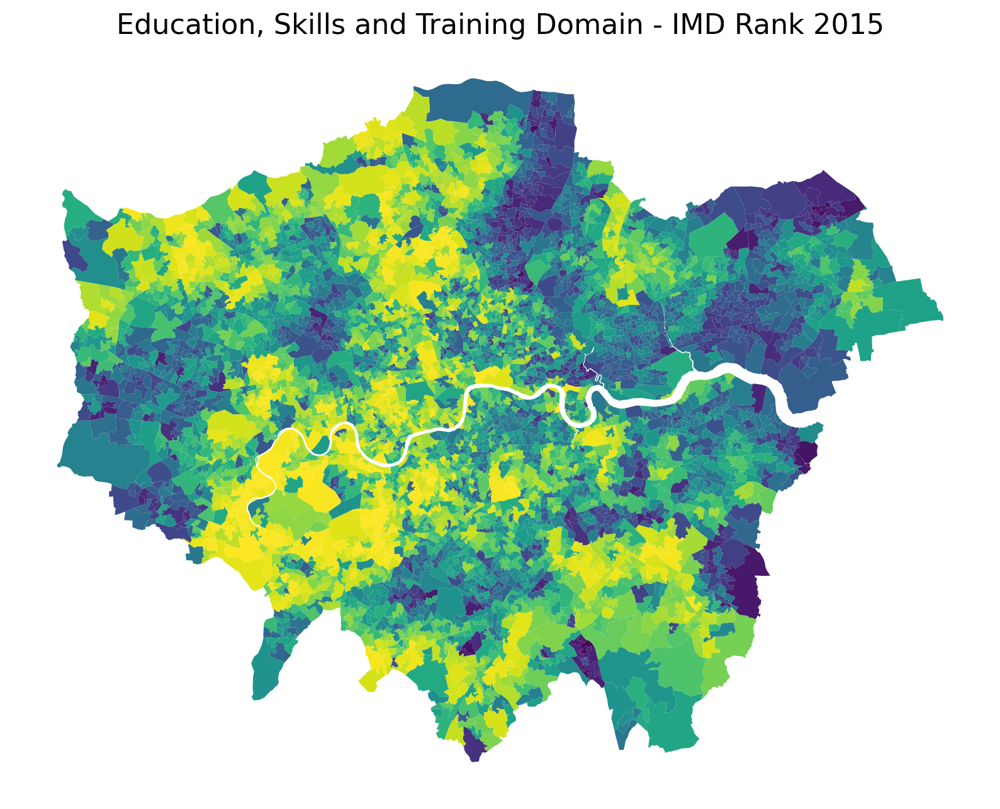

In [445]:
column_to_plot = "t2_edu"
merged = pd.merge(gdf, imd15_edu, left_on=bdry_key, right_on="lsoa_codes")

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged.plot(column_to_plot, cmap="viridis", ax=ax)

title = "Education, Skills and Training Domain - IMD Rank 2015"
ax.set_title(
    title,
    fontdict={"fontsize": "16", "fontweight": "3"},
)
ax.axis("off")

plt.show()

## 2021

In [446]:
data_path = "../data/"
file_name = "education-2021-lsoa.csv"
# file_name = "education-sex-2021-lsoa.csv"
file_path = os.path.join(data_path, file_name)
educ21 = pd.read_csv(file_path)

In [447]:
educ21

,Lower layer Super Output Areas Code,Lower layer Super Output Areas,Highest level of qualification (8 categories) Code,Highest level of qualification (8 categories),Observation
0,E01000001,City of London 001A,-8,Does not apply,125
1,E01000001,City of London 001A,0,No qualifications,32
2,E01000001,City of London 001A,1,Level 1 and entry level qualifications: 1 to 4...,27
3,E01000001,City of London 001A,2,Level 2 qualifications: 5 or more GCSEs (A* to...,53
4,E01000001,City of London 001A,3,Apprenticeship,12
...,...,...,...,...,...
285371,W01002040,Vale of Glamorgan 015F,2,Level 2 qualifications: 5 or more GCSEs (A* to...,228
285372,W01002040,Vale of Glamorgan 015F,3,Apprenticeship,41
285373,W01002040,Vale of Glamorgan 015F,4,Level 3 qualifications: 2 or more A levels or ...,366
285374,W01002040,Vale of Glamorgan 015F,5,"Level 4 qualifications or above: degree (BA, B...",678


In [448]:
educ21 = educ21.rename(
    columns={
        "Lower layer Super Output Areas Code": "lsoa_code",
        "Highest level of qualification (8 categories)": "level_cat",
        "Observation": "value",
    }
)

In [449]:
# educ21["Highest level of qualification (8 categories)"].value_counts()
educ21["level_cat"].value_counts()

level_cat
Does not apply                                                                                                                                                                                                                                                                                                                          35672
No qualifications                                                                                                                                                                                                                                                                                                                       35672
Level 1 and entry level qualifications: 1 to 4 GCSEs grade A* to C, Any GCSEs at other grades, O levels or CSEs (any grades), 1 AS level, NVQ level 1, Foundation GNVQ, Basic or Essential Skills                                                                                                                                 

In [450]:
educ21_pivot = educ21.pivot_table(
    values="value",
    index="lsoa_code",
    columns="level_cat",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

In [451]:
educ21_pivot.describe()

level_cat,Apprenticeship,Does not apply,"Level 1 and entry level qualifications: 1 to 4 GCSEs grade A* to C, Any GCSEs at other grades, O levels or CSEs (any grades), 1 AS level, NVQ level 1, Foundation GNVQ, Basic or Essential Skills","Level 2 qualifications: 5 or more GCSEs (A* to C or 9 to 4), O levels (passes), CSEs (grade 1), School Certification, 1 A level, 2 to 3 AS levels, VCEs, Intermediate or Higher Diploma, Welsh Baccalaureate Intermediate Diploma, NVQ level 2, Intermediate GNVQ, City and Guilds Craft, BTEC First or General Diploma, RSA Diploma","Level 3 qualifications: 2 or more A levels or VCEs, 4 or more AS levels, Higher School Certificate, Progression or Advanced Diploma, Welsh Baccalaureate Advance Diploma, NVQ level 3; Advanced GNVQ, City and Guilds Advanced Craft, ONC, OND, BTEC National, RSA Advanced Diploma","Level 4 qualifications or above: degree (BA, BSc), higher degree (MA, PhD, PGCE), NVQ level 4 to 5, HNC, HND, RSA Higher Diploma, BTEC Higher level, professional qualifications (for example, teaching, nursing, accountancy)",No qualifications,"Other: vocational or work-related qualifications, other qualifications achieved in England or Wales, qualifications achieved outside England or Wales (equivalent not stated or unknown)"
count,35672.000000,35672.000000,35672.000000,35672.000000,35672.000000,35672.000000,35672.000000,35672.000000
mean,72.610198,309.240244,131.169573,182.035406,230.595481,460.110787,247.466584,37.484217
std,27.768290,113.940153,42.186361,49.962735,132.627947,207.732849,103.382883,15.492727
min,1.000000,10.000000,2.000000,11.000000,56.000000,100.000000,12.000000,1.000000
25%,54.000000,231.000000,104.000000,152.000000,181.000000,305.000000,172.000000,27.000000
50%,71.000000,292.000000,131.000000,180.000000,212.000000,420.000000,237.000000,35.000000
75%,90.000000,368.000000,157.000000,208.000000,250.000000,573.000000,311.000000,44.000000
max,366.000000,1676.000000,564.000000,796.000000,5988.000000,3477.000000,1008.000000,325.000000


In [452]:
educ21_pivot.columns[-3]

'Level 4 qualifications or above: degree (BA, BSc), higher degree (MA, PhD, PGCE), NVQ level 4 to 5, HNC, HND, RSA Higher Diploma, BTEC Higher level, professional qualifications (for example, teaching, nursing, accountancy)'

In [453]:
educ21_pivot.select_dtypes(include="number").columns.tolist()

['Apprenticeship',
 'Does not apply',
 'Level 1 and entry level qualifications: 1 to 4 GCSEs grade A* to C, Any GCSEs at other grades, O levels or CSEs (any grades), 1 AS level, NVQ level 1, Foundation GNVQ, Basic or Essential Skills',
 'Level 2 qualifications: 5 or more GCSEs (A* to C or 9 to 4), O levels (passes), CSEs (grade 1), School Certification, 1 A level, 2 to 3 AS levels, VCEs, Intermediate or Higher Diploma, Welsh Baccalaureate Intermediate Diploma, NVQ level 2, Intermediate GNVQ, City and Guilds Craft, BTEC First or General Diploma, RSA Diploma',
 'Level 3 qualifications: 2 or more A levels or VCEs, 4 or more AS levels, Higher School Certificate, Progression or Advanced Diploma, Welsh Baccalaureate Advance Diploma, NVQ level 3; Advanced GNVQ, City and Guilds Advanced Craft, ONC, OND, BTEC National, RSA Advanced Diploma',
 'Level 4 qualifications or above: degree (BA, BSc), higher degree (MA, PhD, PGCE), NVQ level 4 to 5, HNC, HND, RSA Higher Diploma, BTEC Higher level, prof

In [454]:
target_col = "Level 4 qualifications or above: degree (BA, BSc), higher degree (MA, PhD, PGCE), NVQ level 4 to 5, HNC, HND, RSA Higher Diploma, BTEC Higher level, professional qualifications (for example, teaching, nursing, accountancy)"
numeric_cols = educ21_pivot.select_dtypes(include="number").columns.tolist()
# assert len(numeric_cols) == 8

educ21_pivot["total"] = 0
educ21_pivot["l4_perc"] = 0

educ21_pivot["total"] = educ21_pivot[numeric_cols].sum(axis=1)
educ21_pivot["l4_perc"] = educ21_pivot[target_col] / educ21_pivot["total"]

In [455]:
educ21_pivot

level_cat,lsoa_code,Apprenticeship,Does not apply,"Level 1 and entry level qualifications: 1 to 4 GCSEs grade A* to C, Any GCSEs at other grades, O levels or CSEs (any grades), 1 AS level, NVQ level 1, Foundation GNVQ, Basic or Essential Skills","Level 2 qualifications: 5 or more GCSEs (A* to C or 9 to 4), O levels (passes), CSEs (grade 1), School Certification, 1 A level, 2 to 3 AS levels, VCEs, Intermediate or Higher Diploma, Welsh Baccalaureate Intermediate Diploma, NVQ level 2, Intermediate GNVQ, City and Guilds Craft, BTEC First or General Diploma, RSA Diploma","Level 3 qualifications: 2 or more A levels or VCEs, 4 or more AS levels, Higher School Certificate, Progression or Advanced Diploma, Welsh Baccalaureate Advance Diploma, NVQ level 3; Advanced GNVQ, City and Guilds Advanced Craft, ONC, OND, BTEC National, RSA Advanced Diploma","Level 4 qualifications or above: degree (BA, BSc), higher degree (MA, PhD, PGCE), NVQ level 4 to 5, HNC, HND, RSA Higher Diploma, BTEC Higher level, professional qualifications (for example, teaching, nursing, accountancy)",No qualifications,"Other: vocational or work-related qualifications, other qualifications achieved in England or Wales, qualifications achieved outside England or Wales (equivalent not stated or unknown)",total,l4_perc
0,E01000001,12.0,125.0,27.0,53.0,86.0,1127.0,32.0,16.0,1478.0,0.762517
1,E01000002,4.0,86.0,28.0,52.0,87.0,1086.0,23.0,18.0,1384.0,0.784682
2,E01000003,12.0,110.0,61.0,90.0,120.0,1055.0,132.0,35.0,1615.0,0.653251
3,E01000005,32.0,139.0,64.0,120.0,131.0,387.0,197.0,30.0,1100.0,0.351818
4,E01000006,39.0,414.0,158.0,170.0,204.0,501.0,295.0,66.0,1847.0,0.271251
...,...,...,...,...,...,...,...,...,...,...,...
35667,W01002036,48.0,278.0,88.0,144.0,175.0,666.0,122.0,35.0,1556.0,0.428021
35668,W01002037,32.0,152.0,56.0,91.0,129.0,508.0,85.0,11.0,1064.0,0.477444
35669,W01002038,74.0,177.0,122.0,171.0,200.0,255.0,226.0,39.0,1264.0,0.201741
35670,W01002039,48.0,456.0,96.0,219.0,303.0,485.0,124.0,27.0,1758.0,0.275882


In [456]:
all(gdf[bdry_key].apply(len) == 9)

True

In [457]:
all(educ21_pivot["lsoa_code"].apply(len) == 9)

True

In [458]:
# merged[['LSOA11CD', 'LAD11CD', 'RGN11CD', 'lsoa_code']]

In [459]:
len(set(gdf[bdry_key].tolist()) - set(educ21_pivot.lsoa_code.tolist()))

176

<Axes: >

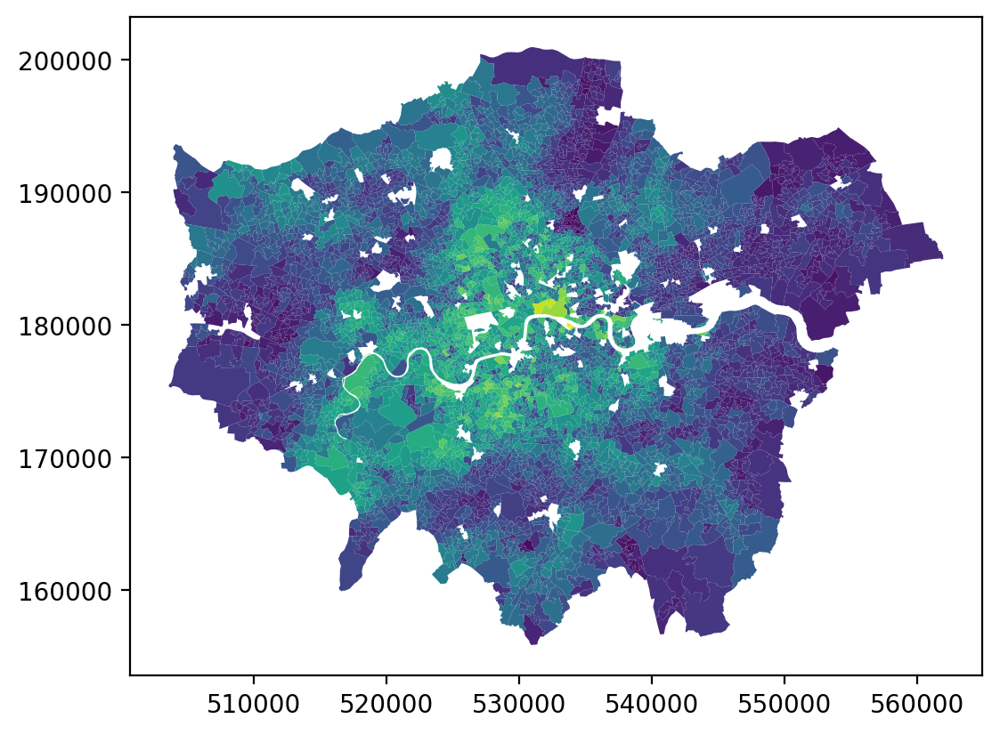

In [460]:
pd.merge(gdf, educ21_pivot, left_on=bdry_key, right_on="lsoa_code", how="left").plot(
    "l4_perc"
)

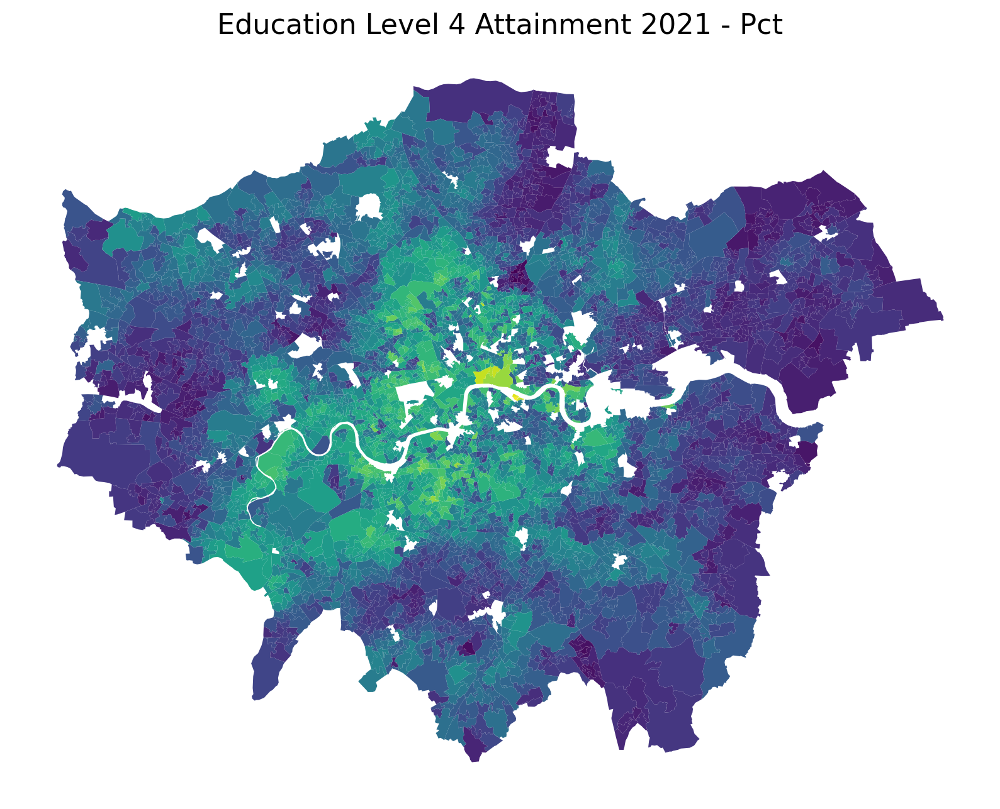

In [461]:
column_to_plot = "l4_perc"
merged = pd.merge(gdf, educ21_pivot, left_on=bdry_key, right_on="lsoa_code", how="left")

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged.plot(column_to_plot, cmap="viridis", ax=ax)

ax.set_title(
    "Education Level 4 Attainment 2021 - Pct",
    fontdict={"fontsize": "16", "fontweight": "3"},
)
ax.axis("off")

plt.show()

## Using IMD 2019

In [462]:
data_path = "../data/"
file_name = "imd2019lsoa.csv"
file_path = os.path.join(data_path, file_name)
imd19 = pd.read_csv(file_path)
imd19 = imd19.rename(columns={"FeatureCode": "lsoa_codes"})
imd19

,lsoa_codes,DateCode,Measurement,Units,Value,Indices of Deprivation
0,E01005278,2019,Rank,NaN,11281.000,b. Income Deprivation Domain
1,E01006616,2019,Decile,NaN,1.000,a. Index of Multiple Deprivation (IMD)
2,E01005236,2019,Rank,NaN,4565.000,b. Income Deprivation Domain
3,E01031873,2019,Rank,NaN,25826.000,b. Income Deprivation Domain
4,E01007367,2019,Decile,NaN,2.000,a. Index of Multiple Deprivation (IMD)
...,...,...,...,...,...,...
985315,E01018830,2019,Score,NaN,11.350,a. Index of Multiple Deprivation (IMD)
985316,E01019284,2019,Score,NaN,31.536,a. Index of Multiple Deprivation (IMD)
985317,E01024778,2019,Rank,NaN,18324.000,g. Barriers to Housing and Services Domain
985318,E01024832,2019,Rank,NaN,23566.000,g. Barriers to Housing and Services Domain


In [463]:
imd19_subset = imd19[imd19.Measurement == "Rank"]
imd_pivot19 = imd19_subset.pivot_table(
    values="Value",
    index="lsoa_codes",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "d. Education, Skills and Training Domain"
lsoa_var = "lsoa_codes"

imd19_edu = imd_pivot19[[lsoa_var, target_col]]
imd19_edu = imd19_edu.rename(columns={lsoa_var: "lsoa_codes", target_col: "t3_edu"})
imd19_edu = imd19_edu[[lsoa_var, "t3_edu"]]
imd19_edu

Indices of Deprivation,lsoa_codes,t3_edu
0,E01000001,32842.0
1,E01000002,32832.0
2,E01000003,26386.0
3,E01000005,12370.0
4,E01000006,17511.0
...,...,...
32839,E01033764,565.0
32840,E01033765,1781.0
32841,E01033766,20771.0
32842,E01033767,1208.0


## Joining

In [464]:
# educ11['Level 4 qualifications and above'].rank(pct=True)

In [465]:
# educ_perc11 = educ11[["lsoa_code", "l4_perc"]]

# file_path = "../data/lsoa01-to-lsoa11-lookup.csv"
# lsoa_mapping = pd.read_csv(file_path, encoding="latin")
# lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

# educ_perc11 = pd.merge(
#     educ_perc11, lsoa_mapping, left_on="lsoa_code", right_on="lsoa01cd", how="left"
# )  # now use lsoa11cd

# # Identify duplicates in the merged data
# duplicates = educ_perc11[educ_perc11.duplicated(subset="lsoa11cd", keep=False)]
# print("Number of duplicated rows: ", duplicates.shape[0])

# # Select numerical columns for aggregation
# numerical_cols = educ_perc11.select_dtypes(include="number").columns.tolist()

# # Aggregate duplicates by taking the mean for all numerical columns
# educ_perc11 = educ_perc11.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# # Rename columns for consistency
# educ_perc11 = educ_perc11.rename(columns={"lsoa11cd": "lsoa_codes"})

# # Check for remaining duplicates
# print("Number of remaining duplicates: ", educ_perc11.duplicated(subset="lsoa_codes").sum())

# educ_perc11 = educ_perc11.rename(
#     columns={"lsoa_code": "lsoa_codes", "l4_perc": "t1_edu"}
# )
# educ_perc11

In [628]:
educ11 = pd.read_excel("../data/qualifications-2011-2021-lsoa.xlsx", sheet_name="2011")
educ11["lsoa_codes"] = educ11["LSOA code"]
educ11["l4_perc"] = (educ11["Level 4+"] / educ11["Usual residents aged 16+"]) * 100

# load lookup table
file_path = "../data/lsoa11-to-lsoa21-lookup.csv"
lsoa_mapping = pd.read_csv(file_path)
lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

educ11 = pd.merge(
    educ11, lsoa_mapping, left_on="lsoa_codes", right_on="lsoa21cd", how="left"
)

# Identify duplicates in the merged data
duplicates = educ11[educ11.duplicated(subset="lsoa11cd", keep=False)]
print("Number of duplicated rows: ", duplicates.shape[0])

# Select numerical columns for aggregation
numerical_cols = educ11.select_dtypes(include="number").columns.tolist()

# Aggregate duplicates by taking the mean for all numerical columns
educ11 = educ11.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# Rename columns for consistency
educ11 = educ11.rename(columns={"lsoa11cd": "lsoa_codes"})

# Check for remaining duplicates
print("Number of remaining duplicates: ", educ11.duplicated(subset="lsoa_codes").sum())

educ11 = educ11.rename(columns={"lsoa_code": "lsoa_codes", "l4_perc": "t1_edu"})

educ11 = educ11[["lsoa_codes", "t1_edu"]]
educ11

Number of duplicated rows:  313
Number of remaining duplicates:  0


,lsoa_codes,t1_edu
0,E01000001,77.555556
1,E01000002,79.195669
2,E01000003,56.843800
3,E01000005,34.470158
4,E01000006,32.925898
...,...,...
4830,E01033742,48.319709
4831,E01033743,40.937020
4832,E01033744,29.127614
4833,E01033745,37.950820


<Axes: >

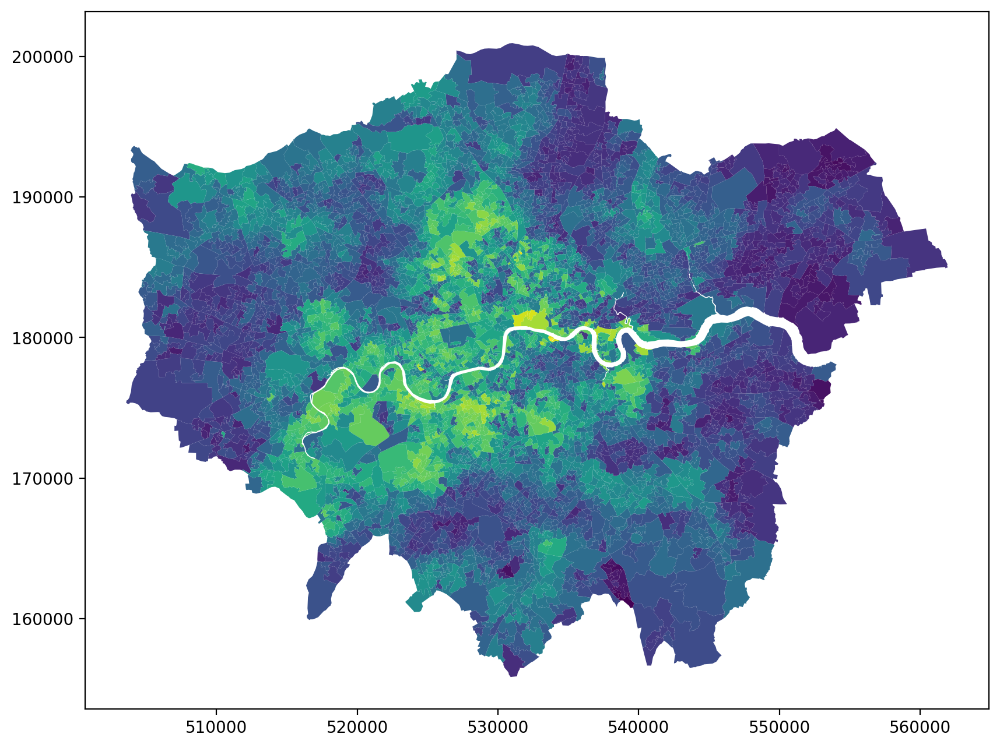

In [467]:
pd.merge(gdf, educ11, left_on=bdry_key, right_on="lsoa_codes", how="left").plot(
    "t1_edu", figsize=(10, 10)
)

In [468]:
# https://data.ubdc.ac.uk/datasets/indices-deprivation-2010
# https://webarchive.nationalarchives.gov.uk/ukgwa/20160110195753/http://www.ons.gov.uk/ons/guide-method/geography/products/census/lookup/2001-2011/index.html

data_path = "../data/"
file_name = "imd2010eng.csv"
file_path = os.path.join(data_path, file_name)
imd10 = pd.read_csv(file_path)
imd10.columns = map(str.lower, imd10.columns)

file_path = "../data/lsoa01-to-lsoa11-lookup.csv"
lsoa_mapping = pd.read_csv(file_path, encoding="latin")
lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

# Merge IMD data with mapping file
imd10 = pd.merge(
    imd10, lsoa_mapping, left_on="lsoacode", right_on="lsoa01cd", how="left"
)  # now use lsoa11cd

# Identify duplicates in the merged data
duplicates = imd10[imd10.duplicated(subset="lsoa11cd", keep=False)]
print("Number of duplicated rows: ", duplicates.shape[0])

# Select numerical columns for aggregation
numerical_cols = imd10.select_dtypes(include="number").columns.tolist()

# Aggregate duplicates by taking the mean for all numerical columns
imd10 = imd10.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# Rename columns for consistency
imd10 = imd10.rename(columns={"lsoa11cd": "lsoa_codes"})

# Check for remaining duplicates
print("Number of remaining duplicates: ", imd10.duplicated(subset="lsoa_codes").sum())

# Extract the relevant columns
imd10_edu = imd10[["lsoa_codes", "edust_rank"]]
imd10_edu = imd10_edu.rename(columns={"edust_rank": "t1_edu"})

imd10_edu

Number of duplicated rows:  311
Number of remaining duplicates:  0


,lsoa_codes,t1_edu
0,E01000001,32421.0
1,E01000002,32392.0
2,E01000003,24611.0
3,E01000005,13235.0
4,E01000006,18084.0
...,...,...
32835,E01033764,715.0
32836,E01033765,6723.0
32837,E01033766,24015.0
32838,E01033767,4363.0


In [469]:
data_path = "../data/"
file_name = "imd2015lsoa.csv"
file_path = os.path.join(data_path, file_name)
imd15 = pd.read_csv(file_path)

imd15_subset = imd15[imd15.Measurement == "Rank"]
imd_pivot15 = imd15_subset.pivot_table(
    values="Value",
    index="FeatureCode",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "d. Education, Skills and Training Domain"
imd15_edu = imd_pivot15[["FeatureCode", target_col]]
imd15_edu = imd15_edu.rename(
    columns={"FeatureCode": "lsoa_codes", target_col: "t2_edu"}
)
imd15_edu

Indices of Deprivation,lsoa_codes,t2_edu
0,E01000001,32840.0
1,E01000002,32836.0
2,E01000003,22251.0
3,E01000005,17420.0
4,E01000006,17806.0
...,...,...
32839,E01033764,1260.0
32840,E01033765,1948.0
32841,E01033766,21114.0
32842,E01033767,2986.0


In [470]:
data_path = "../data/"
file_name = "imd2019lsoa.csv"
file_path = os.path.join(data_path, file_name)
imd19 = pd.read_csv(file_path)
imd19 = imd19.rename(columns={"FeatureCode": "lsoa_codes"})

imd19_subset = imd19[imd19.Measurement == "Rank"]
imd_pivot19 = imd19_subset.pivot_table(
    values="Value",
    index="lsoa_codes",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "d. Education, Skills and Training Domain"
lsoa_var = "lsoa_codes"

imd19_edu = imd_pivot19[[lsoa_var, target_col]]
imd19_edu = imd19_edu.rename(columns={lsoa_var: "lsoa_codes", target_col: "t3_edu"})
imd19_edu = imd19_edu[[lsoa_var, "t3_edu"]]
imd19_edu

Indices of Deprivation,lsoa_codes,t3_edu
0,E01000001,32842.0
1,E01000002,32832.0
2,E01000003,26386.0
3,E01000005,12370.0
4,E01000006,17511.0
...,...,...
32839,E01033764,565.0
32840,E01033765,1781.0
32841,E01033766,20771.0
32842,E01033767,1208.0


In [471]:
educ21 = pd.read_excel("../data/qualifications-2011-2021-lsoa.xlsx", sheet_name="2021")
educ21["lsoa_codes"] = educ21["LSOA code"]
educ21["l4_perc"] = (educ21["Level 4+"] / educ21["Usual residents aged 16+"]) * 100

# load lookup table
file_path = "../data/lsoa11-to-lsoa21-lookup.csv"
lsoa_mapping = pd.read_csv(file_path)
lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

educ21 = pd.merge(
    educ21, lsoa_mapping, left_on="lsoa_codes", right_on="lsoa21cd", how="left"
)

# Identify duplicates in the merged data
duplicates = educ21[educ21.duplicated(subset="lsoa11cd", keep=False)]
print("Number of duplicated rows: ", duplicates.shape[0])

# Select numerical columns for aggregation
numerical_cols = educ21.select_dtypes(include="number").columns.tolist()

# Aggregate duplicates by taking the mean for all numerical columns
educ21 = educ21.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# Rename columns for consistency
educ21 = educ21.rename(columns={"lsoa11cd": "lsoa_codes"})

# Check for remaining duplicates
print("Number of remaining duplicates: ", educ21.duplicated(subset="lsoa_codes").sum())

educ21 = educ21.rename(columns={"lsoa_code": "lsoa_codes", "l4_perc": "t3_edu"})

educ21 = educ21[["lsoa_codes", "t3_edu"]]
educ21

Number of duplicated rows:  313
Number of remaining duplicates:  0


,lsoa_codes,t3_edu
0,E01000001,83.222469
1,E01000002,83.538462
2,E01000003,70.099668
3,E01000005,40.396660
4,E01000006,34.919524
...,...,...
4830,E01033742,55.855019
4831,E01033743,43.886926
4832,E01033744,39.624060
4833,E01033745,42.901961


<Axes: >

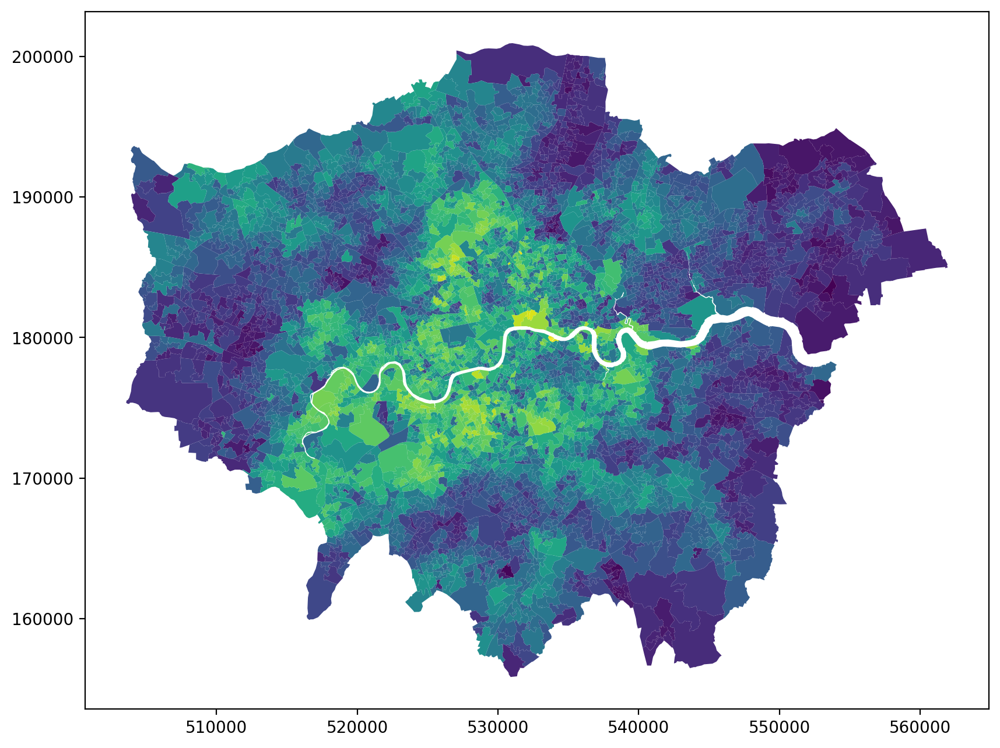

In [472]:
pd.merge(gdf, educ21, left_on=bdry_key, right_on="lsoa_codes", how="left").plot(
    "t3_edu", figsize=(10, 10)
)

In [473]:
# educ_perc21 = educ21_pivot[["lsoa_code", "l4_perc"]]

# file_path = "../data/lsoa01-to-lsoa11-lookup.csv"
# lsoa_mapping = pd.read_csv(file_path, encoding="latin")
# lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

# educ_perc21 = pd.merge(
#     educ_perc21, lsoa_mapping, left_on="lsoa_code", right_ddon="lsoa01cd", how="left"
# )  # now use lsoa11cd

# # Identify duplicates in the merged data
# duplicates = educ_perc21[educ_perc21.duplicated(subset="lsoa11cd", keep=False)]
# print("Number of duplicated rows: ", duplicates.shape[0])

# # Select numerical columns for aggregation
# numerical_cols = educ_perc21.select_dtypes(include="number").columns.tolist()

# # Aggregate duplicates by taking the mean for all numerical columns
# educ_perc21 = educ_perc21.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# # Rename columns for consistency
# educ_perc21 = educ_perc21.rename(columns={"lsoa11cd": "lsoa_codes"})

# # Check for remaining duplicates
# print("Number of remaining duplicates: ", educ_perc21.duplicated(subset="lsoa_codes").sum())

# educ_perc21 = educ_perc21.rename(
#     columns={"lsoa_code": "lsoa_codes", "l4_perc": "t3_edu"}
# )
# educ_perc21

In [474]:
# pd.merge(gdf, educ_perc21, left_on=bdry_key, right_on="lsoa_codes", how="left").plot(
#     "t3_edu", figsize=(10, 10)
# )

In [475]:
# educ = educ_perc21.merge(educ_perc11, on="lsoa_codes", how="left")
# educ = educ_perc21.merge(imd15_edu, on="lsoa_codes", how="left")
# educ = imd19_edu.merge(imd15_edu, on="lsoa_codes", how="left")
# educ = imd19_edu.merge(imd15_edu, on="lsoa_codes", how="left").merge(
#     imd10_edu, how="left"
# )
educ = educ21.merge(educ11, how="left")
educ

,lsoa_codes,t3_edu,t1_edu
0,E01000001,83.222469,77.555556
1,E01000002,83.538462,79.195669
2,E01000003,70.099668,56.843800
3,E01000005,40.396660,34.470158
4,E01000006,34.919524,32.925898
...,...,...,...
4830,E01033742,55.855019,48.319709
4831,E01033743,43.886926,40.937020
4832,E01033744,39.624060,29.127614
4833,E01033745,42.901961,37.950820


<Axes: >

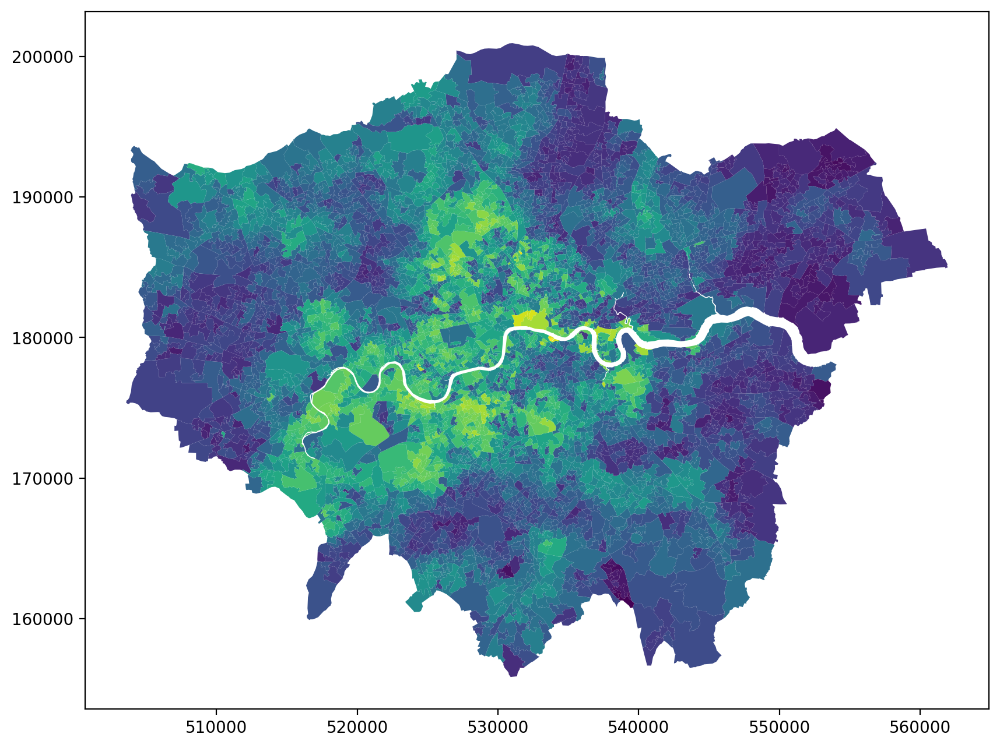

In [476]:
pd.merge(gdf, educ, left_on=bdry_key, right_on="lsoa_codes", how="left").plot(
    "t1_edu", figsize=(10, 10)
)

# Housing

## 2010

In [477]:
os.listdir("../data/")

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_ward20_lookup.csv',
 'lsoa21_ward23_lookup.csv',
 'planning_local_plan_data_25.gpkg',
 'planning_local_plan_data_30.gpkg',
 'planning_local_plan_data_31.gpkg',

In [478]:
data_path = "../data/"
file_name = "imd2010eng.csv"
file_path = os.path.join(data_path, file_name)
imd10 = pd.read_csv(file_path)

In [479]:
imd10

,lsoacode,laname,gorname,imd_score,imd_rank,income_score,income_rank,employ_score,employ_rank,healthdd_score,healthdd_rank,edust_score,edust_rank,housesb_score,housesb_rank,crimed_score,crimed_rank,environl_score,environl_rank
0,E01000001,City of London,London,6.16,28814,0.01,32460,0.01,32435,-2.11,32332,0.21,32421,32.60,5491,-1.64,31816,26.28,10212
1,E01000002,City of London,London,5.59,29450,0.01,32457,0.01,32452,-2.78,32472,0.26,32392,30.26,6980,-1.93,32269,25.73,10483
2,E01000003,City of London,London,13.29,20047,0.07,22562,0.05,26026,-0.97,28188,7.16,24611,40.32,2211,-1.21,30147,36.48,6088
3,E01000004,City of London,London,11.17,22503,0.04,30002,0.04,28814,-1.04,28814,1.76,30899,37.92,3012,-1.32,30744,46.72,3257
4,E01000005,City of London,London,21.36,12978,0.16,11341,0.07,19427,0.07,14900,20.24,13235,34.66,4407,-1.02,28792,40.94,4730
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32477,E01032478,Wyre Forest District,West Midlands,28.13,9056,0.19,8954,0.12,10105,0.26,12257,53.04,2711,13.78,23701,0.23,12967,31.00,8103
32478,E01032479,Wyre Forest District,West Midlands,18.74,14977,0.12,15095,0.10,13387,-0.10,17382,12.98,18820,33.11,5196,0.08,15137,16.39,16642
32479,E01032480,Wyre Forest District,West Midlands,13.51,19783,0.07,21864,0.07,20213,-0.86,27094,13.60,18313,35.06,4221,-0.06,17216,14.99,17851
32480,E01032481,Wyre Forest District,West Midlands,31.42,7592,0.19,8966,0.14,7428,0.70,6921,27.15,9554,43.48,1447,-0.06,17246,19.12,14498


In [480]:
imd10.columns

Index(['lsoacode', 'laname', 'gorname', 'imd_score', 'imd_rank',
       'income_score', 'income_rank', 'employ_score', 'employ_rank',
       'healthdd_score', 'healthdd_rank', 'edust_score', 'edust_rank',
       'housesb_score', 'housesb_rank', 'crimed_score', 'crimed_rank',
       'environl_score', 'environl_rank'],
      dtype='object')

In [481]:
imd10.columns[-5], imd10.columns[-6]

('housesb_rank', 'housesb_score')

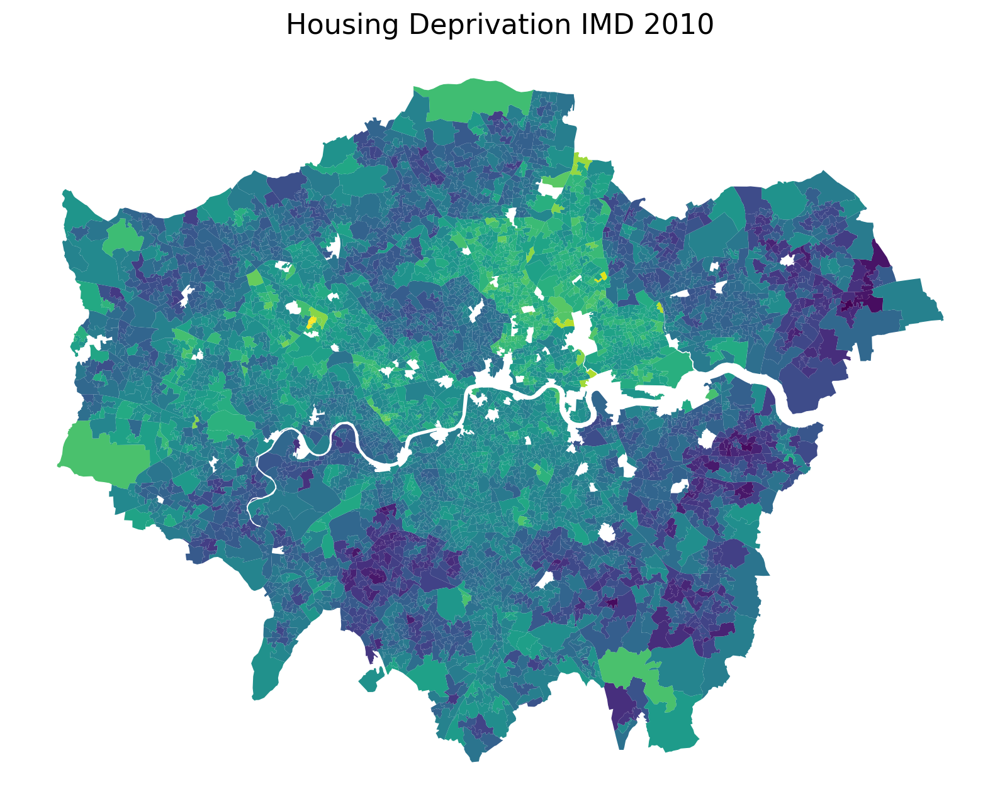

In [482]:
column_to_plot = "housesb_score"
# column_to_plot = 'BARRIERS TO HOUSING AND SERVICES SCORE'

merged = pd.merge(gdf, imd10, left_on=bdry_key, right_on="lsoacode", how="left")

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged.plot(column_to_plot, cmap="viridis", ax=ax)

ax.set_title(
    "Housing Deprivation IMD 2010", fontdict={"fontsize": "16", "fontweight": "3"}
)
ax.axis("off")

plt.show()

## 2015

In [483]:
data_path = "../data/"
file_name = "imd2015lsoa.csv"
file_path = os.path.join(data_path, file_name)
imd15 = pd.read_csv(file_path)
imd15["Indices of Deprivation"].value_counts()

Indices of Deprivation
j. Income Deprivation Affecting Older People Index (IDAOPI)    98532
h. Living Environment Deprivation Domain                       98532
d. Education, Skills and Training Domain                       98532
c. Employment Deprivation Domain                               98532
e. Health Deprivation and Disability Domain                    98532
a. Index of Multiple Deprivation (IMD)                         98532
i. Income Deprivation Affecting Children Index (IDACI)         98532
g. Barriers to Housing and Services Domain                     98532
b. Income Deprivation Domain                                   98532
f. Crime Domain                                                98532
Name: count, dtype: int64

In [484]:
imd15_subset = imd15[imd15.Measurement == "Rank"]
imd_pivot15 = imd15_subset.pivot_table(
    values="Value",
    index="FeatureCode",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "g. Barriers to Housing and Services Domain"
imd15_house = imd_pivot15[["FeatureCode", target_col]]
imd15_house = imd15_house.rename(
    columns={"FeatureCode": "lsoa_codes", target_col: "t2_house"}
)
imd15_house

Indices of Deprivation,lsoa_codes,t2_house
0,E01000001,9056.0
1,E01000002,9716.0
2,E01000003,5633.0
3,E01000005,3981.0
4,E01000006,2197.0
...,...,...
32839,E01033764,21851.0
32840,E01033765,23049.0
32841,E01033766,31573.0
32842,E01033767,27024.0


## 2020

In [485]:
os.listdir("../data/")

['age-2011-lsoa.csv',
 'age-2011-lsoa.xls',
 'age-2015-lsoa.csv',
 'age-2015-lsoa.xls',
 'age-2020-lsoa.csv',
 'age-2020-lsoa.xlsx',
 'age-2021-lsoa.csv',
 'clipped_2015',
 'clipped_2016',
 'clipped_2020',
 'clipped_2021',
 'composites',
 'deprivation-2011-lsoa.xlsx',
 'deprivation-2021-lsoa.csv',
 'education-2011-lsoa.csv',
 'education-2021-lsoa.csv',
 'education-sex-2021-lsoa.csv',
 'ESRI',
 'hh_churn_lsoa11_2023.csv',
 'IMD19',
 'imd2010eng.csv',
 'imd2010englsoa2011.csv',
 'imd2010lsoa.csv',
 'imd2015lsoa.csv',
 'imd2019lsoa.csv',
 'london_data_clean.csv',
 'london_lsoa2osward.csv',
 'lsoa01-to-lsoa11-lookup.csv',
 'lsoa01_ward11_lookup.csv',
 'lsoa11-to-lsoa21-lookup.csv',
 'lsoa11_ward15_lookup.csv',
 'lsoa11_ward16_lookup.csv',
 'lsoa11_ward17_lookup.csv',
 'lsoa11_ward18_lookup.csv',
 'lsoa11_ward19_lookup.csv',
 'lsoa11_ward20_lookup.csv',
 'lsoa21_ward23_lookup.csv',
 'planning_local_plan_data_25.gpkg',
 'planning_local_plan_data_30.gpkg',
 'planning_local_plan_data_31.gpkg',

In [486]:
data_path = "../data/"
file_name = "imd2019lsoa.csv"
file_path = os.path.join(data_path, file_name)
imd19 = pd.read_csv(file_path)

In [487]:
imd19 = imd19.rename(columns={"FeatureCode": "lsoa_codes"})
imd19

,lsoa_codes,DateCode,Measurement,Units,Value,Indices of Deprivation
0,E01005278,2019,Rank,NaN,11281.000,b. Income Deprivation Domain
1,E01006616,2019,Decile,NaN,1.000,a. Index of Multiple Deprivation (IMD)
2,E01005236,2019,Rank,NaN,4565.000,b. Income Deprivation Domain
3,E01031873,2019,Rank,NaN,25826.000,b. Income Deprivation Domain
4,E01007367,2019,Decile,NaN,2.000,a. Index of Multiple Deprivation (IMD)
...,...,...,...,...,...,...
985315,E01018830,2019,Score,NaN,11.350,a. Index of Multiple Deprivation (IMD)
985316,E01019284,2019,Score,NaN,31.536,a. Index of Multiple Deprivation (IMD)
985317,E01024778,2019,Rank,NaN,18324.000,g. Barriers to Housing and Services Domain
985318,E01024832,2019,Rank,NaN,23566.000,g. Barriers to Housing and Services Domain


In [488]:
imd19.Measurement.value_counts()

Measurement
Rank       328440
Decile     328440
Score      328440
Name: count, dtype: int64

In [489]:
imd19_subset = imd19[imd19.Measurement == "Score"]
imd_pivot19 = imd19_subset.pivot_table(
    values="Value",
    index="lsoa_codes",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

In [490]:
imd_pivot19

Indices of Deprivation,lsoa_codes,a. Index of Multiple Deprivation (IMD),b. Income Deprivation Domain,c. Employment Deprivation Domain,"d. Education, Skills and Training Domain",e. Health Deprivation and Disability Domain,f. Crime Domain,g. Barriers to Housing and Services Domain,h. Living Environment Deprivation Domain,i. Income Deprivation Affecting Children Index (IDACI),j. Income Deprivation Affecting Older People Index (IDAOPI)
0,E01000001,6.208,0.007,0.010,0.024,-1.654,-2.012,29.472,31.873,0.006,0.012
1,E01000002,5.143,0.034,0.027,0.063,-1.115,-2.343,24.412,23.084,0.037,0.030
2,E01000003,19.402,0.086,0.086,5.804,-0.102,-1.032,40.103,40.535,0.052,0.128
3,E01000005,28.652,0.211,0.136,22.260,-0.121,-1.317,39.900,28.979,0.209,0.322
4,E01000006,19.837,0.117,0.059,14.798,-0.359,-0.147,45.171,26.888,0.155,0.162
...,...,...,...,...,...,...,...,...,...,...,...
32839,E01033764,74.468,0.470,0.341,73.723,2.361,1.316,16.867,20.426,0.414,0.544
32840,E01033765,59.599,0.362,0.280,59.571,1.665,1.015,19.411,12.584,0.492,0.455
32841,E01033766,21.895,0.099,0.073,11.133,0.823,0.054,4.477,58.942,0.097,0.207
32842,E01033767,66.704,0.396,0.291,64.836,1.828,0.314,11.968,57.424,0.520,0.465


In [491]:
imd_pivot19.columns[-4]

'g. Barriers to Housing and Services Domain'

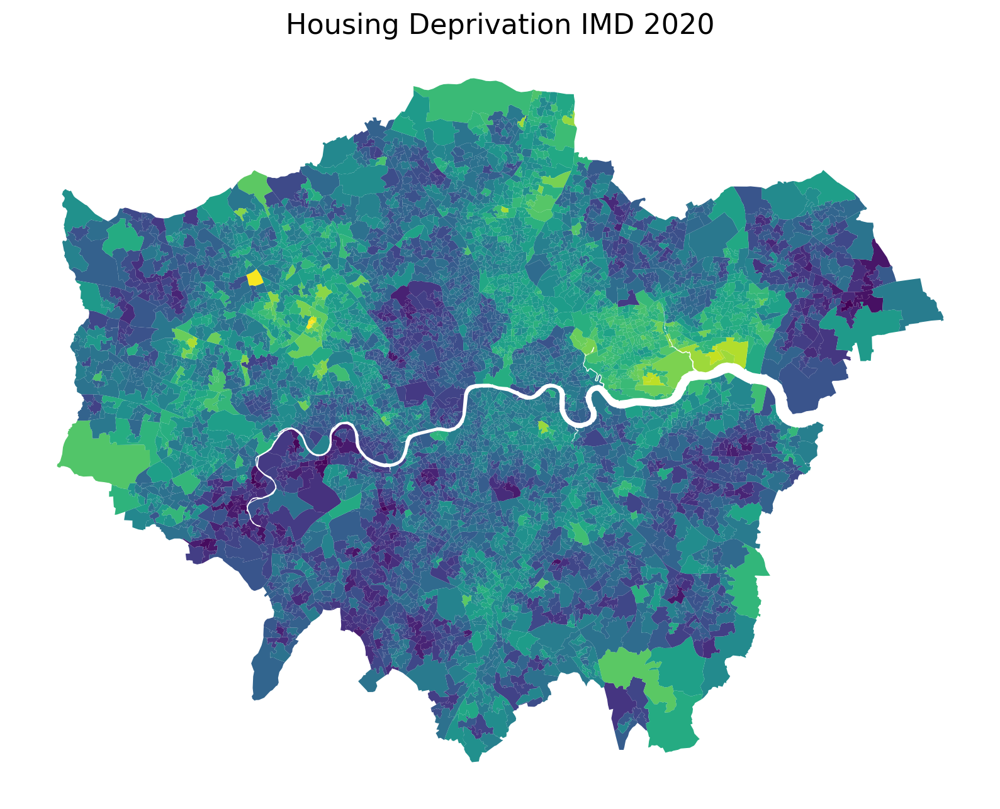

In [492]:
column_to_plot = "g. Barriers to Housing and Services Domain"
merged = pd.merge(gdf, imd_pivot19, left_on=bdry_key, right_on="lsoa_codes")

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
merged.plot(column_to_plot, cmap="viridis", ax=ax)

ax.set_title(
    "Housing Deprivation IMD 2020", fontdict={"fontsize": "16", "fontweight": "3"}
)
ax.axis("off")

plt.show()

## Joining

In [45]:
# https://data.ubdc.ac.uk/datasets/indices-deprivation-2010
# https://webarchive.nationalarchives.gov.uk/ukgwa/20160110195753/http://www.ons.gov.uk/ons/guide-method/geography/products/census/lookup/2001-2011/index.html

data_path = "../data/"
file_name = "imd2010eng.csv"
file_path = os.path.join(data_path, file_name)
imd10 = pd.read_csv(file_path)
imd10.columns = map(str.lower, imd10.columns)

file_path = "../data/lsoa01-to-lsoa11-lookup.csv"
lsoa_mapping = pd.read_csv(file_path, encoding="latin")
lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

# Merge IMD data with mapping file
imd10 = pd.merge(
    imd10, lsoa_mapping, left_on="lsoacode", right_on="lsoa01cd", how="left"
)  # now use lsoa11cd

# Identify duplicates in the merged data
duplicates = imd10[imd10.duplicated(subset="lsoa11cd", keep=False)]
print("Number of duplicated rows: ", duplicates.shape[0])

# Select numerical columns for aggregation
numerical_cols = imd10.select_dtypes(include="number").columns.tolist()

# Aggregate duplicates by taking the mean for all numerical columns
imd10 = imd10.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# Rename columns for consistency
imd10 = imd10.rename(columns={"lsoa11cd": "lsoa_codes"})

# Check for remaining duplicates
print("Number of remaining duplicates: ", imd10.duplicated(subset="lsoa_codes").sum())

# Extract the relevant columns
imd_housing_var = "housesb_rank"
lsoa_var = "lsoa_codes"
imd10_house = imd10[[lsoa_var, imd_housing_var]]
imd10_house = imd10_house.rename(
    columns={lsoa_var: "lsoa_codes", imd_housing_var: "t1_house"}
)
imd10_house

Number of duplicated rows:  311
Number of remaining duplicates:  0


,lsoa_codes,t1_house
0,E01000001,5491.0
1,E01000002,6980.0
2,E01000003,2211.0
3,E01000005,4407.0
4,E01000006,5374.0
...,...,...
32835,E01033764,10168.0
32836,E01033765,8061.0
32837,E01033766,22980.0
32838,E01033767,8987.0


<Axes: >

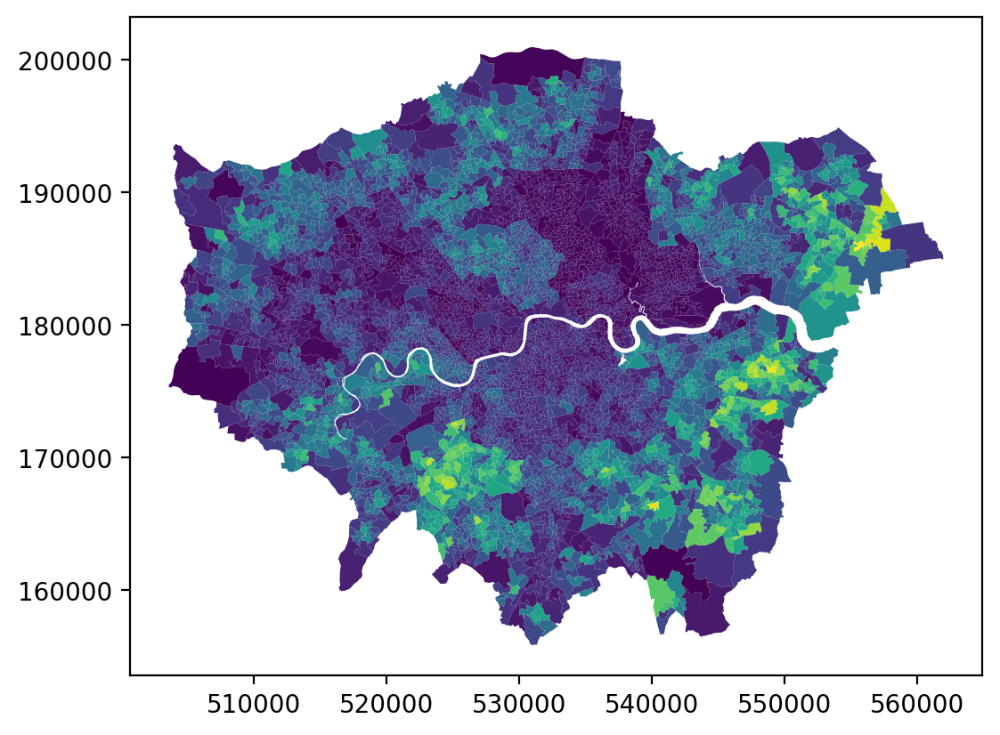

In [494]:
pd.merge(gdf, imd10, left_on=bdry_key, right_on="lsoa_codes").plot(
    imd_housing_var, cmap="viridis"
)

In [495]:
imd15_subset = imd15[imd15.Measurement == "Rank"]
imd_pivot15 = imd15_subset.pivot_table(
    values="Value",
    index="FeatureCode",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "g. Barriers to Housing and Services Domain"
imd15_house = imd_pivot15[["FeatureCode", target_col]]
imd15_house = imd15_house.rename(
    columns={"FeatureCode": "lsoa_codes", target_col: "t2_house"}
)
imd15_house

Indices of Deprivation,lsoa_codes,t2_house
0,E01000001,9056.0
1,E01000002,9716.0
2,E01000003,5633.0
3,E01000005,3981.0
4,E01000006,2197.0
...,...,...
32839,E01033764,21851.0
32840,E01033765,23049.0
32841,E01033766,31573.0
32842,E01033767,27024.0


<Axes: >

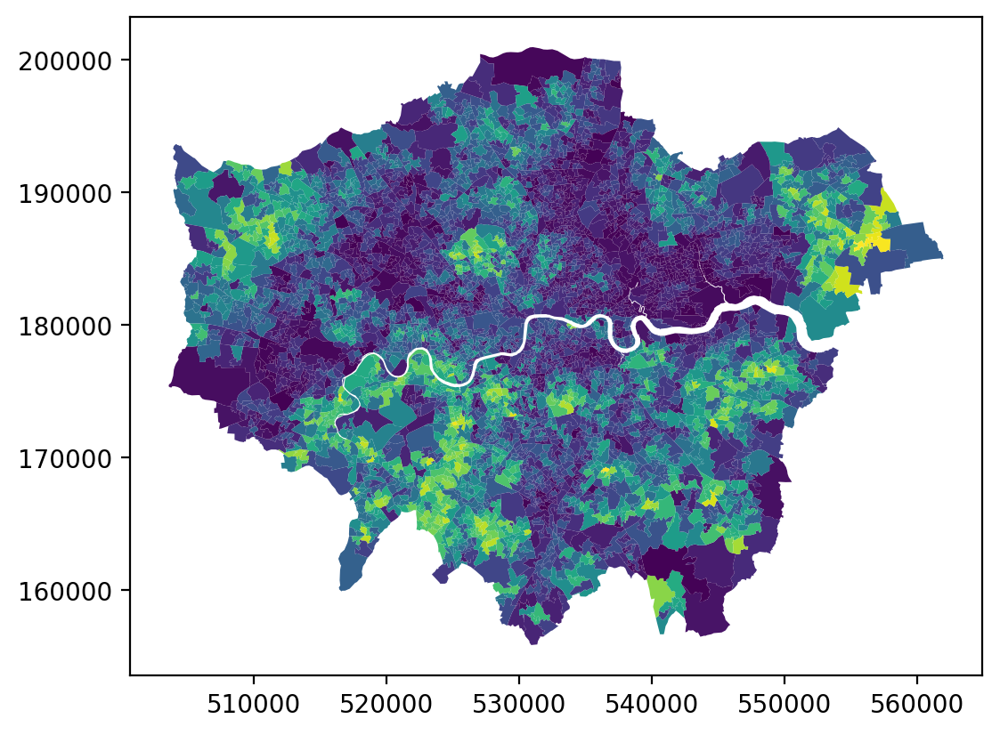

In [496]:
pd.merge(gdf, imd15_house, left_on=bdry_key, right_on="lsoa_codes").plot(
    "t2_house", cmap="viridis"
)

In [497]:
imd19_subset = imd19[imd19.Measurement == "Rank"]
imd_pivot19 = imd19_subset.pivot_table(
    values="Value",
    index="lsoa_codes",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "g. Barriers to Housing and Services Domain"  # imd_pivot19.columns[-4]
imd20_house = imd_pivot19[["lsoa_codes", target_col]]
imd20_house = imd20_house.rename(
    columns={"lsoa_codes": "lsoa_codes", target_col: "t3_house"}
)
imd20_house

Indices of Deprivation,lsoa_codes,t3_house
0,E01000001,7319.0
1,E01000002,11707.0
2,E01000003,2157.0
3,E01000005,2217.0
4,E01000006,1033.0
...,...,...
32839,E01033764,20598.0
32840,E01033765,17379.0
32841,E01033766,32228.0
32842,E01033767,26597.0


In [498]:
# house = imd20_house.merge(imd10_house, how="left")
# house = pd.merge(imd20_house, imd15_house, how="left")
house = pd.merge(imd20_house, imd15_house, how="left").merge(imd10_house, how="left")
house

,lsoa_codes,t3_house,t2_house,t1_house
0,E01000001,7319.0,9056.0,5491.0
1,E01000002,11707.0,9716.0,6980.0
2,E01000003,2157.0,5633.0,2211.0
3,E01000005,2217.0,3981.0,4407.0
4,E01000006,1033.0,2197.0,5374.0
...,...,...,...,...
32839,E01033764,20598.0,21851.0,10168.0
32840,E01033765,17379.0,23049.0,8061.0
32841,E01033766,32228.0,31573.0,22980.0
32842,E01033767,26597.0,27024.0,8987.0


<Axes: >

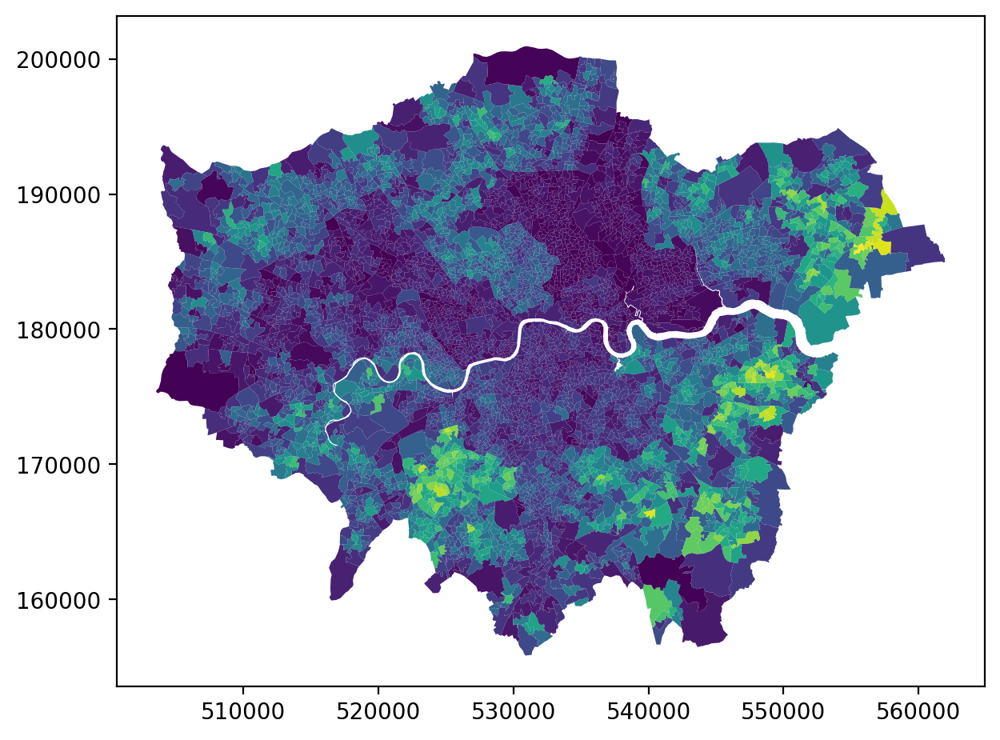

In [499]:
pd.merge(gdf, house, left_on=bdry_key, right_on="lsoa_codes").plot(
    "t1_house", cmap="viridis", figsize=(7, 7)
)

# Income

## Joining

In [500]:
# let's reuse imd2010 and imd20

In [501]:
# https://data.ubdc.ac.uk/datasets/indices-deprivation-2010
# https://webarchive.nationalarchives.gov.uk/ukgwa/20160110195753/http://www.ons.gov.uk/ons/guide-method/geography/products/census/lookup/2001-2011/index.html

data_path = "../data/"
file_name = "imd2010eng.csv"
file_path = os.path.join(data_path, file_name)
imd10 = pd.read_csv(file_path)
imd10.columns = map(str.lower, imd10.columns)

file_path = "../data/lsoa01-to-lsoa11-lookup.csv"
lsoa_mapping = pd.read_csv(file_path, encoding="latin")
lsoa_mapping.columns = map(str.lower, lsoa_mapping.columns)

# Merge IMD data with mapping file
imd10 = pd.merge(
    imd10, lsoa_mapping, left_on="lsoacode", right_on="lsoa01cd", how="left"
)  # now use lsoa11cd

# Identify duplicates in the merged data
duplicates = imd10[imd10.duplicated(subset="lsoa11cd", keep=False)]
print("Number of duplicated rows: ", duplicates.shape[0])

# Select numerical columns for aggregation
numerical_cols = imd10.select_dtypes(include="number").columns.tolist()

# Aggregate duplicates by taking the mean for all numerical columns
imd10 = imd10.groupby("lsoa11cd")[numerical_cols].mean().reset_index()

# Rename columns for consistency
imd10 = imd10.rename(columns={"lsoa11cd": "lsoa_codes"})

# Check for remaining duplicates
print("Number of remaining duplicates: ", imd10.duplicated(subset="lsoa_codes").sum())

# Extract the relevant columns
imd_income_var = "income_rank"
lsoa_var = "lsoa_codes"

imd10_income = imd10[[lsoa_var, imd_income_var]]
imd10_income = imd10_income.rename(
    columns={lsoa_var: "lsoa_codes", imd_income_var: "t1_income"}
)
imd10_income

Number of duplicated rows:  311
Number of remaining duplicates:  0


,lsoa_codes,t1_income
0,E01000001,32460.0
1,E01000002,32457.0
2,E01000003,22562.0
3,E01000005,11341.0
4,E01000006,14996.0
...,...,...
32835,E01033764,65.0
32836,E01033765,3074.0
32837,E01033766,20320.0
32838,E01033767,5629.0


In [502]:
imd15["Indices of Deprivation"].value_counts()

Indices of Deprivation
j. Income Deprivation Affecting Older People Index (IDAOPI)    98532
h. Living Environment Deprivation Domain                       98532
d. Education, Skills and Training Domain                       98532
c. Employment Deprivation Domain                               98532
e. Health Deprivation and Disability Domain                    98532
a. Index of Multiple Deprivation (IMD)                         98532
i. Income Deprivation Affecting Children Index (IDACI)         98532
g. Barriers to Housing and Services Domain                     98532
b. Income Deprivation Domain                                   98532
f. Crime Domain                                                98532
Name: count, dtype: int64

In [503]:
imd15_subset = imd15[imd15.Measurement == "Rank"]
imd_pivot15 = imd15_subset.pivot_table(
    values="Value",
    index="FeatureCode",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "b. Income Deprivation Domain"
imd15_income = imd_pivot15[["FeatureCode", target_col]]
imd15_income = imd15_income.rename(
    columns={"FeatureCode": "lsoa_codes", target_col: "t2_income"}
)
imd15_income

Indices of Deprivation,lsoa_codes,t2_income
0,E01000001,32813.0
1,E01000002,32780.0
2,E01000003,17600.0
3,E01000005,7255.0
4,E01000006,14190.0
...,...,...
32839,E01033764,81.0
32840,E01033765,965.0
32841,E01033766,15357.0
32842,E01033767,541.0


In [504]:
imd19["Measurement"].unique()

array(['Rank', 'Decile ', 'Score'], dtype=object)

In [505]:
imd19_subset = imd19[imd19.Measurement == "Rank"]
imd_pivot19 = imd19_subset.pivot_table(
    values="Value",
    index="lsoa_codes",
    columns="Indices of Deprivation",
    fill_value=0,  # Assuming that if there is no record for an age, the population is 0
).reset_index()

target_col = "b. Income Deprivation Domain"
lsoa_var = "lsoa_codes"

imd20_income = imd_pivot19[[lsoa_var, target_col]]
imd20_income = imd20_income.rename(
    columns={lsoa_var: "lsoa_codes", target_col: "t3_income"}
)
imd20_income = imd20_income[[lsoa_var, "t3_income"]]
imd20_income

Indices of Deprivation,lsoa_codes,t3_income
0,E01000001,32831.0
1,E01000002,29901.0
2,E01000003,18510.0
3,E01000005,6029.0
4,E01000006,14023.0
...,...,...
32839,E01033764,90.0
32840,E01033765,838.0
32841,E01033766,16430.0
32842,E01033767,442.0


In [506]:
# income = imd20_income.merge(imd10_income, how="left")
# income = imd20_income.merge(imd15_income, how="left")
income = imd20_income.merge(imd15_income, how="left").merge(imd10_income, how="left")
income

,lsoa_codes,t3_income,t2_income,t1_income
0,E01000001,32831.0,32813.0,32460.0
1,E01000002,29901.0,32780.0,32457.0
2,E01000003,18510.0,17600.0,22562.0
3,E01000005,6029.0,7255.0,11341.0
4,E01000006,14023.0,14190.0,14996.0
...,...,...,...,...
32839,E01033764,90.0,81.0,65.0
32840,E01033765,838.0,965.0,3074.0
32841,E01033766,16430.0,15357.0,20320.0
32842,E01033767,442.0,541.0,5629.0


In [507]:
# higher the rank -> less deprived
pd.merge(gdf, income, left_on=bdry_key, right_on="lsoa_codes")[
    ["LSOA11NM", "t3_income", "t2_income", "t1_income"]
]

,LSOA11NM,t3_income,t2_income,t1_income
0,City of London 001A,32831.0,32813.0,32460.0
1,City of London 001B,29901.0,32780.0,32457.0
2,City of London 001C,18510.0,17600.0,22562.0
3,City of London 001E,6029.0,7255.0,11341.0
4,Barking and Dagenham 016A,14023.0,14190.0,14996.0
...,...,...,...,...
4830,Greenwich 007F,19844.0,15882.0,5102.0
4831,Greenwich 002H,12244.0,8069.0,5211.0
4832,Greenwich 007G,7767.0,7499.0,5102.0
4833,Greenwich 002I,10101.0,8161.0,5211.0


<Axes: >

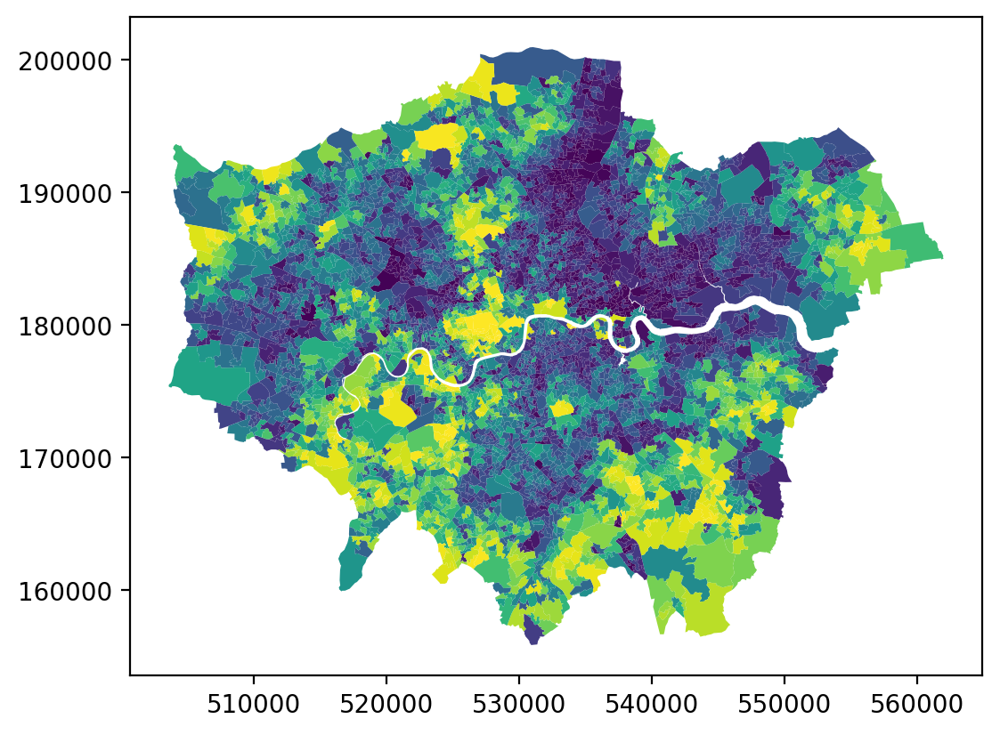

In [508]:
# sns.reset_orig()
pd.merge(gdf, income, left_on=bdry_key, right_on="lsoa_codes").plot(
    "t1_income", cmap="viridis"
)

# Main Dataset

In [509]:
main = income.merge(house).merge(educ).merge(age)
main

,lsoa_codes,t3_income,t2_income,t1_income,t3_house,t2_house,t1_house,t3_edu,t1_edu,t3_age,t2_age,t1_age
0,E01000001,32831.0,32813.0,32460.0,7319.0,9056.0,5491.0,83.222469,77.555556,13.607776,9.567901,19.633152
1,E01000002,29901.0,32780.0,32457.0,11707.0,9716.0,6980.0,83.538462,79.195669,17.461263,6.660900,14.394993
2,E01000003,18510.0,17600.0,22562.0,2157.0,5633.0,2211.0,70.099668,56.843800,15.947368,10.962963,20.474777
3,E01000005,6029.0,7255.0,11341.0,2217.0,3981.0,4407.0,40.396660,34.470158,18.798716,11.864407,20.162107
4,E01000006,14023.0,14190.0,14996.0,1033.0,2197.0,5374.0,34.919524,32.925898,17.430326,20.343137,23.743501
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,19844.0,15882.0,5102.0,2042.0,5118.0,1373.0,55.855019,48.319709,23.343109,29.218107,36.483516
4831,E01033743,12244.0,8069.0,5211.0,286.0,1197.0,2904.0,43.886926,40.937020,12.961373,16.117065,20.187100
4832,E01033744,7767.0,7499.0,5102.0,3095.0,5973.0,1373.0,39.624060,29.127614,17.016575,19.105263,21.713362
4833,E01033745,10101.0,8161.0,5211.0,1047.0,2091.0,2904.0,42.901961,37.950820,12.179165,13.408393,16.740088


In [5]:
main.to_csv("../outputs/socio-raw.csv", index=False)

NameError: name 'main' is not defined

In [6]:
main = pd.read_csv("../outputs/socio-raw.csv")

In [7]:
main.columns.tolist()

['lsoa_codes',
 't3_income',
 't2_income',
 't1_income',
 't3_house',
 't2_house',
 't1_house',
 't3_edu',
 't1_edu',
 't3_age',
 't2_age',
 't1_age']

In [8]:
file_path = "../data/ESRI/LSOA_2011_London_gen_MHW.shp"
gdf = gpd.read_file(file_path, crs="EPSG:27700")
bdry_key = "LSOA11CD"

file_path = "../data/ESRI/London_Borough_Excluding_MHW.shp"
boroughs = gpd.read_file(file_path, crs="EPSG:27700")

c:\Users\Javier Alfaro\Dropbox\Master\LSE\CDRC\venv\Lib\site-packages\pyogrio\raw.py:196: RuntimeWarning: driver ESRI Shapefile does not support open option CRS
  return ogr_read(
c:\Users\Javier Alfaro\Dropbox\Master\LSE\CDRC\venv\Lib\site-packages\pyogrio\raw.py:196: RuntimeWarning: driver ESRI Shapefile does not support open option CRS
  return ogr_read(


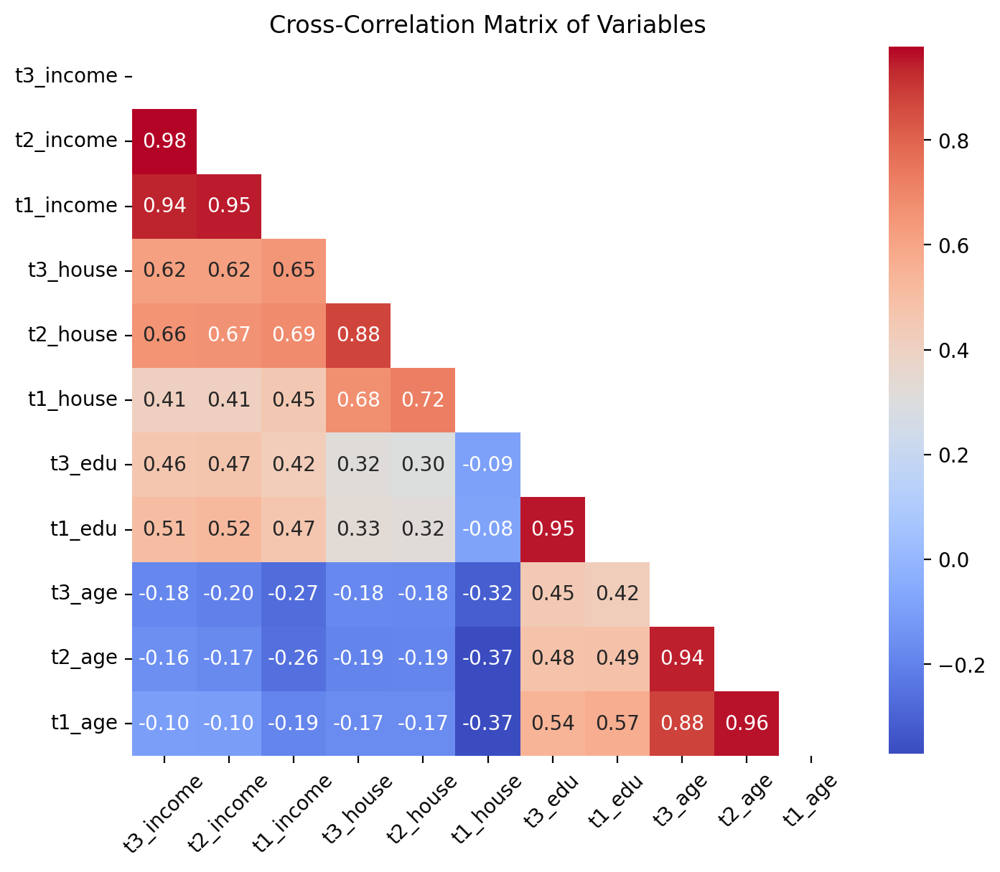

In [51]:
num_cols = main.select_dtypes(include="number").columns

corr_matrix = main[num_cols].corr()
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

plt.figure(figsize=(8, 8))
sns.heatmap(
    corr_matrix,
    mask=mask,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    cbar_kws={"shrink": 0.8},
    square=True,
)

plt.xticks(rotation=45)
plt.title("Cross-Correlation Matrix of Variables")
plt.savefig("../outputs/corr.png", dpi=300, transparent=True)
plt.show()

In [267]:
# data = main.copy()

# # data["age_change"] = (data["t2_age"] - data["t1_age"]) / data["t1_age"]
# # data["edu_change"] = (data["t2_edu"] - data["t1_edu"]) / data["t1_edu"]
# # data["house_change"] = (data["t2_house"] - data["t1_house"]) / data["t1_house"]
# # data["income_change"] = (data["t2_income"] - data["t1_income"]) / data["t1_income"]

# data["age_change"] = (data["t3_age"] - data["t2_age"]) / data["t2_age"]
# data["edu_change"] = (data["t3_edu"] - data["t2_edu"]) / data["t2_edu"]
# data["house_change"] = (data["t3_house"] - data["t2_house"]) / data["t2_house"]
# data["income_change"] = (data["t3_income"] - data["t2_income"]) / data["t2_income"]

# change_columns = ["age_change", "edu_change", "house_change", "income_change"]
# correlation_matrix = data[change_columns].corr()
# mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# plt.figure(figsize=(8, 6))
# sns.heatmap(
#     correlation_matrix,
#     mask=mask,
#     annot=True,
#     cmap="coolwarm",
#     fmt=".2f",
#     cbar_kws={"shrink": 0.8},
# )
# plt.title("Correlation Matrix for Changes in Variables")
# plt.show()

## Normalising

In [8]:
# %pip install scipy

In [515]:
from scipy import stats

In [516]:
test = main.copy()

In [517]:
for col in main.columns[1:]:
    test[col] = test[col].rank(pct=True)

In [518]:
test.to_csv("../outputs/socio.csv", index=False)

In [9]:
test = pd.read_csv("../outputs/socio.csv")

In [10]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4835 entries, 0 to 4834
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   lsoa_codes  4835 non-null   object 
 1   t3_income   4835 non-null   float64
 2   t2_income   4835 non-null   float64
 3   t1_income   4834 non-null   float64
 4   t3_house    4835 non-null   float64
 5   t2_house    4835 non-null   float64
 6   t1_house    4834 non-null   float64
 7   t3_edu      4835 non-null   float64
 8   t1_edu      4835 non-null   float64
 9   t3_age      4835 non-null   float64
 10  t2_age      4835 non-null   float64
 11  t1_age      4835 non-null   float64
dtypes: float64(11), object(1)
memory usage: 453.4+ KB


In [11]:
test[test.select_dtypes(include=np.number).columns] = (
    test.select_dtypes(include=np.number) * 100
)

In [12]:
test.columns = [f"{x}_perc" for x in test.columns]
test = test.rename(columns={"lsoa_codes_perc": "lsoa_codes"})
test

,lsoa_codes,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc
0,E01000001,99.958635,99.937952,99.937940,55.449845,58.241986,48.096814,99.896587,99.855222,33.981386,5.315408,56.277146
1,E01000002,94.084798,99.793175,99.896566,75.408480,61.365047,57.778237,99.917270,99.937952,64.260600,0.972079,26.142709
2,E01000003,69.576008,69.162358,82.685147,20.392968,40.268873,20.645428,94.105481,86.618407,54.457084,9.245088,59.958635
3,E01000005,18.035160,28.583247,53.702938,20.785936,29.162358,39.801407,39.482937,49.886246,70.155119,12.916236,58.738366
4,E01000006,54.622544,57.600827,65.701283,10.258532,16.546019,47.310716,24.115822,46.266805,63.971044,63.971044,73.547053
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,73.236815,63.888314,25.806785,19.400207,36.690796,12.339677,73.588418,76.504654,85.005171,90.486039,96.277146
4831,E01033743,46.556360,32.761117,26.365329,3.164426,7.962771,27.213488,48.376422,64.177870,28.086867,39.896587,58.841779
4832,E01033744,26.949328,29.886246,25.806785,27.859359,42.233713,12.339677,37.435367,34.788004,61.737332,57.849018,65.977249
4833,E01033745,37.249224,33.216132,26.365329,10.423992,15.594623,27.213488,46.122027,57.745605,21.509824,21.758014,40.165460


In [13]:
test

,lsoa_codes,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc
0,E01000001,99.958635,99.937952,99.937940,55.449845,58.241986,48.096814,99.896587,99.855222,33.981386,5.315408,56.277146
1,E01000002,94.084798,99.793175,99.896566,75.408480,61.365047,57.778237,99.917270,99.937952,64.260600,0.972079,26.142709
2,E01000003,69.576008,69.162358,82.685147,20.392968,40.268873,20.645428,94.105481,86.618407,54.457084,9.245088,59.958635
3,E01000005,18.035160,28.583247,53.702938,20.785936,29.162358,39.801407,39.482937,49.886246,70.155119,12.916236,58.738366
4,E01000006,54.622544,57.600827,65.701283,10.258532,16.546019,47.310716,24.115822,46.266805,63.971044,63.971044,73.547053
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,73.236815,63.888314,25.806785,19.400207,36.690796,12.339677,73.588418,76.504654,85.005171,90.486039,96.277146
4831,E01033743,46.556360,32.761117,26.365329,3.164426,7.962771,27.213488,48.376422,64.177870,28.086867,39.896587,58.841779
4832,E01033744,26.949328,29.886246,25.806785,27.859359,42.233713,12.339677,37.435367,34.788004,61.737332,57.849018,65.977249
4833,E01033745,37.249224,33.216132,26.365329,10.423992,15.594623,27.213488,46.122027,57.745605,21.509824,21.758014,40.165460


In [14]:
# from scipy import stats


# # different way to normalise
# test = main.copy()

# for col in main.columns[1:]:
#     perc = []
#     curr = main[pd.notna(main[col])][col]

#     for value in main[col]:
#         if pd.notna(value):
#             perc.append(
#                 stats.percentileofscore(curr, value, kind="rank")
#             )  # Divide by 100 to get a fraction, not a percentage
#         else:
#             perc.append(np.nan)
#     test[col + "_perc"] = perc

In [15]:
test

,lsoa_codes,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc
0,E01000001,99.958635,99.937952,99.937940,55.449845,58.241986,48.096814,99.896587,99.855222,33.981386,5.315408,56.277146
1,E01000002,94.084798,99.793175,99.896566,75.408480,61.365047,57.778237,99.917270,99.937952,64.260600,0.972079,26.142709
2,E01000003,69.576008,69.162358,82.685147,20.392968,40.268873,20.645428,94.105481,86.618407,54.457084,9.245088,59.958635
3,E01000005,18.035160,28.583247,53.702938,20.785936,29.162358,39.801407,39.482937,49.886246,70.155119,12.916236,58.738366
4,E01000006,54.622544,57.600827,65.701283,10.258532,16.546019,47.310716,24.115822,46.266805,63.971044,63.971044,73.547053
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,73.236815,63.888314,25.806785,19.400207,36.690796,12.339677,73.588418,76.504654,85.005171,90.486039,96.277146
4831,E01033743,46.556360,32.761117,26.365329,3.164426,7.962771,27.213488,48.376422,64.177870,28.086867,39.896587,58.841779
4832,E01033744,26.949328,29.886246,25.806785,27.859359,42.233713,12.339677,37.435367,34.788004,61.737332,57.849018,65.977249
4833,E01033745,37.249224,33.216132,26.365329,10.423992,15.594623,27.213488,46.122027,57.745605,21.509824,21.758014,40.165460


## Calculate Neighborhood Index

In [16]:
### test with original paper data
# test = pd.read_csv('../data/london_data_clean.csv')

In [17]:
test

,lsoa_codes,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc
0,E01000001,99.958635,99.937952,99.937940,55.449845,58.241986,48.096814,99.896587,99.855222,33.981386,5.315408,56.277146
1,E01000002,94.084798,99.793175,99.896566,75.408480,61.365047,57.778237,99.917270,99.937952,64.260600,0.972079,26.142709
2,E01000003,69.576008,69.162358,82.685147,20.392968,40.268873,20.645428,94.105481,86.618407,54.457084,9.245088,59.958635
3,E01000005,18.035160,28.583247,53.702938,20.785936,29.162358,39.801407,39.482937,49.886246,70.155119,12.916236,58.738366
4,E01000006,54.622544,57.600827,65.701283,10.258532,16.546019,47.310716,24.115822,46.266805,63.971044,63.971044,73.547053
...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,73.236815,63.888314,25.806785,19.400207,36.690796,12.339677,73.588418,76.504654,85.005171,90.486039,96.277146
4831,E01033743,46.556360,32.761117,26.365329,3.164426,7.962771,27.213488,48.376422,64.177870,28.086867,39.896587,58.841779
4832,E01033744,26.949328,29.886246,25.806785,27.859359,42.233713,12.339677,37.435367,34.788004,61.737332,57.849018,65.977249
4833,E01033745,37.249224,33.216132,26.365329,10.423992,15.594623,27.213488,46.122027,57.745605,21.509824,21.758014,40.165460


In [18]:
def calculate_neighborhood_index(df, weights):
    """
    Calculates the neighborhood index for two time periods (t1 and t2) using specified weights
    for age, education, housing, and income percentiles.

    Parameters:
    - df (DataFrame): DataFrame containing the socioeconomic data.
    - weights (tuple): Weights for age, education, housing, and income in the form (w_age, w_edu, w_house, w_income).

    Returns:
    - DataFrame: Updated DataFrame with new 'neighborhood_index_t1' and 'neighborhood_index_t2' columns.
    """
    w_age, w_edu, w_house, w_income = weights
    print("Weights used:", weights)

    # Calculate the neighborhood index for t1
    df["neighborhood_index_t1"] = (
        w_age * df["t1_age_perc"]
        + w_edu * df["t1_edu_perc"]
        + w_house * df["t1_house_perc"]
        + w_income * df["t1_income_perc"]
    )

    # Calculate the neighborhood index for t2
    df["neighborhood_index_t2"] = (
        w_age * df["t2_age_perc"]
        + w_edu * df["t2_edu_perc"]
        + w_house * df["t2_house_perc"]
        + w_income * df["t2_income_perc"]
    )

    return df

In [19]:
def calculate_neighborhood_index(df, weights):
    """
    Calculates the neighborhood index for two time periods (t2 and t3) using specified weights
    for age, education, housing, and income percentiles.

    Parameters:
    - df (DataFrame): DataFrame containing the socioeconomic data.
    - weights (tuple): Weights for age, education, housing, and income in the form (w_age, w_edu, w_house, w_income).

    Returns:
    - DataFrame: Updated DataFrame with new 'neighborhood_index_t2' and 'neighborhood_index_t3' columns.
    """
    w_age, w_edu, w_house, w_income = weights
    print("Weights used:", weights)

    # Calculate the neighborhood index for t2
    df["neighborhood_index_t1"] = (
        w_age * df["t1_age_perc"]
        + w_edu * df["t1_edu_perc"]
        + w_house * df["t1_house_perc"]
        + w_income * df["t1_income_perc"]
    )

    # Calculate the neighborhood index for t3
    df["neighborhood_index_t3"] = (
        w_age * df["t3_age_perc"]
        + w_edu * df["t3_edu_perc"]
        + w_house * df["t3_house_perc"]
        + w_income * df["t3_income_perc"]
    )

    return df

In [20]:
# Calculate the Neighborhood Index for each time window
weights = (0.25, 0.25, 0.25, 0.25)
test = calculate_neighborhood_index(test, weights)
# test[['neighborhood_index_t1', 'neighborhood_index_t2']]

# Identify disadvantaged neighborhoods as those in the bottom 50th percentile in the first time window (2010)
# test['disadvantaged'] = test['neighborhood_index_2010'] < 0.5
# test["disadvantaged"] = (
#     test["neighborhood_index_t1"] < test["neighborhood_index_t1"].median()
# )

# threshold = test["neighborhood_index_t1"].quantile(0.5)
# test["disadvantaged"] = test["neighborhood_index_t1"] <= threshold

threshold = test["neighborhood_index_t1"].quantile(0.5)
test["disadvantaged"] = test["neighborhood_index_t1"] <= threshold

test

Weights used: (0.25, 0.25, 0.25, 0.25)


,lsoa_codes,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc,neighborhood_index_t1,neighborhood_index_t3,disadvantaged
0,E01000001,99.958635,99.937952,99.937940,55.449845,58.241986,48.096814,99.896587,99.855222,33.981386,5.315408,56.277146,76.041780,72.321613,False
1,E01000002,94.084798,99.793175,99.896566,75.408480,61.365047,57.778237,99.917270,99.937952,64.260600,0.972079,26.142709,70.938866,83.417787,False
2,E01000003,69.576008,69.162358,82.685147,20.392968,40.268873,20.645428,94.105481,86.618407,54.457084,9.245088,59.958635,62.476904,59.632885,False
3,E01000005,18.035160,28.583247,53.702938,20.785936,29.162358,39.801407,39.482937,49.886246,70.155119,12.916236,58.738366,50.532239,37.114788,False
4,E01000006,54.622544,57.600827,65.701283,10.258532,16.546019,47.310716,24.115822,46.266805,63.971044,63.971044,73.547053,58.206464,38.241986,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,73.236815,63.888314,25.806785,19.400207,36.690796,12.339677,73.588418,76.504654,85.005171,90.486039,96.277146,52.732065,62.807653,False
4831,E01033743,46.556360,32.761117,26.365329,3.164426,7.962771,27.213488,48.376422,64.177870,28.086867,39.896587,58.841779,44.149616,31.546019,True
4832,E01033744,26.949328,29.886246,25.806785,27.859359,42.233713,12.339677,37.435367,34.788004,61.737332,57.849018,65.977249,34.727929,38.495346,True
4833,E01033745,37.249224,33.216132,26.365329,10.423992,15.594623,27.213488,46.122027,57.745605,21.509824,21.758014,40.165460,37.872470,28.826267,True


In [21]:
# test["neighborhood_index_t1"].median()
test["neighborhood_index_t1"].median()

50.15708866316196

In [22]:
# indices = ['neighborhood_index_2010', 'neighborhood_index_2020']
# test[indices] = test[indices].rank(pct=True)
# test[indices]

In [23]:
# for col in main.columns[1:]:
#     test[col] = test[col].rank(pct=True)

# test[test.select_dtypes(include=np.number).columns] = test.select_dtypes(include=np.number)

## Gentrification Score

In [24]:
test["gentrification_score"] = (
    test["neighborhood_index_t3"] - test["neighborhood_index_t1"]
)

In [25]:
test

,lsoa_codes,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc,neighborhood_index_t1,neighborhood_index_t3,disadvantaged,gentrification_score
0,E01000001,99.958635,99.937952,99.937940,55.449845,58.241986,48.096814,99.896587,99.855222,33.981386,5.315408,56.277146,76.041780,72.321613,False,-3.720167
1,E01000002,94.084798,99.793175,99.896566,75.408480,61.365047,57.778237,99.917270,99.937952,64.260600,0.972079,26.142709,70.938866,83.417787,False,12.478921
2,E01000003,69.576008,69.162358,82.685147,20.392968,40.268873,20.645428,94.105481,86.618407,54.457084,9.245088,59.958635,62.476904,59.632885,False,-2.844019
3,E01000005,18.035160,28.583247,53.702938,20.785936,29.162358,39.801407,39.482937,49.886246,70.155119,12.916236,58.738366,50.532239,37.114788,False,-13.417451
4,E01000006,54.622544,57.600827,65.701283,10.258532,16.546019,47.310716,24.115822,46.266805,63.971044,63.971044,73.547053,58.206464,38.241986,False,-19.964478
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4830,E01033742,73.236815,63.888314,25.806785,19.400207,36.690796,12.339677,73.588418,76.504654,85.005171,90.486039,96.277146,52.732065,62.807653,False,10.075587
4831,E01033743,46.556360,32.761117,26.365329,3.164426,7.962771,27.213488,48.376422,64.177870,28.086867,39.896587,58.841779,44.149616,31.546019,True,-12.603598
4832,E01033744,26.949328,29.886246,25.806785,27.859359,42.233713,12.339677,37.435367,34.788004,61.737332,57.849018,65.977249,34.727929,38.495346,True,3.767417
4833,E01033745,37.249224,33.216132,26.365329,10.423992,15.594623,27.213488,46.122027,57.745605,21.509824,21.758014,40.165460,37.872470,28.826267,True,-9.046204


## Gentrification

In [539]:
# pd.merge(gdf, test, left_on='LSOA11CD', right_on='lsoa_codes', how='left').plot('gentrification_score')
# plt.show()

In [26]:
gdf.columns

Index(['LSOA11CD', 'LSOA11NM', 'MSOA11CD', 'MSOA11NM', 'LAD11CD', 'LAD11NM',
       'RGN11CD', 'RGN11NM', 'USUALRES', 'HHOLDRES', 'COMESTRES', 'POPDEN',
       'HHOLDS', 'AVHHOLDSZ', 'geometry'],
      dtype='object')

In [27]:
merged = pd.merge(gdf, test, left_on=bdry_key, right_on="lsoa_codes", how="left")

In [28]:
merged[[bdry_key, "lsoa_codes"]]

,LSOA11CD,lsoa_codes
0,E01000001,E01000001
1,E01000002,E01000002
2,E01000003,E01000003
3,E01000005,E01000005
4,E01000006,E01000006
...,...,...
4830,E01033742,E01033742
4831,E01033743,E01033743
4832,E01033744,E01033744
4833,E01033745,E01033745


In [74]:
# joined = gdf.join(test, how='left')

In [544]:
# joined[['LSOA11CD', 'lsoa_codes']] #### look at the last codes!!! it's wrong!

In [29]:
merged.disadvantaged.sum()

2417

In [30]:
merged.describe()

,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,t3_income_perc,t2_income_perc,t1_income_perc,t3_house_perc,t2_house_perc,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc,neighborhood_index_t1,neighborhood_index_t3,gentrification_score
count,4835.000000,4835.000000,4835.000000,4835.000000,4835.000000,4835.000000,4835.000000,4835.000000,4834.000000,4835.000000,4835.000000,4834.000000,4835.000000,4835.000000,4835.000000,4835.000000,4835.000000,4834.000000,4835.000000,4834.000000
mean,1690.577249,1669.844881,20.732368,95.937497,675.526991,2.519090,50.010341,50.010341,50.010343,50.010341,50.010341,50.010343,50.010341,50.010341,50.010341,50.010341,50.010341,50.005926,50.010341,0.000538
std,263.566401,257.715521,80.966217,61.223649,133.601312,0.390042,28.870499,28.870499,28.870499,28.870499,28.870499,28.870499,28.870499,28.870498,28.870498,28.870499,28.870498,17.009203,18.624454,7.970853
min,985.000000,878.000000,0.000000,1.200000,404.000000,1.400000,0.020683,0.020683,0.020687,0.020683,0.020683,0.020687,0.020683,0.020683,0.020683,0.020683,0.020683,5.351670,4.937952,-26.825135
25%,1530.000000,1512.000000,0.000000,51.950000,590.500000,2.300000,25.015512,25.015512,25.015515,25.015512,25.015512,25.015515,25.015512,25.015512,25.015512,25.015512,25.015512,37.685617,36.941572,-5.189808
50%,1654.000000,1639.000000,0.000000,83.300000,653.000000,2.500000,50.010341,50.010341,50.010343,50.010341,50.010341,50.015515,50.010341,50.010341,50.010341,50.010341,50.010341,50.157089,50.592037,0.004674
75%,1817.000000,1798.000000,11.000000,128.400000,750.000000,2.700000,75.005171,75.005171,75.005172,75.005171,75.005171,75.005172,75.005171,75.005171,75.005171,75.005171,75.005171,62.505525,62.998966,5.195061
max,4933.000000,3063.000000,2172.000000,684.700000,1236.000000,4.100000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,97.233551,96.458118,30.263392


### Statistics

In [40]:
merged.columns[16:]

Index(['t3_income_perc', 't2_income_perc', 't1_income_perc', 't3_house_perc',
       't2_house_perc', 't1_house_perc', 't3_edu_perc', 't1_edu_perc',
       't3_age_perc', 't2_age_perc', 't1_age_perc', 'neighborhood_index_t1',
       'neighborhood_index_t3', 'disadvantaged', 'gentrification_score'],
      dtype='object')

In [45]:
main.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
t3_income,4835.0,14455.71,8486.44,179.00,7417.00,13063.00,20524.00,32838.00
t2_income,4835.0,13731.02,8672.36,251.00,6546.50,12199.00,19879.50,32838.00
t1_income,4834.0,12405.74,8881.87,34.00,4967.25,10394.50,18597.00,32475.00
t3_house,4835.0,7907.65,6357.09,1.00,2729.50,6425.00,11592.00,31030.00
t2_house,4835.0,9249.80,7173.24,1.00,3379.00,7405.00,13893.00,31786.00
t1_house,4834.0,7196.69,5733.87,1.00,2688.25,5788.00,10389.75,30948.00
t3_edu,4835.0,46.48,13.67,20.22,35.21,44.47,56.84,87.28
t1_edu,4835.0,37.32,14.54,8.32,25.82,34.55,47.48,83.81
t3_age,4835.0,16.91,6.52,4.16,12.61,15.42,19.87,51.26
t2_age,4835.0,19.09,7.38,3.88,13.91,17.62,23.02,59.36


In [46]:
merged[merged.columns[16:]].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
t3_income_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t2_income_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t1_income_perc,4834.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t3_house_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t2_house_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t1_house_perc,4834.0,50.01,28.87,0.02,25.02,50.02,75.01,100.00
t3_edu_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t1_edu_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t3_age_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00
t2_age_perc,4835.0,50.01,28.87,0.02,25.02,50.01,75.01,100.00


In [78]:
print(merged[merged.columns[-4:]].describe().round(4).to_latex())

\begin{tabular}{lrrr}
\toprule
 & neighborhood_index_t1 & neighborhood_index_t3 & gentrification_score \\
\midrule
count & 4834.000000 & 4835.000000 & 4834.000000 \\
mean & 50.005900 & 50.010300 & 0.000500 \\
std & 17.009200 & 18.624500 & 7.970900 \\
min & 5.351700 & 4.938000 & -26.825100 \\
25% & 37.685600 & 36.941600 & -5.189800 \\
50% & 50.157100 & 50.592000 & 0.004700 \\
75% & 62.505500 & 62.999000 & 5.195100 \\
max & 97.233600 & 96.458100 & 30.263400 \\
\bottomrule
\end{tabular}



In [79]:
merged[merged.columns[-4:]][(merged["disadvantaged"] == True)].describe().round(4)

,neighborhood_index_t1,neighborhood_index_t3,gentrification_score
count,2417.0000,2417.0000,2417.0000
mean,36.1133,36.2058,0.0925
std,9.9774,12.6203,8.5536
min,5.3517,4.9380,-23.7127
25%,29.0645,26.3961,-5.8032
50%,37.6840,37.2389,0.0750
75%,44.6165,46.0341,5.5880
max,50.1558,71.5615,30.2634


### Distribution

In [550]:
# %pip install seaborn

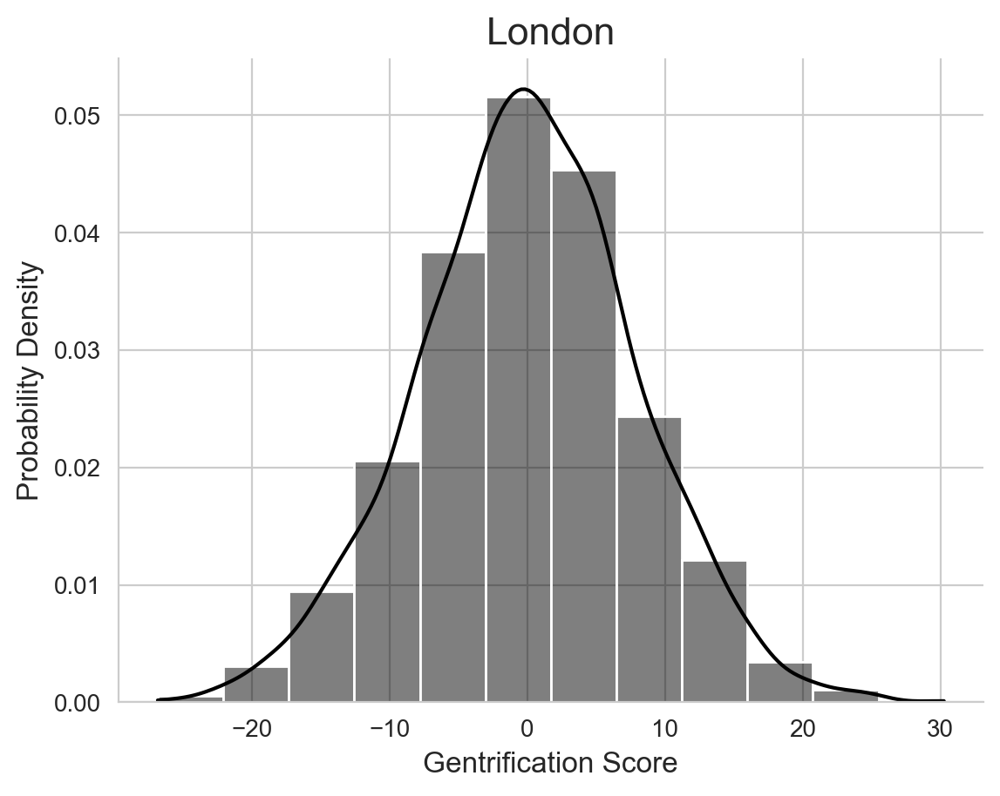

In [81]:
sns.set_style("whitegrid")

fig, ax = plt.subplots()

sns.histplot(
    merged["gentrification_score"],
    kde=True,
    ax=ax,
    color="black",
    bins=12,
    stat="density",
)

ax.set_title("London", fontsize=16)
ax.set_xlabel("Gentrification Score", fontsize=12)
ax.set_ylabel("Probability Density", fontsize=12)

sns.despine()

plt.show()
fig.savefig(
    "../outputs/gentrification_distribution.png",
    format="png",
    dpi=500,
    transparent=True,
)
mpl.rc_file_defaults()

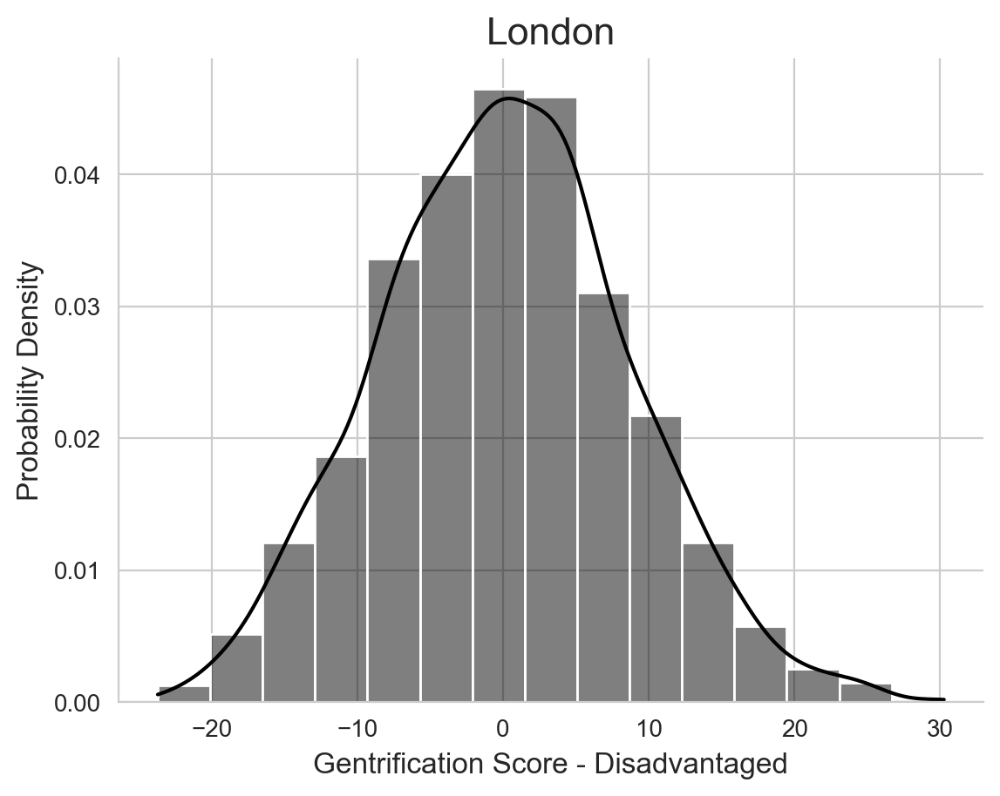

In [82]:
sns.set_style("whitegrid")

fig, ax = plt.subplots()

disadvantaged = merged[merged["disadvantaged"] == True]["gentrification_score"]
sns.histplot(disadvantaged, kde=True, ax=ax, color="black", bins=15, stat="density")

ax.set_title("London", fontsize=16)
ax.set_xlabel("Gentrification Score - Disadvantaged", fontsize=12)
ax.set_ylabel("Probability Density", fontsize=12)

sns.despine()

plt.show()
fig.savefig(
    "../outputs/gentrification_disadvantaged_distribution.png",
    format="png",
    dpi=500,
    transparent=True,
)
mpl.rc_file_defaults()

### Map

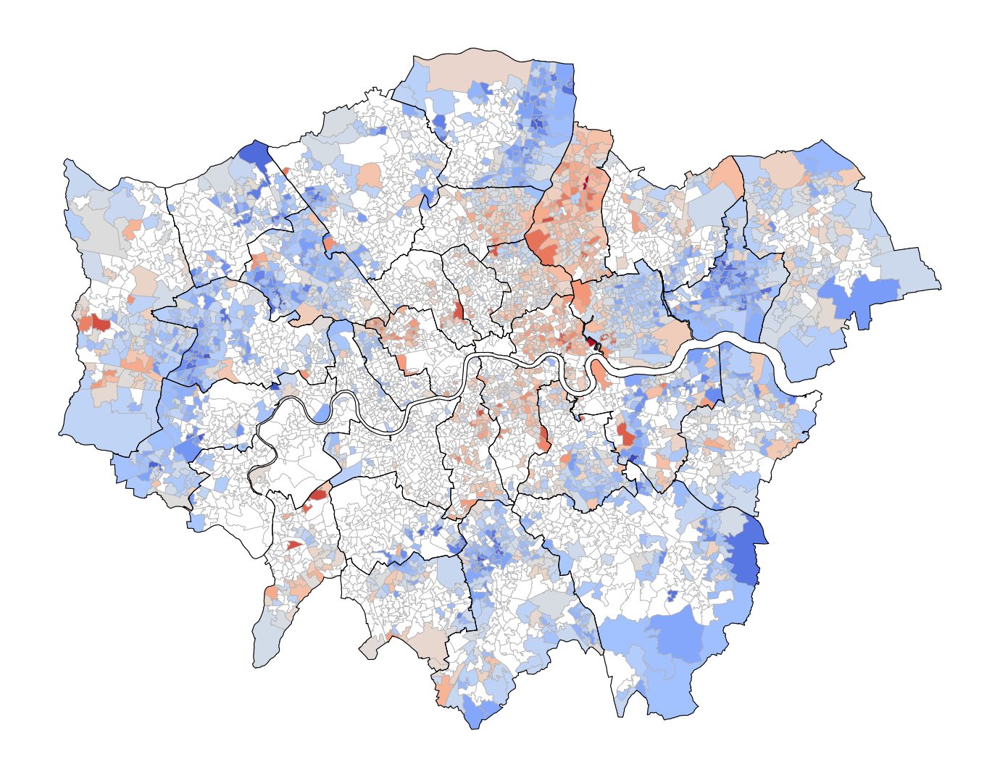

In [553]:
feature = "gentrification_score"
data = merged[merged["disadvantaged"] == True]
na = merged[merged["disadvantaged"] == False]

fig, ax = plt.subplots(1, figsize=(7, 7))
ax.axis("off")
boroughs.boundary.plot(color="black", linewidth=0.4, ax=ax, edgecolor="0.7")
na.plot(color="white", linewidth=0.3, ax=ax, edgecolor="0.7")
data.plot(column=feature, cmap="coolwarm", linewidth=0.3, ax=ax, edgecolor="0.7")
fig.tight_layout()
# fig.savefig('../outputs/gentrified.eps', format='eps', dpi=1000)
# fig.savefig('../outputs/gentrified.png', format='png', dpi=1000)
plt.show()

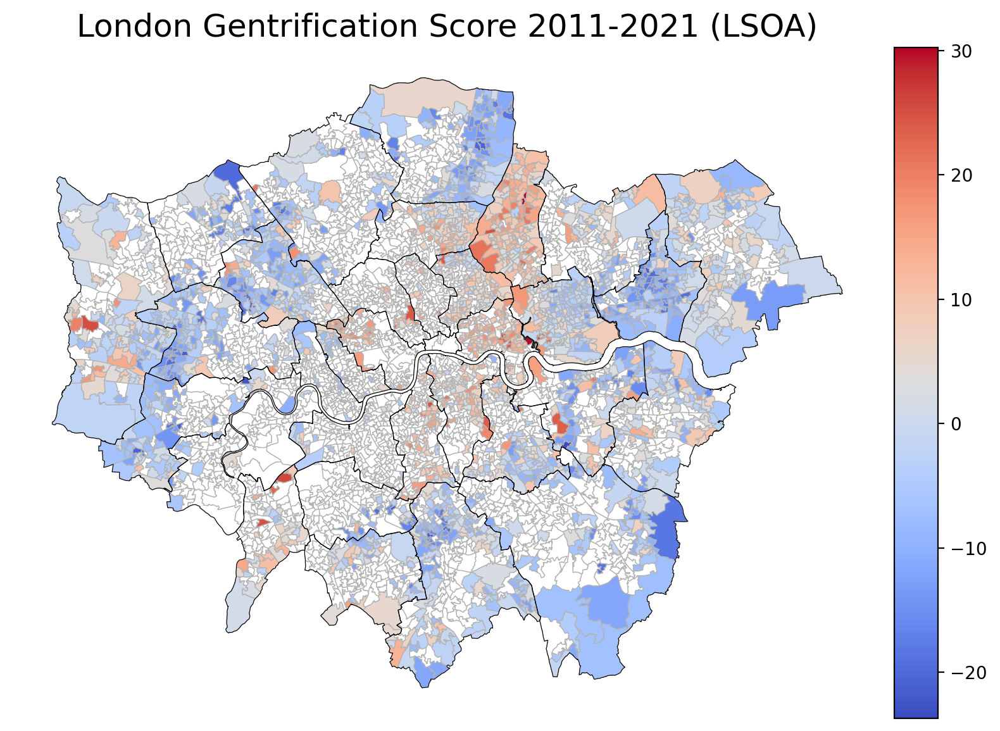

In [554]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.cm import ScalarMappable


feature = "gentrification_score"
data = merged[merged["disadvantaged"] == True]
na = merged[merged["disadvantaged"] == False]

fig, ax = plt.subplots(1, figsize=(8, 8))
ax.axis("off")
ax.set_title(
    "London Gentrification Score 2011-2021 (LSOA)",
    fontdict={"fontsize": "18", "fontweight": "3"},
)

# Plot boroughs
boroughs.boundary.plot(color="black", linewidth=0.4, ax=ax, edgecolor="0.7")

# Plot disadvantaged neighbourhoods in white
na.plot(color="white", linewidth=0.5, ax=ax, edgecolor="0.7")

# We need to create a colorbar, for that we need a "mappable" (ScalarMappable to be precise)
# The "ScalarMappable" utilizes data normalization before mapping to colors using cmap.
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

vmin, vmax = data[feature].min(), data[feature].max()
mappable = ScalarMappable(cmap="coolwarm", norm=plt.Normalize(vmin=vmin, vmax=vmax))
mappable._A = (
    []
)  # This is a workaround for not having an array of data for the mappable

cbar = fig.colorbar(mappable, cax=cax)
cbar.set_label("Gentrification Score")  # rotation=270, labelpad=15

data.plot(
    column=feature,
    cmap="coolwarm",
    linewidth=0.5,
    ax=ax,
    edgecolor="0.7",
    cax=cax,
    legend=True,
)

fig.tight_layout()
# plt.gcf().set_dpi(125)
plt.show()

# If you want to save the figure, you can uncomment the next two lines:
# fig.savefig('../outputs/gentrified.eps', format='eps', dpi=1000)
fig.savefig("../outputs/gentrified.png", format="png", dpi=500)

In [646]:
merged[merged["gentrification_score"] > 25]

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,t3_age_perc,t2_age_perc,t1_age_perc,neighborhood_index_t1,neighborhood_index_t3,disadvantaged,gentrification_score,log_gent_score,gent_score_clip,gent_score_minmax
2362,E01002414,Hillingdon 015A,E02000508,Hillingdon 015,E09000017,Hillingdon,E12000007,London,3314,1180,...,64.322647,12.140641,12.202689,28.117587,53.516029,True,25.398442,3.273305,25.398442,0.914782
2890,E01002956,Kingston upon Thames 002D,E02000599,Kingston upon Thames 002,E09000021,Kingston upon Thames,E12000007,London,1611,1193,...,59.627715,6.804550,2.130300,37.719680,63.733195,True,26.013515,3.296337,25.848764,0.925556
2926,E01002992,Kingston upon Thames 010D,E02000607,Kingston upon Thames 010,E09000021,Kingston upon Thames,E12000007,London,1752,1077,...,76.546019,18.634953,23.247156,42.456753,67.626680,True,25.169927,3.264611,25.169927,0.910780
3119,E01003187,Lambeth 007E,E02000624,Lambeth 007,E09000022,Lambeth,E12000007,London,1487,1486,...,94.477766,85.749741,54.126163,31.878631,57.233713,True,25.355081,3.271661,25.355081,0.914023
4142,E01004245,Tower Hamlets 018A,E02000881,Tower Hamlets 018,E09000030,Tower Hamlets,E12000007,London,1539,1539,...,82.192347,42.854188,32.037229,9.152060,39.022751,True,29.870690,3.429807,25.848764,0.993121
4270,E01004379,Waltham Forest 007A,E02000901,Waltham Forest 007,E09000031,Waltham Forest,E12000007,London,1430,1430,...,61.013444,41.799380,20.206825,41.298139,71.561531,True,30.263392,3.442448,25.848764,1.000000


In [555]:
merged[merged["gentrification_score"] > 30]

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,t1_house_perc,t3_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc,neighborhood_index_t1,neighborhood_index_t3,disadvantaged,gentrification_score
4270,E01004379,Waltham Forest 007A,E02000901,Waltham Forest 007,E09000031,Waltham Forest,E12000007,London,1430,1430,...,34.505585,54.932782,38.986556,61.013444,41.79938,20.206825,41.298139,71.561531,True,30.263392


In [556]:
#### curiosity

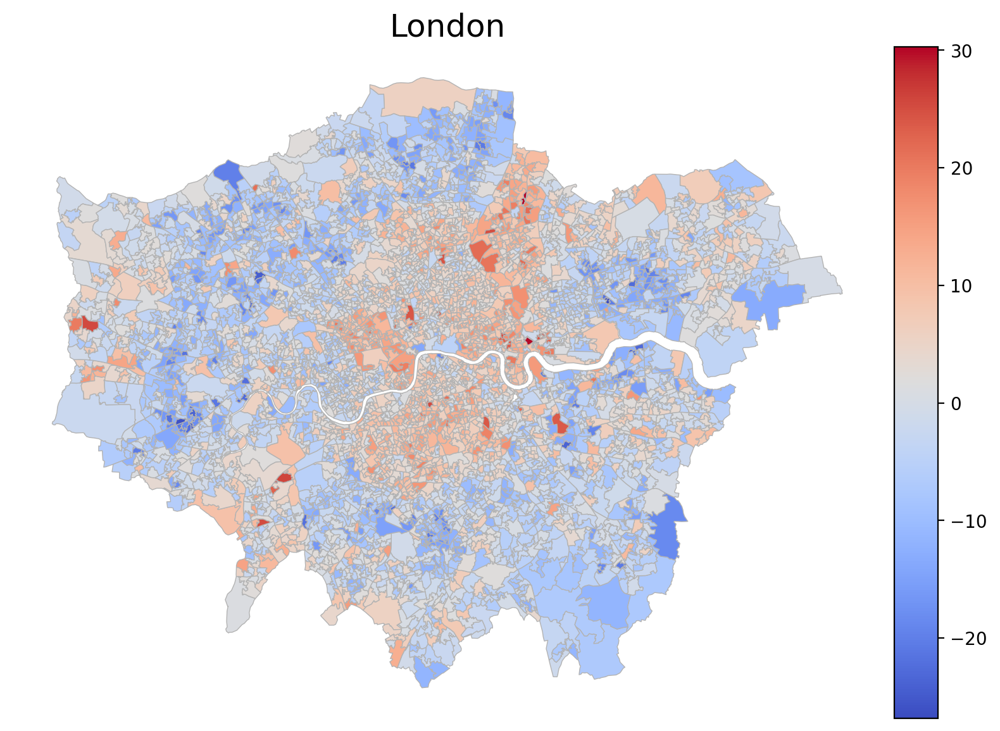

In [557]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

feature = "gentrification_score"
# data = merged[merged['disadvantaged'] == True]
# na = merged[merged['disadvantaged'] == False]

fig, ax = plt.subplots(1, figsize=(8, 8))
ax.axis("off")
ax.set_title("London", fontdict={"fontsize": "18", "fontweight": "3"})
# na.plot(color='white', linewidth=0.3, ax=ax, edgecolor='0.7')

# We need to create a colorbar, for that we need a "mappable" (ScalarMappable to be precise)
# The "ScalarMappable" utilizes data normalization before mapping to colors using cmap.
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

vmin, vmax = data[feature].min(), data[feature].max()
mappable = plt.cm.ScalarMappable(
    cmap="coolwarm", norm=plt.Normalize(vmin=vmin, vmax=vmax)
)
mappable._A = (
    []
)  # This is a workaround for not having an array of data for the mappable

cbar = fig.colorbar(mappable, cax=cax)
cbar.set_label("Gentrification Score", rotation=270, labelpad=15)

merged.plot(
    column=feature,
    cmap="coolwarm",
    linewidth=0.5,
    ax=ax,
    edgecolor="0.7",
    cax=cax,
    legend=True,
)

fig.tight_layout()
plt.show()

# If you want to save the figure, you can uncomment the next two lines:
# fig.savefig('../outputs/gentrified.eps', format='eps', dpi=1000)
# fig.savefig('../outputs/gentrified.png', format='png', dpi=1000)

In [558]:
mpl.rc_file_defaults()

### Scaling

In [629]:
merged.gentrification_score.isna().sum()

1

In [630]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# Apply log transformation
merged["log_gent_score"] = np.log1p(
    merged["gentrification_score"]
)  # Use log1p to handle zero values

# Clip values above the 95th percentile
percentile_95 = np.percentile(merged["gentrification_score"], 95)
merged["gent_score_clip"] = np.clip(merged["gentrification_score"], None, percentile_95)

scaler = MinMaxScaler()
merged["gent_score_minmax"] = scaler.fit_transform(
    pd.DataFrame(merged["gentrification_score"])
).flatten()

c:\Users\Javier Alfaro\Dropbox\Master\LSE\CDRC\venv\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [631]:
# Assume gentrification_scores is your array of scores
# Calculate Q1 (25th percentile) and Q3 (75th percentile)
gentrification_scores = merged["gentrification_score"].copy()
mean_value = np.nanmean(gentrification_scores)
gentrification_scores_filled = np.where(
    np.isnan(gentrification_scores), mean_value, gentrification_scores
)

cut_percentile = 80
Q1 = np.percentile(gentrification_scores_filled, 100 - cut_percentile)
Q3 = np.percentile(gentrification_scores_filled, cut_percentile)
IQR = Q3 - Q1

# Define the outlier bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Clip the data to these bounds
gentrification_scores_clipped = np.clip(
    gentrification_scores_filled, lower_bound, upper_bound
)
merged["gent_score_clip"] = gentrification_scores_clipped

In [632]:
Q1, Q3

(-6.551840868648864, 6.408401109171986)

In [633]:
newham_borough = boroughs[boroughs["NAME"] == "Newham"].geometry.centroid
newham_centroids = newham_borough.to_crs(4326)
newham_centroid = newham_centroids.y.mean(), newham_centroids.x.mean()
newham_centroid

(51.52834280120427, 0.036385630121357974)

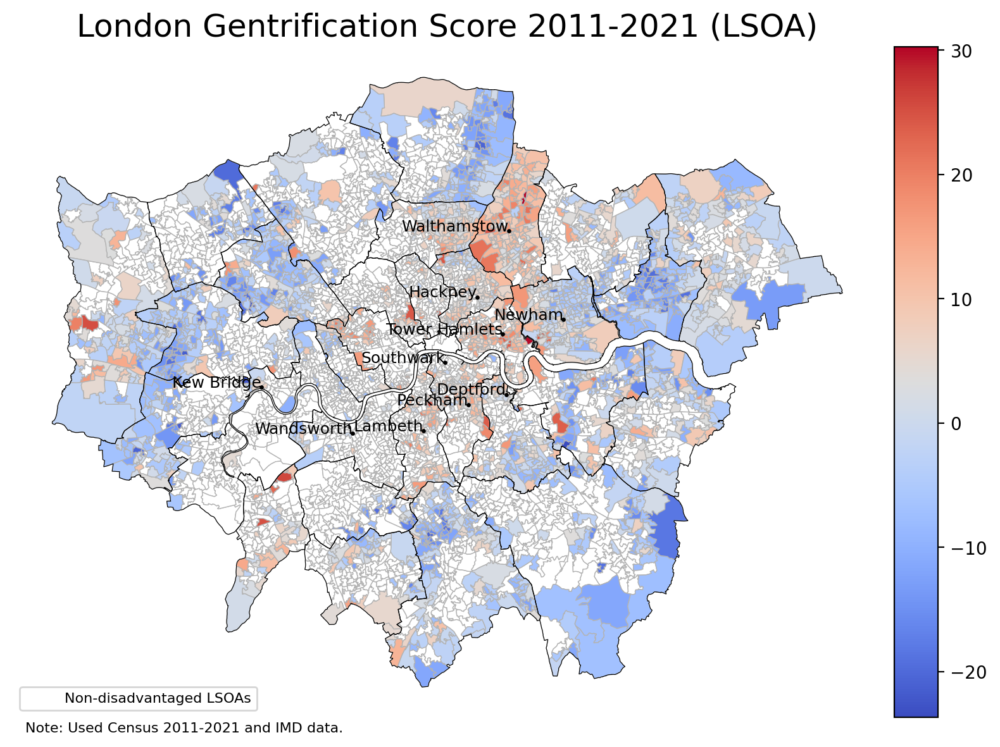

In [637]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.cm import ScalarMappable
from shapely.geometry import Point
import matplotlib.patches as mpatches


fig, ax = plt.subplots(1, figsize=(8, 8))
ax.axis("off")
ax.set_title(
    "London Gentrification Score 2011-2020 (LSOA)",
    fontdict={"fontsize": "18", "fontweight": "3"},
)

feature = "gentrification_score"
# feature = "gent_score_clip"

data = merged[merged["disadvantaged"] == True]
na = merged[merged["disadvantaged"] == False]

# Plot disadvantaged neighbourhoods in white
na.plot(color="white", linewidth=0.5, ax=ax, edgecolor="0.7")

boroughs.boundary.plot(color="black", linewidth=0.4, ax=ax, edgecolor="0.7")

# We need to create a colorbar, for that we need a "mappable" (ScalarMappable to be precise)
# The "ScalarMappable" utilizes data normalization before mapping to colors using cmap.
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

vmin, vmax = data[feature].min(), data[feature].max()
mappable = ScalarMappable(cmap="coolwarm", norm=plt.Normalize(vmin=vmin, vmax=vmax))
mappable._A = (
    []
)  # This is a workaround for not having an array of data for the mappable

cbar = fig.colorbar(mappable, cax=cax)
cbar.set_label("Gentrification Score")  # rotation=270, labelpad=15

data.plot(
    column=feature,
    cmap="coolwarm",
    linewidth=0.5,
    ax=ax,
    edgecolor="0.7",
    cax=cax,
    legend=True,
)

areas = {
    "Peckham": (51.4734, -0.0672),
    # 'Brixton': (51.4613, -0.1156),
    "Hackney": (51.5450, -0.0550),
    # 'Dalston': (51.5485, -0.0755),
    "Deptford": (51.4797, -0.0266),
    "Walthamstow": (51.5882, -0.0195),
    "Tower Hamlets": (51.5200, -0.0290),
    "Wandsworth": (51.4564, -0.1910),
    "Lambeth": (51.4570, -0.1162),
    "Southwark": (51.5020, -0.0910),
    # 'Ealing': (51.5133, -0.3080),
    # 'Hounslow': (51.4712, -0.3663),
    "Kew Bridge": (51.4886, -0.2872),
    "Newham": newham_centroid,
}

gdf_areas = gpd.GeoDataFrame(
    {"Area": list(areas.keys())},
    geometry=[Point(lon, lat) for lat, lon in areas.values()],
    crs="EPSG:4326",
)
gdf_areas = gdf_areas.to_crs(merged.crs)
gdf_areas.plot(ax=ax, color="black", markersize=2)
for x, y, label in zip(gdf_areas.geometry.x, gdf_areas.geometry.y, gdf_areas["Area"]):
    ax.text(x, y, label, fontsize=9, ha="right", color="black")

# Add legend for non-disadvantaged areas
white_patch = mpatches.Patch(color="white", label="Non-disadvantaged LSOAs")
ax.legend(handles=[white_patch], loc="lower left", fontsize=8)

fig.tight_layout()
# note = f"Note: Gentrification scores are clipped to {100-cut_percentile}th and {cut_percentile}th percentiles due to outliers. Used Census 2011 data."
note = f"Note: Used Census 2011-2020 and IMD data."
plt.annotate(
    note,
    xy=(-20, -0.025),
    xycoords="axes fraction",
    ha="left",
    va="bottom",
    fontsize=8,
    color="black",
)
# plt.figtext(0, 0.15, note, ha="left", fontsize=8, bbox={"facecolor": "white", "alpha": 0.5, "pad": 5})
plt.show()

# If you want to save the figure, you can uncomment the next two lines:
# fig.savefig('../outputs/gentrified.eps', format='eps', dpi=1000)
fig.savefig("../outputs/gentrified.png", format="png", dpi=500, transparent=True)

In [635]:
merged.to_file("../outputs/gent_merged.gpkg", driver="GPKG")

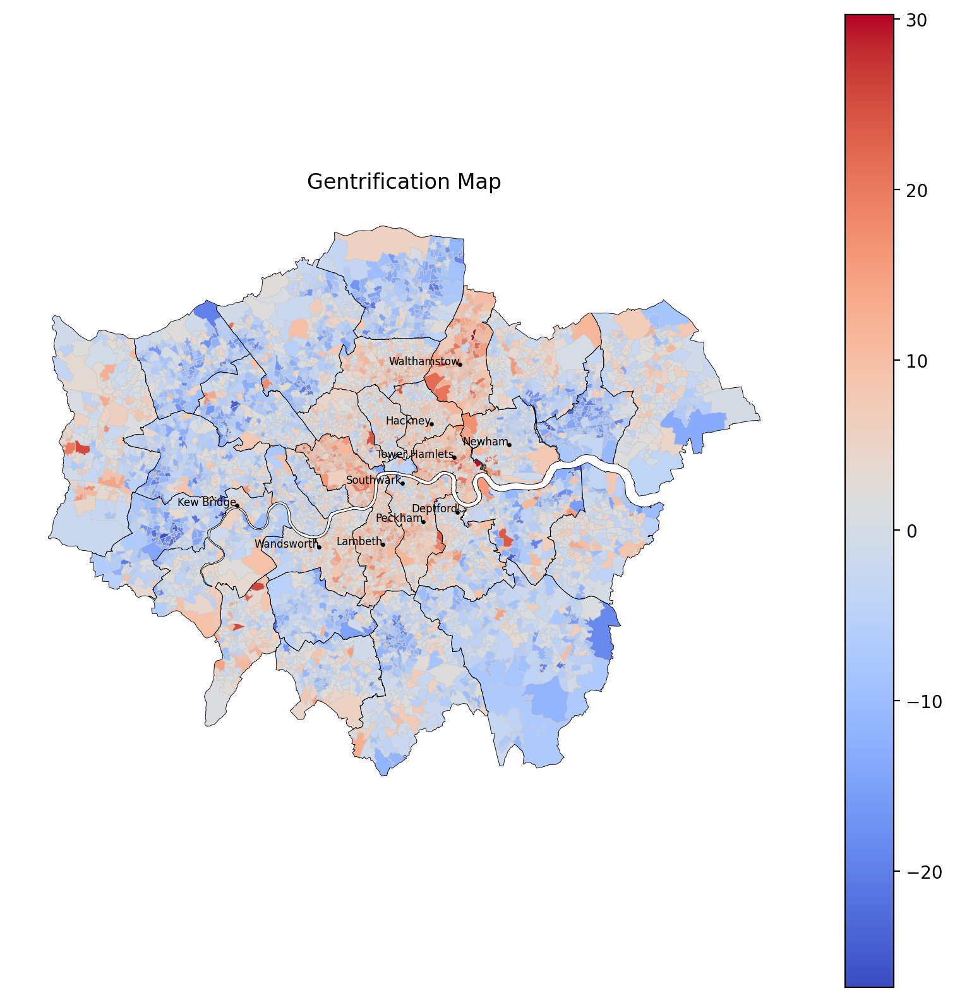

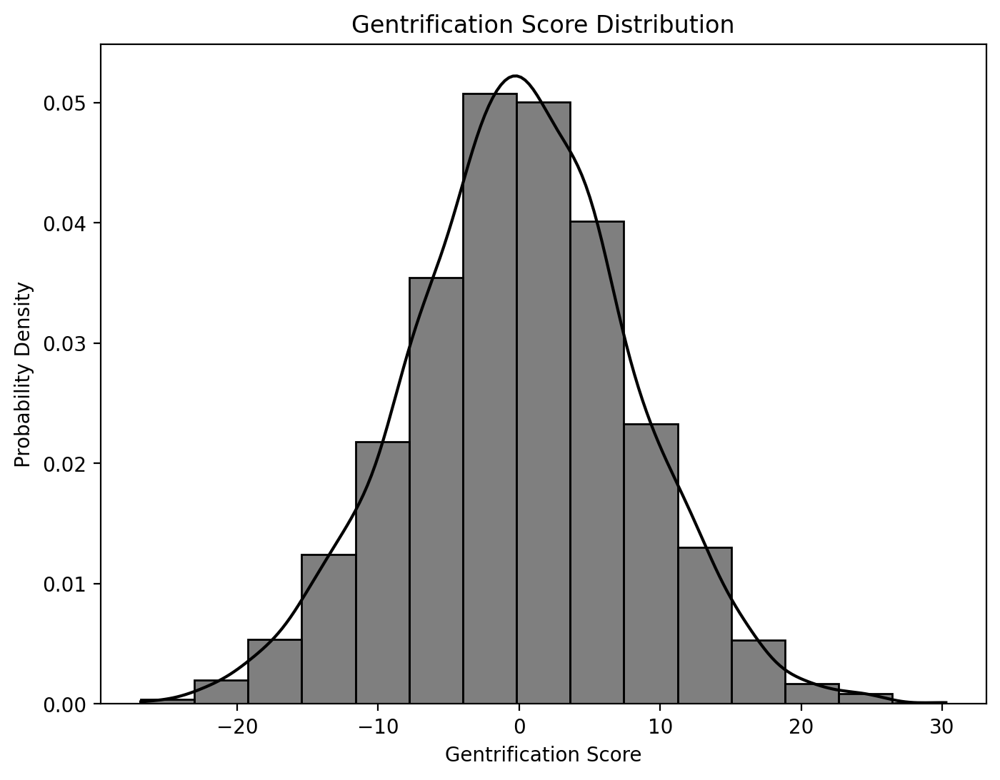

In [643]:
# Plot the gentrification map
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.axis("off")
feature = "gentrification_score"
# feature = "gent_score_clip"
boroughs.boundary.plot(color="black", linewidth=0.3, ax=ax, edgecolor="0.7")
merged.plot(
    column=feature, cmap="coolwarm", linewidth=0.3, ax=ax, edgecolor="0.8", legend=True
)
gdf_areas.plot(ax=ax, color="black", markersize=2)
for x, y, label in zip(gdf_areas.geometry.x, gdf_areas.geometry.y, gdf_areas["Area"]):
    ax.text(x, y, label, fontsize=6, ha="right", color="black")

plt.title("Gentrification Map")
plt.show()

# Plot the histogram
plt.figure(figsize=(8, 6))
sns.histplot(merged[feature], color="black", kde=True, bins=15, stat="density")
plt.title("Gentrification Score Distribution")
plt.xlabel("Gentrification Score")
plt.ylabel("Probability Density")
plt.show()

# Algorithmic Weights

In [567]:
# def calculate_neighborhood_index(df, weights):
#     """
#     Calculates the neighborhood index for two time periods (t1 and t2) using specified weights
#     for age, education, housing, and income percentiles.

#     Parameters:
#     - df (DataFrame): DataFrame containing the socioeconomic data.
#     - weights (tuple): Weights for age, education, housing, and income in the form (w_age, w_edu, w_house, w_income).

#     Returns:
#     - DataFrame: Updated DataFrame with new 'neighborhood_index_t1' and 'neighborhood_index_t2' columns.
#     """
#     w_age, w_edu, w_house, w_income = weights
#     # print("Weights used:", weights)

#     # Calculate the neighborhood index for t1
#     df["neighborhood_index_t1"] = (
#         w_age * df["t1_age_perc"]
#         + w_edu * df["t1_edu_perc"]
#         + w_house * df["t1_house_perc"]
#         + w_income * df["t1_income_perc"]
#     )

#     # Calculate the neighborhood index for t2
#     df["neighborhood_index_t2"] = (
#         w_age * df["t2_age_perc"]
#         + w_edu * df["t2_edu_perc"]
#         + w_house * df["t2_house_perc"]
#         + w_income * df["t2_income_perc"]
#     )

#     return df

In [568]:
def plot_gentrification_scores(
    merged,
    feature,
    output_path,
    filter_column=None,
    filter_value=None,
    boundary_gdf=None,
    dpi=300,
):
    """
    Plots a map showing gentrification scores across London.

    Parameters:
    - merged (GeoDataFrame): Merged GeoDataFrame with gentrification scores.
    - feature (str): Column name of the gentrification scores to plot.
    - filter_column (str): Optional. Column to filter on (e.g., 'disadvantaged').
    - filter_value (bool): Optional. Value to filter on (e.g., True or False).
    - boundary_gdf (GeoDataFrame): Optional. GeoDataFrame containing boundary data to overlay.

    Returns:
    - None
    """
    # Optionally filter the data
    if filter_column and filter_value is not None:
        data = merged[merged[filter_column] == filter_value].copy()
        na = merged[merged[filter_column] != filter_value]
    else:
        data = merged.copy()

    # Create the figure and axis
    fig, ax = plt.subplots(1, figsize=(7, 7))
    ax.axis("off")
    ax.set_title(
        "London Gentrification Score 2011-2021",
        fontdict={"fontsize": "18", "fontweight": "3"},
    )

    # Optionally plot non-filtered areas as a different color
    if filter_column and filter_value is not None:
        na.plot(color="white", linewidth=0.3, ax=ax, edgecolor="0.7")

    # Plot boundary data if provided
    if boundary_gdf is not None:
        boundary_gdf.boundary.plot(color="black", linewidth=0.3, ax=ax, edgecolor="0.7")

    # Prepare the colorbar
    palette = "coolwarm"
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="3%", pad=0.1)
    vmin, vmax = data[feature].min(), data[feature].max()
    mappable = plt.cm.ScalarMappable(
        cmap=palette, norm=plt.Normalize(vmin=vmin, vmax=vmax)
    )
    mappable._A = []  # Workaround for missing data array in mappable
    cbar = fig.colorbar(mappable, cax=cax)
    cbar.set_label("Gentrification Score", rotation=270, labelpad=15)

    # Plot the main data
    data.plot(
        column=feature,
        cmap=palette,
        linewidth=0.25,
        ax=ax,
        edgecolor="0.7",
        cax=cax,
        legend=True,
    )

    # Tight layout and set high dpi for clearer output
    fig.tight_layout()
    # plt.gcf().set_dpi(150)
    plt.show()

    fig.savefig(output_path, format="png", dpi=dpi, transparent=True)
    plt.close()

In [569]:
# weights = (0.25, 0.25, 0.25, 0.25)
# test = calculate_neighborhood_index(test, weights)
# threshold = test["neighborhood_index_t1"].quantile(0.5)
# test["disadvantaged"] = test["neighborhood_index_t1"] <= threshold
# test["gentrification_score"] = (
#     test["neighborhood_index_t2"] - test["neighborhood_index_t1"]
# )
# merged = pd.merge(gdf, test, left_on=bdry_key, right_on="lsoa_codes", how="left")
# output_path = "../outputs/gentrified.png"
# plot_gentrification_scores(
#     merged,
#     "gentrification_score",
#     output_path,
#     "disadvantaged",
#     True,
#     boundary_gdf=boroughs,
# )

In [570]:
import itertools
import numpy as np


def generate_weight_combinations(min_weight=0.1, step=0.05, total=1.0):
    steps = int((total - 4 * min_weight) / step) + 1
    for combination in itertools.product(range(steps + 1), repeat=4):
        weights = np.array(combination) * step + min_weight
        if np.isclose(weights.sum(), total):
            yield tuple(weights)

In [571]:
import pandas as pd
import os

bdry_key = "LSOA11CD"


def main_pipeline(data, gdf, output_dir="../outputs/nowcasting"):
    os.makedirs(output_dir, exist_ok=True)  # Ensure output directory exists

    for idx, weights in enumerate(generate_weight_combinations()):
        # Step A: Calculate indices and gentrification scores
        test = calculate_neighborhood_index(data.copy(), weights)
        threshold = test["neighborhood_index_t1"].quantile(0.5)
        test["disadvantaged"] = test["neighborhood_index_t1"] <= threshold
        test["gentrification_score"] = (
            test["neighborhood_index_t2"] - test["neighborhood_index_t1"]
        )

        # Step B: Merge with geographic data and plot
        merged = pd.merge(
            gdf, test, left_on=bdry_key, right_on="lsoa_codes", how="left"
        )
        output_path = f"{output_dir}/gentrification_map_{idx}.png"
        plot_gentrification_scores(
            merged,
            "gentrification_score",
            output_path,
            filter_column="disadvantaged",
            filter_value=True,
            boundary_gdf=boroughs,
        )

        print(f"Map saved to {output_path} with weights {weights}")


# main_pipeline(test, gdf)

In [572]:
# import pickle

# w_dict = {}
# for idx, weights in enumerate(generate_weight_combinations()):
#     w_dict[idx] = weights

# with open("../outputs/weights-nowcast.pickle", "wb") as handle:
#     pickle.dump(w_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open("../outputs/weights-nowcast.pickle", "rb") as handle:
#     test_dict = pickle.load(handle)

# print(w_dict == test_dict)

In [573]:
# w_dict.get(21)  # age, edu, house, income

In [574]:
# weights = w_dict.get(21)
# test = calculate_neighborhood_index(test, weights)
# threshold = test["neighborhood_index_t1"].quantile(0.5)
# test["disadvantaged"] = test["neighborhood_index_t1"] <= threshold
# test["gentrification_score"] = (
#     test["neighborhood_index_t2"] - test["neighborhood_index_t1"]
# )
# merged = pd.merge(gdf, test, left_on=bdry_key, right_on="lsoa_codes", how="left")
# output_path = "../outputs/gentrified-new-weights.png"
# plot_gentrification_scores(
#     merged,
#     "gentrification_score",
#     output_path,
#     "disadvantaged",
#     True,
#     boundary_gdf=boroughs,
# )

# Wards

In [3]:
file_path = "../data/ESRI/London_Ward.shp"
wards = gpd.read_file(file_path, crs="EPSG:27700")
wards

,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry
0,Chessington South,E05000405,755.173,0.0,E09000021,Kingston upon Thames,50840,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Tolworth and Hook Rise,E05000414,259.464,0.0,E09000021,Kingston upon Thames,117160,"POLYGON ((517829.600 165447.100, 517837.100 16..."
2,Berrylands,E05000401,145.390,0.0,E09000021,Kingston upon Thames,50449,"POLYGON ((518107.500 167303.400, 518114.300 16..."
3,Alexandra,E05000400,268.506,0.0,E09000021,Kingston upon Thames,50456,"POLYGON ((520480.000 166909.800, 520490.700 16..."
4,Beverley,E05000402,187.821,0.0,E09000021,Kingston upon Thames,117161,"POLYGON ((522071.000 168144.900, 522063.900 16..."
...,...,...,...,...,...,...,...,...
644,Aldgate,E05000002,11.227,0.0,E09000001,City of London,51182,"POLYGON ((533326.100 181359.400, 533336.900 18..."
645,Broad Street,E05000008,8.188,0.0,E09000001,City of London,50669,"POLYGON ((532703.800 181263.500, 532707.800 18..."
646,Coleman Street,E05000012,15.404,0.0,E09000001,City of London,122520,"POLYGON ((532880.500 181723.400, 532884.200 18..."
647,Portsoken,E05000021,6.209,0.0,E09000001,City of London,122516,"POLYGON ((533814.300 180968.900, 533757.200 18..."


In [4]:
file_path = "../data/lsoa01_ward11_lookup.csv"
# file_path = "../data/lsoa11_ward15_lookup.csv"
# file_path = "../data/lsoa11_ward16_lookup.csv"
# file_path = "../data/lsoa11_ward17_lookup.csv"
# file_path = "../data/lsoa11_ward18_lookup.csv"
# file_path = "../data/lsoa11_ward19_lookup.csv"
# file_path = "../data/lsoa11_ward20_lookup.csv"
# file_path = "../data/lsoa21_ward23_lookup.csv"
# file_path = "../data/london_lsoa2osward.csv"
ward_mapping = pd.read_csv(file_path)
ward_mapping.columns = map(str.lower, ward_mapping.columns)
ward_mapping

,lsoa01cd,lsoa01nm,wd11cd,wd11cdo,wd11nm,fid
0,E01000301,Barnet 020C,E05000061,00ACGR,West Finchley,1
1,E01000302,Barnet 019C,E05000061,00ACGR,West Finchley,2
2,E01000303,Barnet 020D,E05000061,00ACGR,West Finchley,3
3,E01000304,Barnet 020E,E05000061,00ACGR,West Finchley,4
4,E01000305,Barnet 036B,E05000062,00ACGS,West Hendon,5
...,...,...,...,...,...,...
34373,W01001624,Newport 001B,W05000837,00PRNB,Caerleon,34374
34374,W01001733,Cardiff 019B,W05000859,00PTNM,Cyncoed,34375
34375,W01001625,Newport 001C,W05000837,00PRNB,Caerleon,34376
34376,W01001734,Cardiff 019C,W05000859,00PTNM,Cyncoed,34377


In [5]:
missing_wards = wards[~wards["GSS_CODE"].isin(ward_mapping["wd11cd"])]
missing_wards

,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry
625,Farringdon Without,E05000018,34.348,2.271,E09000001,City of London,122517,"POLYGON ((531944.700 181863.100, 531945.700 18..."
626,Farringdon Within,E05000017,23.152,0.000,E09000001,City of London,122518,"POLYGON ((532083.400 181950.000, 532086.200 18..."
628,Langbourn,E05000019,5.633,0.000,E09000001,City of London,122513,"POLYGON ((532974.600 180959.200, 532925.100 18..."
629,Tower,E05000023,19.734,0.679,E09000001,City of London,122515,"POLYGON ((533838.000 180857.800, 533839.500 18..."
630,Bishopsgate,E05000005,25.271,0.000,E09000001,City of London,50670,"POLYGON ((532946.100 181894.900, 533078.900 18..."
631,Queenhithe,E05000022,7.954,3.570,E09000001,City of London,51176,"POLYGON ((532248.800 180647.100, 532228.800 18..."
632,Vintry,E05000024,9.211,2.396,E09000001,City of London,122510,"POLYGON ((532464.700 180566.600, 532452.600 18..."
633,Cordwainer,E05000013,6.072,0.000,E09000001,City of London,122507,"POLYGON ((532361.400 180995.500, 532328.500 18..."
634,Bread Street,E05000006,9.712,0.000,E09000001,City of London,122504,"POLYGON ((532361.400 180995.500, 532344.500 18..."
635,Cheap,E05000011,8.908,0.000,E09000001,City of London,122503,"POLYGON ((532038.500 181405.900, 532085.500 18..."


In [6]:
city = data[data["LAD11NM"] == "City of London"]
city

NameError: name 'data' is not defined

In [7]:
for idx, lsoa in enumerate(city["LSOA11CD"]):
    print(idx, lsoa, lsoa in ward_mapping.lsoa01cd.tolist())

NameError: name 'city' is not defined

In [8]:
missing_wards_df = pd.DataFrame(
    {"lsoa01cd": [np.nan] * len(missing_wards), "wd11cd": missing_wards["GSS_CODE"]}
)

lsoa_to_ward_map = pd.concat([ward_mapping, missing_wards_df], ignore_index=True)
lsoa_to_ward_map

,lsoa01cd,lsoa01nm,wd11cd,wd11cdo,wd11nm,fid
0,E01000301,Barnet 020C,E05000061,00ACGR,West Finchley,1.0
1,E01000302,Barnet 019C,E05000061,00ACGR,West Finchley,2.0
2,E01000303,Barnet 020D,E05000061,00ACGR,West Finchley,3.0
3,E01000304,Barnet 020E,E05000061,00ACGR,West Finchley,4.0
4,E01000305,Barnet 036B,E05000062,00ACGS,West Hendon,5.0
...,...,...,...,...,...,...
34394,NaN,NaN,E05000020,NaN,NaN,NaN
34395,NaN,NaN,E05000002,NaN,NaN,NaN
34396,NaN,NaN,E05000008,NaN,NaN,NaN
34397,NaN,NaN,E05000012,NaN,NaN,NaN


In [9]:
print(len(wards[wards["BOROUGH"] == "City of London"]))
wards[wards["BOROUGH"] == "City of London"]

25


,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry
624,Castle Baynard,E05000010,36.065,6.700,E09000001,City of London,122502,"POLYGON ((531954.600 180687.000, 531936.600 18..."
625,Farringdon Without,E05000018,34.348,2.271,E09000001,City of London,122517,"POLYGON ((531944.700 181863.100, 531945.700 18..."
626,Farringdon Within,E05000017,23.152,0.000,E09000001,City of London,122518,"POLYGON ((532083.400 181950.000, 532086.200 18..."
627,Cripplegate,E05000015,14.545,0.000,E09000001,City of London,122522,"POLYGON ((532447.600 181959.000, 532448.700 18..."
628,Langbourn,E05000019,5.633,0.000,E09000001,City of London,122513,"POLYGON ((532974.600 180959.200, 532925.100 18..."
629,Tower,E05000023,19.734,0.679,E09000001,City of London,122515,"POLYGON ((533838.000 180857.800, 533839.500 18..."
630,Bishopsgate,E05000005,25.271,0.000,E09000001,City of London,50670,"POLYGON ((532946.100 181894.900, 533078.900 18..."
631,Queenhithe,E05000022,7.954,3.570,E09000001,City of London,51176,"POLYGON ((532248.800 180647.100, 532228.800 18..."
632,Vintry,E05000024,9.211,2.396,E09000001,City of London,122510,"POLYGON ((532464.700 180566.600, 532452.600 18..."
633,Cordwainer,E05000013,6.072,0.000,E09000001,City of London,122507,"POLYGON ((532361.400 180995.500, 532328.500 18..."


<Axes: >

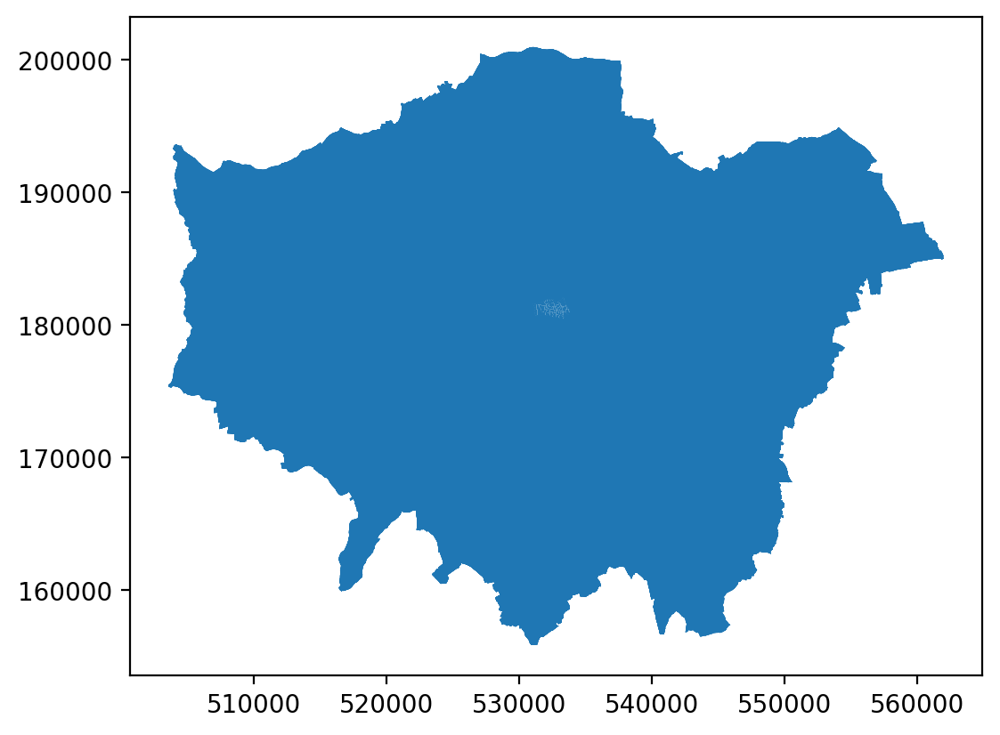

In [10]:
tmp = wards.merge(ward_mapping, left_on="GSS_CODE", right_on="wd11cd", how="left")
tmp[tmp.lsoa01cd.isna()].to_csv("../outputs/missing-wards.csv", index=False)
tmp.plot()

In [11]:
data = merged.copy()
tmp = data.merge(ward_mapping, left_on="LSOA11CD", right_on="lsoa01cd", how="left")
tmp = wards.merge(tmp, left_on="GSS_CODE", right_on="wd11cd", how="left").rename(
    columns={"geometry_x": "geometry"}
)
tmp = gpd.GeoDataFrame(tmp)
avg_gs = tmp["gentrification_score"].mean()
tmp["gentrification_score"] = tmp["gentrification_score"].fillna(avg_gs)
tmp.plot("gentrification_score")

NameError: name 'merged' is not defined

In [ ]:
# tmp[tmp['LSOA11CD'].isna()]

In [ ]:
len([x for x in wards["GSS_CODE"] if x in list(ward_mapping.wd11cd.unique())])

628

In [ ]:
# data[data['disadvantaged'] == True].describe() # mean = 3.08

In [ ]:
# w_dict.get(21)

## Map

In [23]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.cm import ScalarMappable
from shapely.geometry import Point
import matplotlib.patches as mpatches

In [25]:
file_path = "../data/ESRI/LSOA_2011_London_gen_MHW.shp"
gdf = gpd.read_file(file_path, crs="EPSG:27700")
bdry_key = "LSOA11CD"

file_path = "../data/ESRI/London_Borough_Excluding_MHW.shp"
boroughs = gpd.read_file(file_path, crs="EPSG:27700")

In [26]:
# merged.to_file("../outputs/gent_merged.gpkg", driver="GPKG")
test = gpd.read_file("../outputs/gent_merged.gpkg")

In [33]:
weights = (0.25, 0.25, 0.25, 0.25)
# weights = w_dict.get(21)
test = calculate_neighborhood_index(test, weights)
first_window = "neighborhood_index_t1"
second_window = "neighborhood_index_t3"
threshold = test[first_window].quantile(0.5)
test["disadvantaged"] = test[first_window] <= threshold
test["gentrification_score"] = test[second_window] - test[first_window]
# merged = pd.merge(gdf, test, left_on=bdry_key, right_on="lsoa_codes", how="left")
merged = test.copy()

Weights used: (0.25, 0.25, 0.25, 0.25)


In [34]:
newham_centroids = wards[wards["BOROUGH"] == "Newham"].geometry.centroid
newham_centroids = newham_centroids.to_crs(4326)
newham_centroid = newham_centroids.y.mean(), newham_centroids.x.mean()
newham_centroid

(51.532289597696334, 0.035594901835853565)

In [35]:
areas = {
    "Peckham": (51.4734, -0.0672),
    # 'Brixton': (51.4613, -0.1156),
    "Hackney": (51.5450, -0.0550),
    # 'Dalston': (51.5485, -0.0755),
    "Deptford": (51.4797, -0.0266),
    "Walthamstow": (51.5882, -0.0195),
    "Tower Hamlets": (51.5200, -0.0290),
    "Wandsworth": (51.4564, -0.1910),
    "Lambeth": (51.4570, -0.1162),
    "Southwark": (51.5020, -0.0910),
    # 'Ealing': (51.5133, -0.3080),
    # 'Hounslow': (51.4712, -0.3663),
    "Kew Bridge": (51.4886, -0.2872),
    "Newham": newham_centroid,
}

gdf_areas = gpd.GeoDataFrame(
    {"Area": list(areas.keys())},
    geometry=[Point(lon, lat) for lat, lon in areas.values()],
    crs="EPSG:4326",
)
gdf_areas = gdf_areas.to_crs(merged.crs)

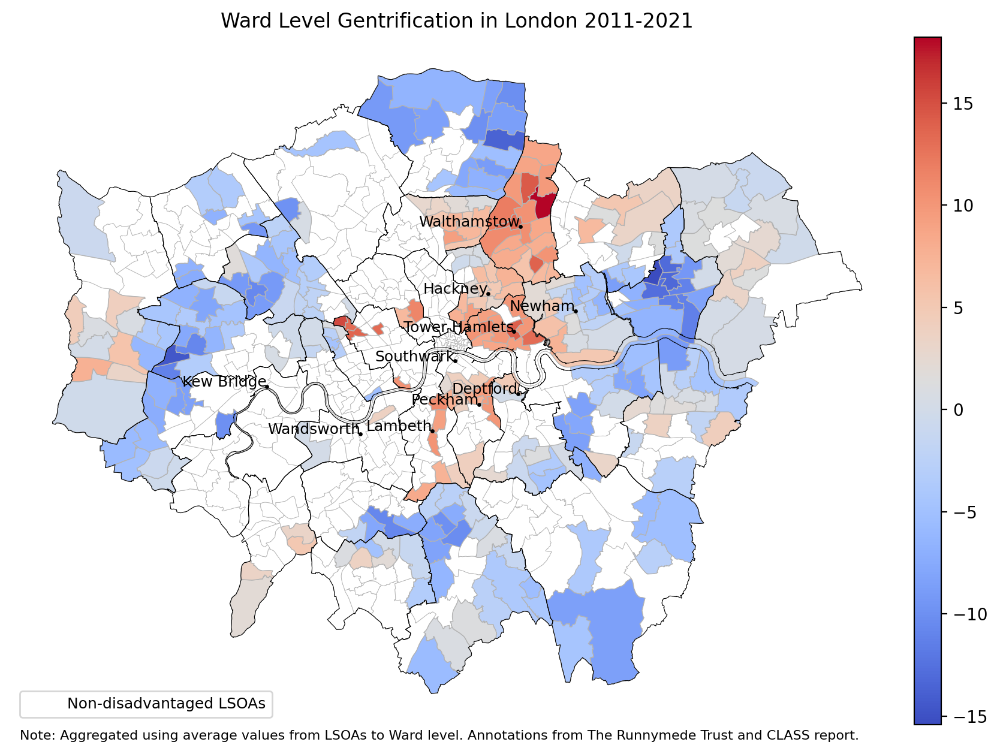

In [36]:
def aggregate_lsoa_to_ward(lsoa_data, ward_gdf, lsoa_to_ward_map):
    """
    Aggregates LSOA data to the ward level, ensuring only numeric columns are aggregated.

    Parameters:
    lsoa_data (DataFrame): DataFrame with LSOA level data.
    ward_gdf (GeoDataFrame): GeoDataFrame with ward boundaries.
    lsoa_to_ward_map (DataFrame): DataFrame mapping LSOA codes to ward codes.

    Returns:
    GeoDataFrame: Aggregated ward-level data.
    """
    lsoa_map_var = "lsoa01cd"
    ward_var = "wd11cd"
    # Merge LSOA data with ward mapping
    merged_data = pd.merge(
        lsoa_data,
        lsoa_to_ward_map,
        left_on="lsoa_codes",
        right_on=lsoa_map_var,
        how="left",
    )

    # Ensure data types are correct for aggregation
    numeric_cols = merged_data.select_dtypes(include=[np.number, bool]).columns.tolist()
    agg_functions = {
        col: "mean" for col in numeric_cols
    }  # Only aggregate numeric columns

    # Group by ward code and calculate mean of each numeric column
    aggregated_data = merged_data.groupby(ward_var).agg(agg_functions).reset_index()

    # Merge aggregated data back with ward GeoDataFrame to maintain geographic info
    ward_level_data = ward_gdf.merge(
        aggregated_data, left_on="GSS_CODE", right_on=ward_var, how="left"
    )

    return ward_level_data


def plot_ward_data(
    ward_gdf, column, boundary_gdf=None, is_disadvantaged=False, save=False
):
    """
    Plots ward-level data.

    Parameters:
    ward_gdf (GeoDataFrame): GeoDataFrame containing ward-level data.
    column (str): The column to visualize.
    title (str): Title of the plot.
    """
    fig, ax = plt.subplots(1, figsize=(10, 10))
    if boundary_gdf is not None:
        boundary_gdf.boundary.plot(color="black", linewidth=0.4, ax=ax, edgecolor="0.7")

    data = ward_gdf.copy()
    if is_disadvantaged:
        first_window = "neighborhood_index_t1"
        second_window = "neighborhood_index_t3"
        threshold = test[first_window].quantile(0.5)
        ward_gdf["disadvantaged"] = ward_gdf[first_window] <= threshold
        data = ward_gdf[ward_gdf["disadvantaged"] == True]
        na = ward_gdf[ward_gdf["disadvantaged"] != True]
        na.plot(color="white", linewidth=0.3, ax=ax, edgecolor="0.7")

    # Prepare the colorbar
    palette = "coolwarm"
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="3%", pad=0.1)
    vmin, vmax = data[column].min(), data[column].max()
    mappable = ScalarMappable(cmap=palette, norm=plt.Normalize(vmin=vmin, vmax=vmax))
    mappable._A = []  # Workaround for missing data array in mappable
    cbar = fig.colorbar(mappable, cax=cax)
    cbar.set_label("Gentrification Score", rotation=270, labelpad=15)

    data.plot(
        column=column,
        cmap="coolwarm",
        linewidth=0.5,
        edgecolor="0.7",
        legend=True,
        ax=ax,
        cax=cax,
    )
    ax.set_title("Ward Level Gentrification in London 2011-2021")
    ax.set_axis_off()

    gdf_areas.plot(ax=ax, color="black", markersize=2)
    for x, y, label in zip(
        gdf_areas.geometry.x, gdf_areas.geometry.y, gdf_areas["Area"]
    ):
        ax.text(x, y, label, fontsize=9, ha="right", color="black")

    # Add legend for non-disadvantaged areas
    white_patch = mpatches.Patch(color="white", label="Non-disadvantaged LSOAs")
    ax.legend(handles=[white_patch], loc="lower left", fontsize=9)

    note = f"Note: Aggregated using average values from LSOAs to Ward level. Annotations from The Runnymede Trust and CLASS report."
    plt.annotate(
        note,
        xy=(-33.5, -0.025),
        xycoords="axes fraction",
        ha="left",
        va="bottom",
        fontsize=8,
        color="black",
    )

    plt.show()

    if save:
        fig.savefig(
            f"../outputs/ward_level_{column}.png",
            dpi=500,
            format="png",
            transparent=True,
        )

    plt.close()


data = merged.copy()
aggregated_ward_data = aggregate_lsoa_to_ward(data, wards, ward_mapping)
plot_ward_data(
    aggregated_ward_data,
    "gentrification_score",
    boroughs,
    is_disadvantaged=True,
    save=False,
)

In [44]:
del aggregated_ward_data["fid"]

In [45]:
aggregated_ward_data.to_file("../outputs/ward_gent_merged.gpkg", driver="GPKG")

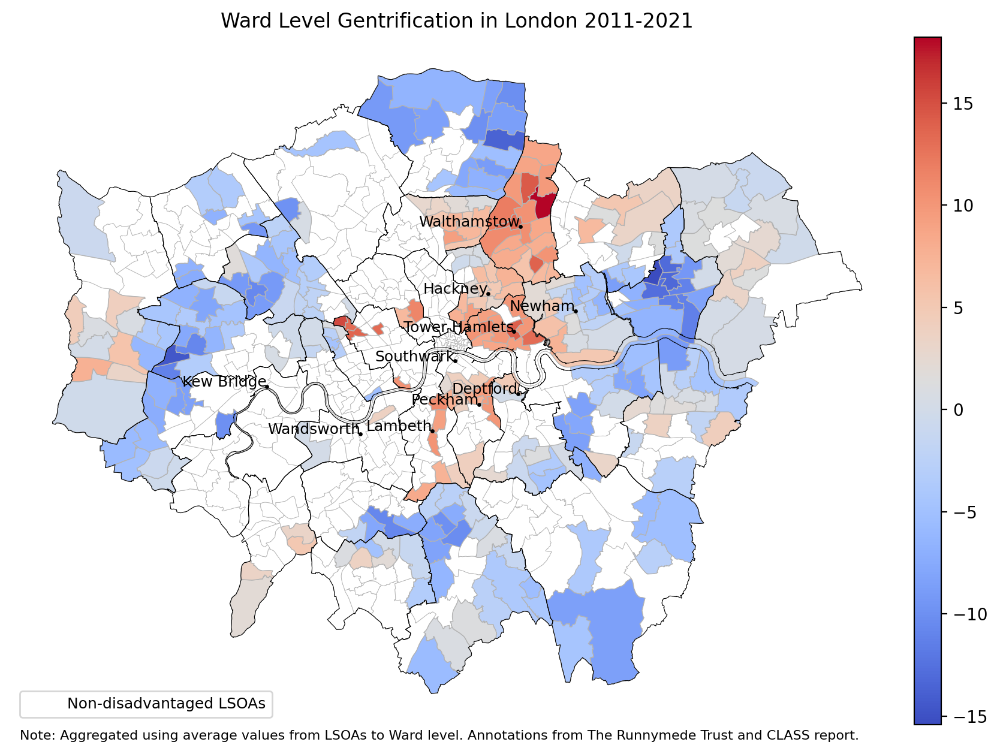

In [ ]:
plot_ward_data(
    aggregated_ward_data,
    "gentrification_score",
    boroughs,
    is_disadvantaged=True,
    save=False,
)

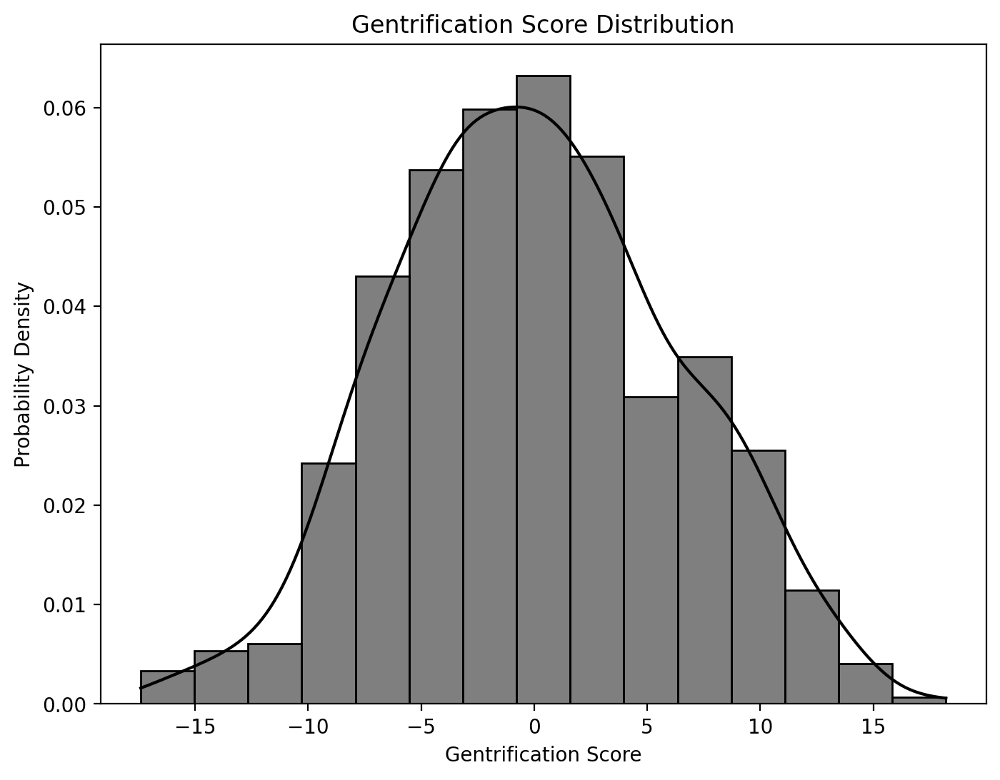

In [ ]:
plt.figure(figsize=(8, 6))
sns.histplot(
    aggregated_ward_data["gentrification_score"],
    color="black",
    kde=True,
    bins=15,
    stat="density",
)
plt.title("Gentrification Score Distribution")
plt.xlabel("Gentrification Score")
plt.ylabel("Probability Density")
plt.show()

KeyError: 'gent_score_clip'

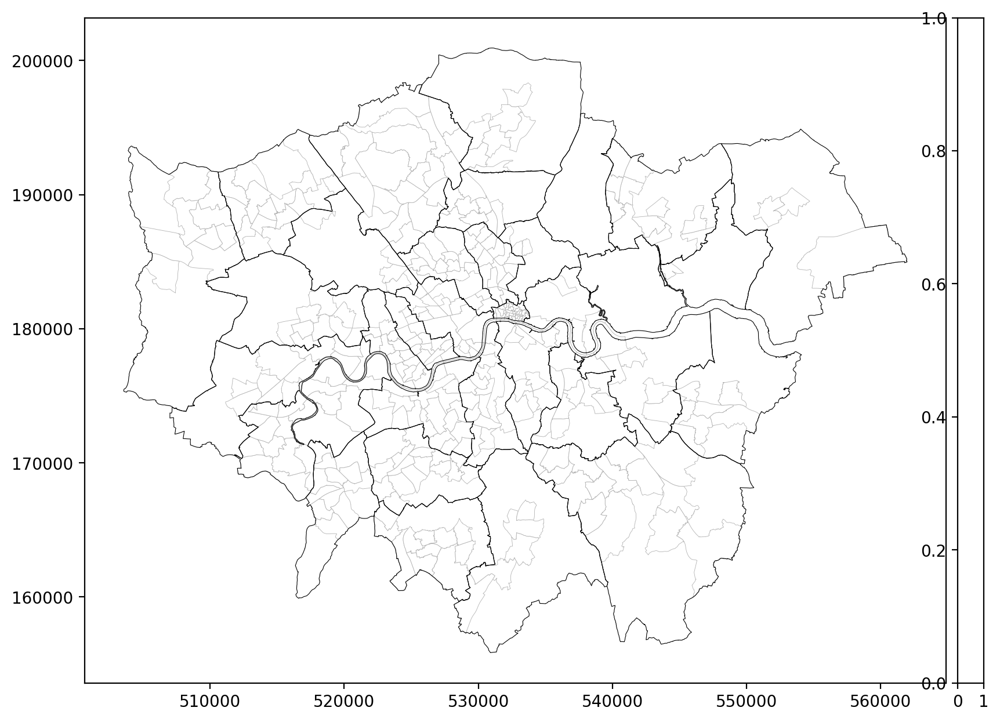

In [ ]:
plot_ward_data(
    aggregated_ward_data, "gent_score_clip", boroughs, is_disadvantaged=True, save=True
)

In [ ]:
aggregated_ward_data.columns

Index(['NAME', 'GSS_CODE', 'HECTARES', 'NONLD_AREA', 'LB_GSS_CD', 'BOROUGH',
       'POLY_ID', 'geometry', 'wd11cd', 'USUALRES', 'HHOLDRES', 'COMESTRES',
       'POPDEN', 'HHOLDS', 'AVHHOLDSZ', 't3_income_perc', 't2_income_perc',
       't1_income_perc', 't3_house_perc', 't2_house_perc', 't1_house_perc',
       't3_edu_perc', 't2_edu_perc', 't1_edu_perc', 't3_age_perc',
       't2_age_perc', 't1_age_perc', 'neighborhood_index_t1',
       'neighborhood_index_t3', 'disadvantaged', 'gentrification_score',
       'fid'],
      dtype='object')

In [ ]:
data.columns

Index(['LSOA11CD', 'LSOA11NM', 'MSOA11CD', 'MSOA11NM', 'LAD11CD', 'LAD11NM',
       'RGN11CD', 'RGN11NM', 'USUALRES', 'HHOLDRES', 'COMESTRES', 'POPDEN',
       'HHOLDS', 'AVHHOLDSZ', 'geometry', 'lsoa_codes', 't3_income_perc',
       't2_income_perc', 't1_income_perc', 't3_house_perc', 't2_house_perc',
       't1_house_perc', 't3_edu_perc', 't2_edu_perc', 't1_edu_perc',
       't3_age_perc', 't2_age_perc', 't1_age_perc', 'neighborhood_index_t1',
       'neighborhood_index_t3', 'disadvantaged', 'gentrification_score'],
      dtype='object')

In [ ]:
first_window = "neighborhood_index_t1"
second_window = "neighborhood_index_t3"

threshold = aggregated_ward_data[first_window].quantile(0.5)
aggregated_ward_data["disadvantaged"] = aggregated_ward_data[first_window] <= threshold
aggregated_ward_data["gentrification_score"] = (
    aggregated_ward_data[second_window] - aggregated_ward_data[first_window]
)

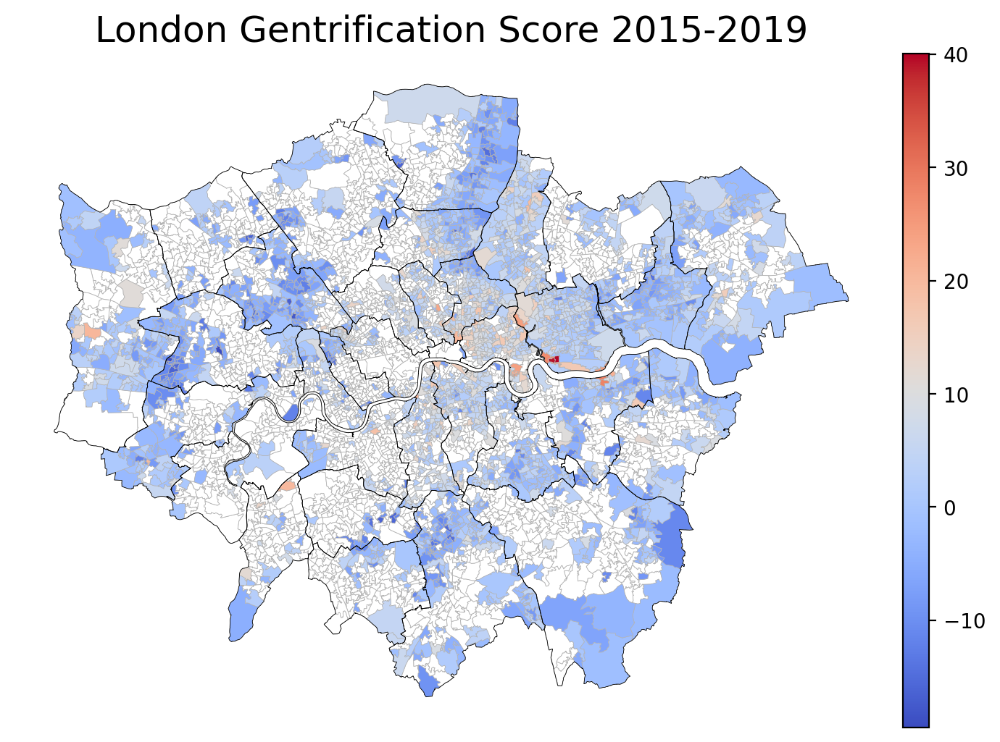

In [ ]:
threshold = test[first_window].quantile(0.5)
test["disadvantaged"] = test[first_window] <= threshold
test["gentrification_score"] = test[second_window] - test[first_window]
merged = pd.merge(gdf, test, left_on=bdry_key, right_on="lsoa_codes", how="left")
output_path = "../outputs/ward_level_gentrification.png"
plot_gentrification_scores(
    merged,
    "gentrification_score",
    output_path,
    "disadvantaged",
    True,
    boundary_gdf=boroughs,
)

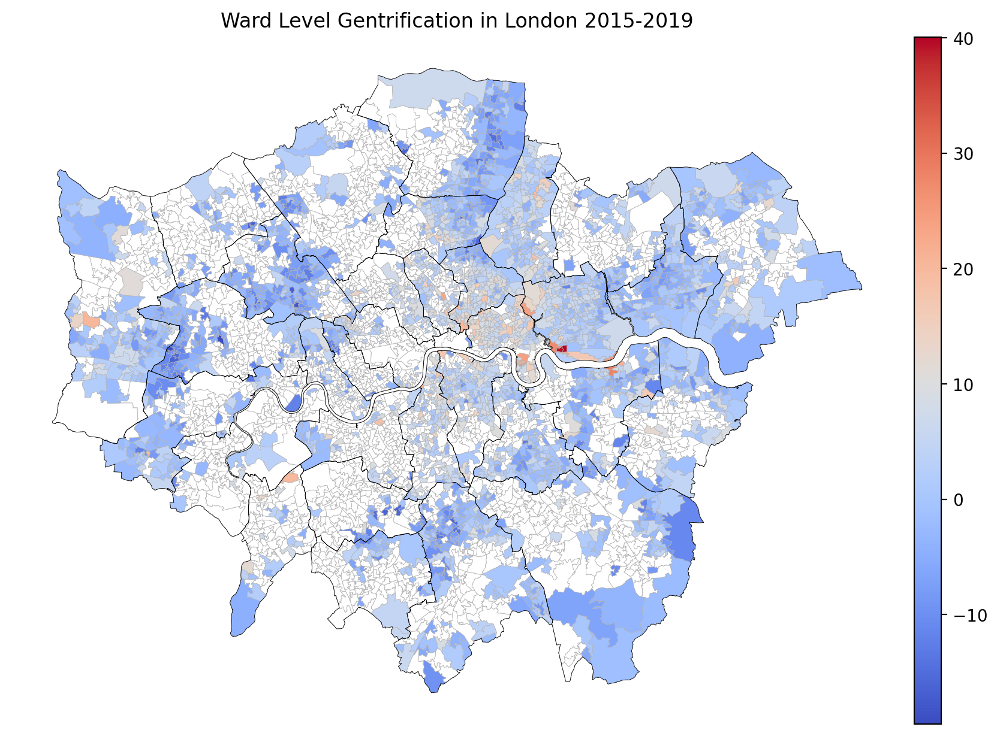

In [ ]:
data = merged.copy()
column = "gentrification_score"

fig, ax = plt.subplots(1, figsize=(10, 10))
boroughs.boundary.plot(color="black", linewidth=0.3, ax=ax, edgecolor="0.7")

is_disadvantaged = True
if is_disadvantaged:
    first_window = "neighborhood_index_t1"
    second_window = "neighborhood_index_t3"
    threshold = test[first_window].quantile(0.5)
    data["disadvantaged"] = data[first_window] <= threshold

    data = merged[merged["disadvantaged"] == True]
    na = merged[merged["disadvantaged"] != True]

    na.plot(color="white", linewidth=0.3, ax=ax, edgecolor="0.7")

# Prepare the colorbar
palette = "coolwarm"
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3%", pad=0.1)
vmin, vmax = data[column].min(), data[column].max()
mappable = ScalarMappable(cmap=palette, norm=plt.Normalize(vmin=vmin, vmax=vmax))
mappable._A = []  # Workaround for missing data array in mappable
cbar = fig.colorbar(mappable, cax=cax)
cbar.set_label("Gentrification Score", rotation=270, labelpad=15)

# avg_gs = ward_gdf['gentrification_score'].mean()
# ward_gdf['gentrification_score'] = ward_gdf['gentrification_score'].fillna(avg_gs)
data.plot(
    column=column,
    cmap="coolwarm",
    linewidth=0.25,
    edgecolor="0.7",
    legend=True,
    ax=ax,
    cax=cax,
)
ax.set_title("Ward Level Gentrification in London 2015-2019")
ax.set_axis_off()
plt.show()

In [ ]:
aggregated_ward_data.columns

Index(['NAME', 'GSS_CODE', 'HECTARES', 'NONLD_AREA', 'LB_GSS_CD', 'BOROUGH',
       'POLY_ID', 'geometry', 'wd11cd', 'USUALRES', 'HHOLDRES', 'COMESTRES',
       'POPDEN', 'HHOLDS', 'AVHHOLDSZ', 't3_income_perc', 't2_income_perc',
       't3_house_perc', 't2_house_perc', 't3_edu_perc', 't2_edu_perc',
       't3_age_perc', 't2_age_perc', 'neighborhood_index_t2',
       'neighborhood_index_t3', 'disadvantaged', 'gentrification_score',
       'fid'],
      dtype='object')

In [ ]:
len(aggregated_ward_data[aggregated_ward_data["disadvantaged"] == True])

314

<Axes: >

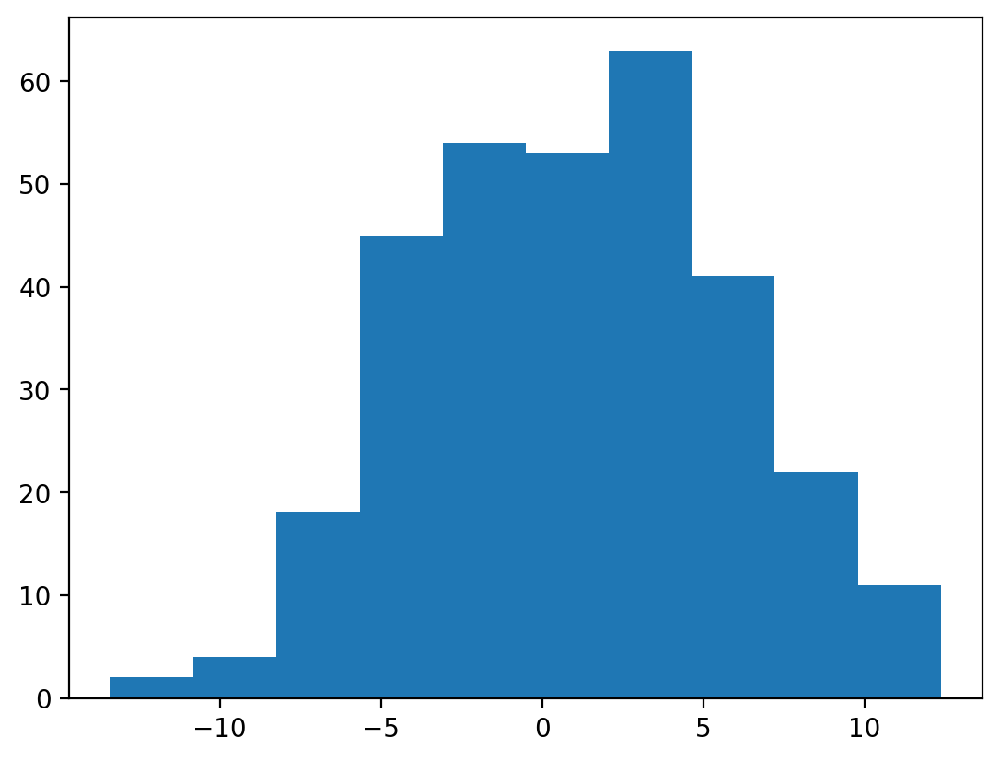

In [ ]:
aggregated_ward_data[aggregated_ward_data["disadvantaged"] == True][
    "gentrification_score"
].hist(grid=False)

In [ ]:
aggregated_ward_data[aggregated_ward_data["disadvantaged"] == True].describe()

,HECTARES,NONLD_AREA,POLY_ID,USUALRES,HHOLDRES,COMESTRES,POPDEN,HHOLDS,AVHHOLDSZ,t3_income_perc,...,t3_edu_perc,t2_edu_perc,t1_edu_perc,t3_age_perc,t2_age_perc,t1_age_perc,neighborhood_index_t1,neighborhood_index_t3,gentrification_score,fid
count,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,...,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000,313.000000
mean,252.366604,4.464157,84790.255591,1742.300968,1725.537481,16.763487,104.985364,673.051928,2.608143,29.500252,...,48.315798,45.622047,45.233795,73.087270,77.740746,77.843356,40.561680,41.595507,1.033828,2396.259562
std,287.641428,19.934800,33154.680661,170.879088,169.879419,32.248478,50.138003,86.041636,0.318199,11.820981,...,13.639922,13.285938,13.449204,17.194748,15.835345,16.025460,5.749152,7.754411,4.783301,1340.116785
min,6.209000,0.000000,50480.000000,985.000000,985.000000,0.000000,1.733333,462.000000,1.983333,1.638047,...,13.654157,10.848905,9.333130,12.021475,16.665652,22.797162,20.635563,19.539718,-13.392374,26.333333
25%,113.124000,0.000000,50930.000000,1634.857143,1617.285714,2.571429,63.455556,617.222222,2.400000,21.044940,...,38.779914,36.312569,35.843484,61.277555,67.411349,68.482610,36.565749,37.003968,-2.514576,1307.800000
50%,181.956000,0.000000,116699.000000,1724.571429,1704.875000,7.166667,95.877778,662.375000,2.562500,27.998156,...,48.896805,46.090991,45.548112,73.597917,80.342596,81.423548,40.783224,41.727941,1.077765,2405.750000
75%,296.713000,0.000000,117107.000000,1845.875000,1833.333333,17.444444,144.775000,712.833333,2.750000,35.506811,...,58.880364,55.526123,55.277101,89.192851,91.247369,90.560300,45.416912,47.341790,4.542582,3499.166667
max,2903.960000,154.284000,122516.000000,2709.000000,2709.000000,311.571429,326.000000,948.000000,3.771429,74.587951,...,83.369870,79.651281,77.173163,98.594365,98.460906,98.167093,49.661489,58.904690,12.381970,4670.833333


In [ ]:
data

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,t3_house_perc,t2_house_perc,t3_edu_perc,t2_edu_perc,t3_age_perc,t2_age_perc,neighborhood_index_t2,neighborhood_index_t3,disadvantaged,gentrification_score
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,...,6.567410,17.150773,80.337352,67.747534,78.787602,37.997808,44.120692,55.512422,True,11.391731
3,E01000005,City of London 001E,E02000001,City of London 001,E09000001,City of London,E12000007,London,985,985,...,6.750091,12.120935,37.662891,53.038607,89.273536,45.174157,33.105742,38.010748,True,4.905005
4,E01000006,Barking and Dagenham 016A,E02000017,Barking and Dagenham 016,E09000002,Barking and Dagenham,E12000007,London,1703,1699,...,3.145171,6.689197,53.315674,54.213859,85.330654,90.129095,48.559098,46.121818,True,-2.437279
5,E01000007,Barking and Dagenham 015A,E02000016,Barking and Dagenham 015,E09000002,Barking and Dagenham,E12000007,London,1391,1391,...,0.834247,0.170503,62.525880,68.152478,92.672939,94.084155,43.141822,43.773977,True,0.632155
6,E01000008,Barking and Dagenham 015B,E02000016,Barking and Dagenham 015,E09000002,Barking and Dagenham,E12000007,London,1544,1544,...,2.986847,1.044331,32.179393,29.728413,85.167763,90.652783,33.193277,32.657791,True,-0.535486
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4828,E01033740,Greenwich 002F,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,1577,1577,...,11.167945,12.632444,80.376933,82.904031,66.861527,76.418828,49.913226,47.399829,True,-2.513397
4829,E01033741,Greenwich 002G,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2457,1681,...,9.472050,16.383510,49.853855,48.839971,96.772622,96.081476,47.998112,49.055383,True,1.057271
4831,E01033743,Greenwich 002H,E02000314,Greenwich 002,E09000011,Greenwich,E12000007,London,2038,2038,...,0.870783,3.644501,68.931921,76.531482,55.309950,76.178297,45.230483,40.597978,True,-4.632505
4832,E01033744,Greenwich 007G,E02000319,Greenwich 007,E09000011,Greenwich,E12000007,London,1845,1728,...,9.423335,18.185970,46.361588,33.522104,83.869200,87.355377,40.473907,40.825569,True,0.351662


In [ ]:
# # Check for unmatched ward codes
# lsoa_ward_codes = set(data['wd15cd'])
# ward_boundary_codes = set(wards['GSS_CODE'])

# unmatched_wards = lsoa_ward_codes - ward_boundary_codes
# print(f"Unmatched ward codes in LSOA data: {unmatched_wards}")

# missing_wards = ward_boundary_codes - lsoa_ward_codes
# print(f"Wards in boundary data without LSOA data: {missing_wards}")

# Overview

For each variable, age, education, housing and income, the variables of interest were computed/extracted:

2011

- Age: Quinary estimates, group 2 categories 25-29 + 30-34, divide by provided column "All Ages"
- Education: Select Level 4 qualifications and above and divide by provided All Categories
- Housing: Used the Barriers to Housing and Services score from IMD
- Income: Used the Income Deprivation Domain score from IMD 2020

2020 

- Age: Single Year of Age and Sex estimates, sum column values from 25 to 34, divide by provided column "All Ages"
- Education: Select Level 4 qualifications and above (2021) and create own "Total" column, divide by this one
- Housing: Used the Barriers to Housing and Services score from IMD
- Income: Used the Income Deprivation Domain score from IMD

For each variable,  subset of LSOA  Code + Variable of Interest (two columns). To prepare for main merge.

Create main dataset by merging these subsets. For each numeric column, calculate the percentile rank. Image attached. Is this correct?
Calculate Neighbourhood Index by summing over the scores over T1 (2010) and T2 (2020). Identify disadvantaged neighbourhoods as those in the bottom 50th percentile in the first time window (2010).

Finally, calculate the gentrification score by taking a simple different between T2 and T1.
Map these.

Some notes:
- Weird distribution of level 4 people for 2011, image attached is this ok? the percentage looks fine (attached)
- For the income variable, the paper states: Percent not deprived from low income, but it doesn't really say it comes from IMD. I used the score from it, did not really transform it into a percentage.
